# Table of Contents
* [Step 1: Import and Load Necessary Packages](#Step-1:-Import-and-Load-necessary-packages)
* [Step 2: Load and Explore the Data](#Step-2:-Load-and-Explore-the-Data)
* [Step 3: Data Wrangling on multiple tables](#Step-3:-Data-Wrangling-on-multiple-tables)
* [Step 4: Exploratory Data Analysis](#Step-4:-EDA)
* [Step 5: Train Test Split](#Step-5:-Train-Test-Split)
* [Step 6: Data Cleansing and Transformation](#Step-6:-Data-Cleansing-and-Transformation)
    * [Handling Missing Values](#Handling-Missing-Values)
    * [Naive Baseline Model](#Naive-Baseline-Model)
    * [Numerical Data Transformation](#Numerical-Data-Transformation)
    * [Binning](#Binning)
    * [Categorical Data Encoding](#Categorical-Data-Encoding)
    * [Outliers Removal/Capping](#Outliers-Removal-Capping)
    * [Feature Scaling](#Feature-Scaling)
* [Step 7: Machine Learning Modelling](#Step-7:-Machine-Learning-Modelling)
    * [Naive Baseline Model](#Naive-Baseline-Model)
    * [Linear Regression Model](#Linear-Regression-Model)
* [Report Section](#Report-Section)
* [References](#References)

## Step 1: Import and Load Necessary Packages

In [1]:
# import all the required packages

import pandas as pd
import numpy as np
import feature_engine

# to split the datasets
from sklearn.model_selection import train_test_split #(sklearn preprocess)
from sklearn.pipeline import Pipeline
import feature_engine.imputation as mdi
from sklearn import linear_model
from sklearn.metrics import mean_absolute_error
# from feature-engine
# for one hot encoding with feature-engine
from feature_engine.encoding import OneHotEncoder

# skleran
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Visual
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# with open-source packages
from sklearn.preprocessing import PowerTransformer
from feature_engine.transformation import YeoJohnsonTransformer

from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# Models
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

## Step 2: Load and Explore the Data

Now, let's define a function that will read all the selected csv files from Lahman Baseball Database into pandas dataframes.

In [2]:
# Load the data
people = pd.read_csv("./Datasets/CSV/player.csv")
batting = pd.read_csv("./Datasets/CSV/batting.csv")
pitching = pd.read_csv("./Datasets/CSV/pitching.csv")
fielding = pd.read_csv("./Datasets/CSV/fielding.csv")
awards_players = pd.read_csv("./Datasets/CSV/player_award.csv")

### Print Summaries of the DataFrames

This information is valuable for understanding the structure of the data, which could help in identifying potential issues like missing values or data type inconsistencies, which allows me to make informed decisions about further analysis.

In [3]:
people.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18846 entries, 0 to 18845
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   player_id      18846 non-null  object 
 1   birth_year     18703 non-null  float64
 2   birth_month    18531 non-null  float64
 3   birth_day      18382 non-null  float64
 4   birth_country  18773 non-null  object 
 5   birth_state    18220 non-null  object 
 6   birth_city     18647 non-null  object 
 7   death_year     9336 non-null   float64
 8   death_month    9335 non-null   float64
 9   death_day      9334 non-null   float64
 10  death_country  9329 non-null   object 
 11  death_state    9277 non-null   object 
 12  death_city     9325 non-null   object 
 13  name_first     18807 non-null  object 
 14  name_last      18846 non-null  object 
 15  name_given     18807 non-null  object 
 16  weight         17975 non-null  float64
 17  height         18041 non-null  float64
 18  bats  

In [4]:
batting.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101332 entries, 0 to 101331
Data columns (total 22 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  101332 non-null  object 
 1   year       101332 non-null  int64  
 2   stint      101332 non-null  int64  
 3   team_id    101332 non-null  object 
 4   league_id  100595 non-null  object 
 5   g          101332 non-null  int64  
 6   ab         96183 non-null   float64
 7   r          96183 non-null   float64
 8   h          96183 non-null   float64
 9   double     96183 non-null   float64
 10  triple     96183 non-null   float64
 11  hr         96183 non-null   float64
 12  rbi        95759 non-null   float64
 13  sb         94883 non-null   float64
 14  cs         72729 non-null   float64
 15  bb         96183 non-null   float64
 16  so         88345 non-null   float64
 17  ibb        59620 non-null   float64
 18  hbp        93373 non-null   float64
 19  sh         89845 non-nu

In [5]:
pitching.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44139 entries, 0 to 44138
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  44139 non-null  object 
 1   year       44139 non-null  int64  
 2   stint      44139 non-null  int64  
 3   team_id    44139 non-null  object 
 4   league_id  44008 non-null  object 
 5   w          44139 non-null  int64  
 6   l          44139 non-null  int64  
 7   g          44139 non-null  int64  
 8   gs         44139 non-null  int64  
 9   cg         44139 non-null  int64  
 10  sho        44139 non-null  int64  
 11  sv         44139 non-null  int64  
 12  ipouts     44138 non-null  float64
 13  h          44139 non-null  int64  
 14  er         44139 non-null  int64  
 15  hr         44139 non-null  int64  
 16  bb         44139 non-null  int64  
 17  so         44139 non-null  int64  
 18  baopp      42614 non-null  float64
 19  era        44049 non-null  float64
 20  ibb   

In [6]:
fielding.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170526 entries, 0 to 170525
Data columns (total 18 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  170526 non-null  object 
 1   year       170526 non-null  int64  
 2   stint      170526 non-null  int64  
 3   team_id    170526 non-null  object 
 4   league_id  169023 non-null  object 
 5   pos        170526 non-null  object 
 6   g          170526 non-null  int64  
 7   gs         75849 non-null   float64
 8   inn_outs   102313 non-null  float64
 9   po         156409 non-null  float64
 10  a          156408 non-null  float64
 11  e          156407 non-null  float64
 12  dp         156408 non-null  float64
 13  pb         11116 non-null   float64
 14  wp         4189 non-null    float64
 15  sb         6024 non-null    float64
 16  cs         6024 non-null    float64
 17  zr         4189 non-null    float64
dtypes: float64(11), int64(3), object(4)
memory usage: 23.4+ MB


In [7]:
awards_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6078 entries, 0 to 6077
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   player_id  6078 non-null   object
 1   award_id   6078 non-null   object
 2   year       6078 non-null   int64 
 3   league_id  6078 non-null   object
 4   tie        45 non-null     object
 5   notes      4648 non-null   object
dtypes: int64(1), object(5)
memory usage: 285.0+ KB


### Explore the size of the DataFrames

In [8]:
# Get the shape of the DataFrame
rows, cols = people.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 18846 rows and 24 columns


In [9]:
# Get the shape of the DataFrame
rows, cols = batting.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 101332 rows and 22 columns


In [10]:
# Get the shape of the DataFrame
rows, cols = pitching.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 44139 rows and 30 columns


In [11]:
# Get the shape of the DataFrame
rows, cols = fielding.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 170526 rows and 18 columns


In [12]:
# Get the shape of the DataFrame
rows, cols = awards_players.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 6078 rows and 6 columns


### Display and examine the contents in the DataFrames

In [13]:
pd.set_option('display.max_columns', None)
display(people.head())

,player_id,birth_year,birth_month,birth_day,birth_country,birth_state,birth_city,death_year,death_month,death_day,death_country,death_state,death_city,name_first,name_last,name_given,weight,height,bats,throws,debut,final_game,retro_id,bbref_id
0,aardsda01,1981.0,12.0,27.0,USA,CO,Denver,NaN,NaN,NaN,NaN,NaN,NaN,David,Aardsma,David Allan,220.0,75.0,R,R,2004-04-06,2015-08-23,aardd001,aardsda01
1,aaronha01,1934.0,2.0,5.0,USA,AL,Mobile,NaN,NaN,NaN,NaN,NaN,NaN,Hank,Aaron,Henry Louis,180.0,72.0,R,R,1954-04-13,1976-10-03,aaroh101,aaronha01
2,aaronto01,1939.0,8.0,5.0,USA,AL,Mobile,1984.0,8.0,16.0,USA,GA,Atlanta,Tommie,Aaron,Tommie Lee,190.0,75.0,R,R,1962-04-10,1971-09-26,aarot101,aaronto01
3,aasedo01,1954.0,9.0,8.0,USA,CA,Orange,NaN,NaN,NaN,NaN,NaN,NaN,Don,Aase,Donald William,190.0,75.0,R,R,1977-07-26,1990-10-03,aased001,aasedo01
4,abadan01,1972.0,8.0,25.0,USA,FL,Palm Beach,NaN,NaN,NaN,NaN,NaN,NaN,Andy,Abad,Fausto Andres,184.0,73.0,L,L,2001-09-10,2006-04-13,abada001,abadan01


In [14]:
pd.set_option('display.max_columns', None)
display(batting.head())

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,abercda01,1871,1,TRO,NaN,1,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,25,118.0,30.0,32.0,6.0,0.0,0.0,13.0,8.0,1.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN
2,allisar01,1871,1,CL1,NaN,29,137.0,28.0,40.0,4.0,5.0,0.0,19.0,3.0,1.0,2.0,5.0,NaN,NaN,NaN,NaN,NaN
3,allisdo01,1871,1,WS3,NaN,27,133.0,28.0,44.0,10.0,2.0,2.0,27.0,1.0,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN
4,ansonca01,1871,1,RC1,NaN,25,120.0,29.0,39.0,11.0,3.0,0.0,16.0,6.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN


In [15]:
pd.set_option('display.max_columns', None)
display(pitching.head())

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,bechtge01,1871,1,PH1,NaN,1,2,3,3,2,0,0,78.0,43,23,0,11,1,NaN,7.96,NaN,NaN,NaN,0,NaN,NaN,42,NaN,NaN,NaN
1,brainas01,1871,1,WS3,NaN,12,15,30,30,30,0,0,792.0,361,132,4,37,13,NaN,4.50,NaN,NaN,NaN,0,NaN,NaN,292,NaN,NaN,NaN
2,fergubo01,1871,1,NY2,NaN,0,0,1,0,0,0,0,3.0,8,3,0,0,0,NaN,27.00,NaN,NaN,NaN,0,NaN,NaN,9,NaN,NaN,NaN
3,fishech01,1871,1,RC1,NaN,4,16,24,24,22,1,0,639.0,295,103,3,31,15,NaN,4.35,NaN,NaN,NaN,0,NaN,NaN,257,NaN,NaN,NaN
4,fleetfr01,1871,1,NY2,NaN,0,1,1,1,1,0,0,27.0,20,10,0,3,0,NaN,10.00,NaN,NaN,NaN,0,NaN,NaN,21,NaN,NaN,NaN


In [16]:
pd.set_option('display.max_columns', None)
display(fielding.head())

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,abercda01,1871,1,TRO,NaN,SS,1,NaN,NaN,1.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,2B,22,NaN,NaN,67.0,72.0,42.0,5.0,NaN,NaN,NaN,NaN,NaN
2,addybo01,1871,1,RC1,NaN,SS,3,NaN,NaN,8.0,14.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
3,allisar01,1871,1,CL1,NaN,2B,2,NaN,NaN,1.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,allisar01,1871,1,CL1,NaN,OF,29,NaN,NaN,51.0,3.0,7.0,1.0,NaN,NaN,NaN,NaN,NaN


In [17]:
pd.set_option('display.max_columns', None)
display(awards_players.head())

,player_id,award_id,year,league_id,tie,notes
0,bondto01,Pitching Triple Crown,1877,NL,NaN,NaN
1,hinespa01,Triple Crown,1878,NL,NaN,NaN
2,heckegu01,Pitching Triple Crown,1884,AA,NaN,NaN
3,radboch01,Pitching Triple Crown,1884,NL,NaN,NaN
4,oneilti01,Triple Crown,1887,AA,NaN,NaN


### Checking for null values

In [18]:
# Percentage of null data in each column of the merged dataset
null_percentages = people.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id         0.000000
name_last         0.000000
bbref_id          0.005306
name_first        0.206940
name_given        0.206940
retro_id          0.286533
birth_country     0.387350
birth_year        0.758782
final_game        1.024090
debut             1.024090
birth_city        1.055927
birth_month       1.671442
birth_day         2.462061
birth_state       3.321660
height            4.271463
weight            4.621670
throws            5.189430
bats              6.319643
death_year       50.461636
death_month      50.466943
death_day        50.472249
death_country    50.498780
death_city       50.520004
death_state      50.774700


In [19]:
# Percentage of null data in each column of the merged dataset
null_percentages = batting.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id     0.000000
year          0.000000
stint         0.000000
team_id       0.000000
g             0.000000
league_id     0.727312
bb            5.081317
hr            5.081317
double        5.081317
triple        5.081317
r             5.081317
ab            5.081317
h             5.081317
rbi           5.499743
sb            6.364228
hbp           7.854380
sh           11.336004
so           12.816287
cs           28.227016
g_idp        30.846130
sf           40.639679
ibb          41.163700


In [20]:
# Percentage of null data in each column of the merged dataset
null_percentages = pitching.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id     0.000000
r             0.000000
bk            0.000000
so            0.000000
bb            0.000000
hr            0.000000
h             0.000000
sv            0.000000
sho           0.000000
er            0.000000
gs            0.000000
g             0.000000
l             0.000000
year          0.000000
w             0.000000
stint         0.000000
team_id       0.000000
cg            0.000000
ipouts        0.002266
era           0.203901
league_id     0.296790
wp            0.301321
gf            0.301321
bfp           0.541471
hbp           1.266454
baopp         3.454994
ibb          33.020685
sf           74.537257
sh           74.537257
g_idp        98.312150


In [21]:
# Percentage of null data in each column of the merged dataset
null_percentages = fielding.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id     0.000000
year          0.000000
stint         0.000000
team_id       0.000000
pos           0.000000
g             0.000000
league_id     0.881391
po            8.278503
dp            8.279089
a             8.279089
e             8.279676
inn_outs     40.001525
gs           55.520566
pb           93.481346
sb           96.467401
cs           96.467401
wp           97.543483
zr           97.543483


In [22]:
# Percentage of null data in each column of the merged dataset
null_percentages = awards_players.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id     0.000000
award_id      0.000000
year          0.000000
league_id     0.000000
notes        23.527476
tie          99.259625


### Display the descriptive statistics of the DataFrames

In [23]:
people.describe()

,birth_year,birth_month,birth_day,death_year,death_month,death_day,weight,height
count,18703.000000,18531.000000,18382.000000,9336.000000,9335.000000,9334.000000,17975.000000,18041.000000
mean,1930.664118,6.627327,15.609020,1963.850364,6.484092,15.570281,185.980862,72.255640
std,41.229079,3.467110,8.748942,31.506369,3.528685,8.778580,21.226988,2.598983
min,1820.000000,1.000000,1.000000,1872.000000,1.000000,1.000000,65.000000,43.000000
25%,1894.000000,4.000000,8.000000,1942.000000,3.000000,8.000000,170.000000,71.000000
50%,1936.000000,7.000000,16.000000,1966.000000,6.000000,15.000000,185.000000,72.000000
75%,1968.000000,10.000000,23.000000,1989.000000,10.000000,23.000000,200.000000,74.000000
max,1995.000000,12.000000,31.000000,2016.000000,12.000000,31.000000,320.000000,83.000000


In [24]:
batting.describe()

,year,stint,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
count,101332.000000,101332.000000,101332.000000,96183.000000,96183.000000,96183.000000,96183.000000,96183.000000,96183.000000,95759.000000,94883.000000,72729.000000,96183.000000,88345.000000,59620.000000,93373.000000,89845.000000,60151.000000,70075.000000
mean,1963.506533,1.077567,51.400111,149.970327,19.887038,39.261647,6.637067,1.373361,2.949305,17.965163,3.158184,1.324025,13.811484,21.629849,1.213234,1.113395,2.457900,1.150122,3.210032
std,38.628278,0.283676,47.145273,186.557072,28.671365,53.310941,9.801563,2.710547,6.409662,26.756514,7.922994,2.838196,21.092775,28.432978,2.894918,2.320660,4.347818,2.023981,4.835881
min,1871.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1933.000000,1.000000,13.000000,7.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1972.000000,1.000000,34.000000,57.000000,5.000000,11.000000,1.000000,0.000000,0.000000,4.000000,0.000000,0.000000,3.000000,10.000000,0.000000,0.000000,1.000000,0.000000,1.000000
75%,1997.000000,1.000000,80.250000,251.000000,30.000000,63.000000,10.000000,2.000000,3.000000,27.000000,2.000000,1.000000,20.000000,30.000000,1.000000,1.000000,3.000000,2.000000,5.000000
max,2015.000000,5.000000,165.000000,716.000000,192.000000,262.000000,67.000000,36.000000,73.000000,191.000000,138.000000,42.000000,232.000000,223.000000,120.000000,51.000000,67.000000,19.000000,36.000000


In [25]:
pitching.describe()

,year,stint,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
count,44139.000000,44139.00000,44139.000000,44139.000000,44139.000000,44139.000000,44139.000000,44139.00000,44139.000000,44138.000000,44139.000000,44139.000000,44139.000000,44139.000000,44139.000000,42614.000000,44049.000000,29564.000000,44006.000000,43580.000000,44139.000000,43900.000000,44006.000000,44139.000000,11239.000000,11239.000000,745.000000
mean,1967.786493,1.07925,4.748794,4.748771,23.667142,9.552550,3.207979,0.45615,1.503976,255.673886,85.539817,36.321122,6.427219,30.121752,46.485784,0.320915,5.070029,2.447064,2.534836,2.271111,0.303881,345.551572,6.355611,43.332291,2.207759,1.908088,4.844295
std,37.352599,0.28443,5.837989,5.007080,18.462900,12.312479,7.134955,1.11821,4.971535,258.428826,84.947747,33.536040,6.979393,28.289118,49.324516,0.717192,5.334445,2.792671,3.438515,3.008115,0.759298,350.259188,10.003279,43.437952,2.751917,2.143002,5.524863
min,1871.000000,1.00000,0.000000,0.000000,1.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1940.000000,1.00000,0.000000,1.000000,7.000000,0.000000,0.000000,0.00000,0.000000,50.000000,18.000000,9.000000,1.000000,8.000000,8.000000,0.236000,3.150000,0.000000,0.000000,0.000000,0.000000,64.000000,0.000000,11.000000,0.000000,0.000000,1.000000
50%,1977.000000,1.00000,2.000000,3.000000,22.000000,3.000000,0.000000,0.00000,0.000000,169.000000,56.000000,25.000000,4.000000,22.000000,31.000000,0.260000,4.130000,2.000000,1.000000,1.000000,0.000000,229.000000,3.000000,29.000000,1.000000,1.000000,3.000000
75%,2000.000000,1.00000,7.000000,8.000000,35.000000,18.000000,3.000000,0.00000,1.000000,397.000000,135.000000,58.000000,9.000000,46.000000,68.000000,0.298000,5.500000,4.000000,4.000000,3.000000,0.000000,540.000000,8.000000,68.000000,3.000000,3.000000,7.000000
max,2015.000000,4.00000,59.000000,48.000000,106.000000,75.000000,75.000000,16.00000,62.000000,2040.000000,772.000000,291.000000,50.000000,289.000000,513.000000,9.990000,189.000000,23.000000,63.000000,41.000000,16.000000,2906.000000,84.000000,519.000000,21.000000,14.000000,36.000000


In [26]:
fielding.describe()

,year,stint,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
count,170526.000000,170526.000000,170526.000000,75849.000000,102313.000000,156409.000000,156408.000000,156407.000000,156408.000000,11116.000000,4189.000000,6024.000000,6024.000000,4189.000000
mean,1966.517123,1.077818,33.651854,26.930823,708.231134,79.463496,30.826198,3.512093,6.349017,5.167326,11.772977,24.909031,12.066899,0.703032
std,38.550401,0.283581,41.117359,40.790139,1061.423810,176.463601,75.011893,7.534450,18.388112,9.116445,12.249974,25.816811,13.222888,1.394882
min,1871.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1941.000000,1.000000,4.000000,1.000000,54.000000,2.000000,1.000000,0.000000,0.000000,0.000000,2.000000,4.000000,1.000000,0.000000
50%,1977.000000,1.000000,16.000000,7.000000,220.000000,10.000000,5.000000,1.000000,1.000000,2.000000,8.000000,17.000000,8.000000,0.000000
75%,1998.000000,1.000000,45.000000,32.000000,754.000000,72.000000,22.000000,3.000000,3.000000,6.000000,19.000000,39.000000,19.000000,1.000000
max,2015.000000,5.000000,165.000000,164.000000,4469.000000,1846.000000,641.000000,119.000000,194.000000,105.000000,69.000000,155.000000,89.000000,15.000000


In [27]:
awards_players.describe()

,year
count,6078.000000
mean,1968.459033
std,30.567689
min,1877.000000
25%,1942.000000
50%,1974.000000
75%,1995.000000
max,2015.000000


## Step 3: Data Wrangling on multiple tables

In [28]:
# Process People table
people['debut'] = pd.to_datetime(people['debut'])

# # Calculate age at debut and retirement
people['age_at_debut'] = people['debut'].dt.year - people['birth_year']
people['debut_date'] = pd.to_datetime(people['debut'])
people['final_game_date'] = pd.to_datetime(people['final_game'])
people['age_at_retirement'] = people['final_game_date'].dt.year - people['birth_year']
people['career_length'] = (people['final_game_date'] - people['debut_date']).dt.days / 365.25

In [29]:
# Aggregate Batting stats
batting_agg = batting.groupby(['player_id']).agg({
    'g': 'sum', 'ab': 'sum', 'h': 'sum', 'double': 'sum', 'triple': 'sum', 
    'hr': 'sum', 'rbi': 'sum', 'bb': 'sum', 'so': 'sum', 'ibb': 'sum', 
    'hbp': 'sum', 'sh': 'sum', 'sf': 'sum', 'r': 'sum'
})
batting_agg['BA'] = batting_agg['h'] / batting_agg['ab']
batting_agg['OBP'] = (batting_agg['h'] + batting_agg['bb'] + batting_agg['hbp']) / (batting_agg['ab'] + batting_agg['bb'] + batting_agg['hbp'] + batting_agg['sf'])
batting_agg['SLG'] = (batting_agg['h'] + batting_agg['double'] + 2*batting_agg['triple'] + 3*batting_agg['hr']) / batting_agg['ab']
batting_agg['OPS'] = batting_agg['OBP'] + batting_agg['SLG']

In [30]:
display(batting_agg.head())

,g,ab,h,double,triple,hr,rbi,bb,so,ibb,hbp,sh,sf,r,BA,OBP,SLG,OPS
player_id,,,,,,,,,,,,,,,,,,
aardsda01,331,4.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
aaronha01,3298,12364.0,3771.0,624.0,98.0,755.0,2297.0,1402.0,1383.0,293.0,32.0,21.0,121.0,2174.0,0.304998,0.373949,0.554513,0.928462
aaronto01,437,944.0,216.0,42.0,6.0,13.0,94.0,86.0,145.0,3.0,0.0,9.0,6.0,102.0,0.228814,0.291506,0.327331,0.618836
aasedo01,448,5.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
abadan01,15,21.0,2.0,0.0,0.0,0.0,0.0,4.0,5.0,0.0,0.0,0.0,0.0,1.0,0.095238,0.240000,0.095238,0.335238


In [31]:
# Calculate batting consistency (standard deviation of yearly OPS)
def calculate_ops(x):
    # Check if there are any rows to avoid division by zero
    if len(x) == 0:
        return np.nan
    
    # Prevent division by zero by using np.where
    ab_bb_hbp_sf = x['ab'] + x['bb'] + x['hbp'] + x['sf']
    ab = x['ab']
    
    on_base = np.where(ab_bb_hbp_sf > 0, (x['h'] + x['bb'] + x['hbp']) / ab_bb_hbp_sf, np.nan)
    slugging = np.where(ab > 0, (x['h'] + x['double'] + 2 * x['triple'] + 3 * x['hr']) / ab, np.nan)
    
    ops = on_base + slugging
    return ops.mean()  # Take the mean for the group

yearly_ops = batting.groupby(['player_id', 'year']).apply(calculate_ops).reset_index()
yearly_ops.columns = ['player_id', 'year', 'OPS']

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\1761140545.py:17: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  yearly_ops = batting.groupby(['player_id', 'year']).apply(calculate_ops).reset_index()


In [32]:
batting_consistency = yearly_ops.groupby('player_id')['OPS'].std().rename('OPS_consistency')

In [33]:
# Aggregate Pitching stats
pitching_agg = pitching.groupby(['player_id']).agg({
    'w': 'sum', 'l': 'sum', 'g': 'sum', 'gs': 'sum', 'cg': 'sum', 
    'sho': 'sum', 'sv': 'sum', 'ipouts': 'sum', 'h': 'sum', 'er': 'sum', 
    'hr': 'sum', 'bb': 'sum', 'so': 'sum'
})
pitching_agg['IP'] = pitching_agg['ipouts'] / 3
pitching_agg['ERA'] = 9 * pitching_agg['er'] / pitching_agg['IP']
pitching_agg['WHIP'] = (pitching_agg['bb'] + pitching_agg['h']) / pitching_agg['IP']

In [34]:
# Display the first 5 rows of the 'pitching_agg' DataFrame
display(pitching_agg.head())

,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,IP,ERA,WHIP
player_id,,,,,,,,,,,,,,,,
aardsda01,16,18,331,0,0,0,69,1011.0,296,160,41,183,340,337.000000,4.272997,1.421365
aasedo01,66,60,448,91,22,5,82,3328.0,1085,468,89,457,641,1109.333333,3.796875,1.390024
abadfe01,5,20,258,6,0,0,0,682.0,220,94,32,77,193,227.333333,3.721408,1.306452
abbeybe01,22,40,79,66,52,0,1,1704.0,686,285,18,192,161,568.000000,4.515845,1.545775
abbeych01,0,0,1,0,0,0,0,6.0,6,1,0,0,0,2.000000,4.500000,3.000000


In [35]:
def calculate_era(x):
    # Check if there are any rows to avoid division by zero
    if len(x) == 0:
        return np.nan
    
    # Prevent division by zero by using np.where
    ipouts = x['ipouts'] / 3
    era = np.where(ipouts > 0, 9 * x['er'] / ipouts, np.nan)
    
    return era.mean()  # Take the mean for the group

yearly_era = pitching.groupby(['player_id', 'year']).apply(calculate_era).reset_index()
yearly_era.columns = ['player_id', 'year', 'ERA']

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2109067888.py:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  yearly_era = pitching.groupby(['player_id', 'year']).apply(calculate_era).reset_index()


In [36]:
pitching_consistency = yearly_era.groupby('player_id')['ERA'].std().rename('ERA_consistency')

In [37]:
# Display the first 5 rows of the 'pitching_agg' DataFrame
display(pitching_agg.head())

,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,IP,ERA,WHIP
player_id,,,,,,,,,,,,,,,,
aardsda01,16,18,331,0,0,0,69,1011.0,296,160,41,183,340,337.000000,4.272997,1.421365
aasedo01,66,60,448,91,22,5,82,3328.0,1085,468,89,457,641,1109.333333,3.796875,1.390024
abadfe01,5,20,258,6,0,0,0,682.0,220,94,32,77,193,227.333333,3.721408,1.306452
abbeybe01,22,40,79,66,52,0,1,1704.0,686,285,18,192,161,568.000000,4.515845,1.545775
abbeych01,0,0,1,0,0,0,0,6.0,6,1,0,0,0,2.000000,4.500000,3.000000


In [38]:
# Display the first 5 rows of the 'batting_agg' DataFrame
display(batting_agg.head())

,g,ab,h,double,triple,hr,rbi,bb,so,ibb,hbp,sh,sf,r,BA,OBP,SLG,OPS
player_id,,,,,,,,,,,,,,,,,,
aardsda01,331,4.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
aaronha01,3298,12364.0,3771.0,624.0,98.0,755.0,2297.0,1402.0,1383.0,293.0,32.0,21.0,121.0,2174.0,0.304998,0.373949,0.554513,0.928462
aaronto01,437,944.0,216.0,42.0,6.0,13.0,94.0,86.0,145.0,3.0,0.0,9.0,6.0,102.0,0.228814,0.291506,0.327331,0.618836
aasedo01,448,5.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
abadan01,15,21.0,2.0,0.0,0.0,0.0,0.0,4.0,5.0,0.0,0.0,0.0,0.0,1.0,0.095238,0.240000,0.095238,0.335238


In [39]:
# Rename columns in batting_agg to avoid conflicts
batting_agg = batting_agg.rename(columns={
    'g': 'g_batting',
    'h': 'h_batting',
    'hr': 'hr_batting',
    'bb': 'bb_batting',
    'so': 'so_batting'
})

# Rename columns in pitching_agg to avoid conflicts
pitching_agg = pitching_agg.rename(columns={
    'g': 'g_pitching',
    'h': 'h_pitching',
    'hr': 'hr_pitching',
    'bb': 'bb_pitching',
    'so': 'so_pitching'
})

# Get primary position
fielding_primary = fielding.groupby('player_id')['pos'].agg(lambda x: x.value_counts().index[0])

# Count awards
awards_count = awards_players.groupby('player_id').size().rename('awards_count')
# awards_per_player = awards_players.groupby('player_id')['award_id'].apply(lambda x: ', '.join(x))

# Merge all data
player_data = people.set_index('player_id').join([
    batting_agg, pitching_agg, fielding_primary, awards_count, batting_consistency, pitching_consistency
], how='left')

In [40]:
# Display the first 20 rows of the 'player_data' DataFrame
display(player_data.head(20))

,birth_year,birth_month,birth_day,birth_country,birth_state,birth_city,death_year,death_month,death_day,death_country,death_state,death_city,name_first,name_last,name_given,weight,height,bats,throws,debut,final_game,retro_id,bbref_id,age_at_debut,debut_date,final_game_date,age_at_retirement,career_length,g_batting,ab,h_batting,double,triple,hr_batting,rbi,bb_batting,so_batting,ibb,hbp,sh,sf,r,BA,OBP,SLG,OPS,w,l,g_pitching,gs,cg,sho,sv,ipouts,h_pitching,er,hr_pitching,bb_pitching,so_pitching,IP,ERA,WHIP,pos,awards_count,OPS_consistency,ERA_consistency
player_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
aardsda01,1981.0,12.0,27.0,USA,CO,Denver,NaN,NaN,NaN,NaN,NaN,NaN,David,Aardsma,David Allan,220.0,75.0,R,R,2004-04-06,2015-08-23,aardd001,aardsda01,23.0,2004-04-06,2015-08-23,34.0,11.378508,331.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,331.0,0.0,0.0,0.0,69.0,1011.0,296.0,160.0,41.0,183.0,340.0,337.000000,4.272997,1.421365,P,NaN,0.000000,1.967524
aaronha01,1934.0,2.0,5.0,USA,AL,Mobile,NaN,NaN,NaN,NaN,NaN,NaN,Hank,Aaron,Henry Louis,180.0,72.0,R,R,1954-04-13,1976-10-03,aaroh101,aaronha01,20.0,1954-04-13,1976-10-03,42.0,22.475017,3298.0,12364.0,3771.0,624.0,98.0,755.0,2297.0,1402.0,1383.0,293.0,32.0,21.0,121.0,2174.0,0.304998,0.373949,0.554513,0.928462,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.101729,NaN
aaronto01,1939.0,8.0,5.0,USA,AL,Mobile,1984.0,8.0,16.0,USA,GA,Atlanta,Tommie,Aaron,Tommie Lee,190.0,75.0,R,R,1962-04-10,1971-09-26,aarot101,aaronto01,23.0,1962-04-10,1971-09-26,32.0,9.462012,437.0,944.0,216.0,42.0,6.0,13.0,94.0,86.0,145.0,3.0,0.0,9.0,6.0,102.0,0.228814,0.291506,0.327331,0.618836,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.087157,NaN
aasedo01,1954.0,9.0,8.0,USA,CA,Orange,NaN,NaN,NaN,NaN,NaN,NaN,Don,Aase,Donald William,190.0,75.0,R,R,1977-07-26,1990-10-03,aased001,aasedo01,23.0,1977-07-26,1990-10-03,36.0,13.188227,448.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,66.0,60.0,448.0,91.0,22.0,5.0,82.0,3328.0,1085.0,468.0,89.0,457.0,641.0,1109.333333,3.796875,1.390024,P,NaN,NaN,0.997324
abadan01,1972.0,8.0,25.0,USA,FL,Palm Beach,NaN,NaN,NaN,NaN,NaN,NaN,Andy,Abad,Fausto Andres,184.0,73.0,L,L,2001-09-10,2006-04-13,abada001,abadan01,29.0,2001-09-10,2006-04-13,34.0,4.588638,15.0,21.0,2.0,0.0,0.0,0.0,0.0,4.0,5.0,0.0,0.0,0.0,0.0,1.0,0.095238,0.240000,0.095238,0.335238,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.213251,NaN
abadfe01,1985.0,12.0,17.0,D.R.,La Romana,La Romana,NaN,NaN,NaN,NaN,NaN,NaN,Fernando,Abad,Fernando Antonio,220.0,73.0,L,L,2010-07-28,2015-10-03,abadf001,abadfe01,25.0,2010-07-28,2015-10-03,30.0,5.182752,258.0,8.0,1.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.125000,0.125000,0.125000,0.250000,5.0,20.0,258.0,6.0,0.0,0.0,0.0,682.0,220.0,94.0,32.0,77.0,193.0,227.333333,3.721408,1.306452,P,NaN,0.202031,1.994974
abadijo01,1854.0,11.0,4.0,USA,PA,Philadelphia,1905.0,5.0,17.0,USA,NJ,Pemberton,John,Abadie,John W.,192.0,72.0,R,R,1875-04-26,1875-06-10,abadj101,abadijo01,21.0,1875-04-26,1875-06-10,21.0,0.123203,12.0,49.0,11.0,0.0,0.0,0.0,5.0,0.0,3.0,0.0,0.0,0.0,0.0,4.0,0.224490,0.224490,0.224490,0.448980,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,NaN,NaN
abbated01,1877.0,4.0,15.0,USA,PA,Latrobe,1957.0,1.0,6.0,USA,FL,Fort Lauderdale,Ed,Abbaticchio,Edward James,170.0,71.0,R,R,1897-09-04,1910-09-15,abbae101,abbated01,20.0,1897-09-04,1910-09-15,33.0,13.026694,855.0,3044.0,772.0,99.0,43.0,11.0,324.0,289.0,16.0,0.0,33.0,93.0,0.0,355.0,0.253614,0.325015,0.325230,0.650245,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2B,NaN,NaN,NaN
abbeybe01,1869.0,11.0,11.0,USA,VT,Essex,1962.0,6.0,11.0,USA,VT,Colchester,Bert,Abbey,Bert Wood,175.0,71.0,R,R,1892-06-14,1896-09-23,abbeb101,abbeybe01,23.0,1892-06-14,1896-09-23,27.0,4.276523,79.0,225.0,38.0,3.0,3.0,0.0,17.0,21.0,54.0,0.0,0.0,4.0

In [41]:
# Create milestone flags
player_data['reached_3000_hits'] = player_data['h_batting'] >= 3000
player_data['reached_500_HR'] = player_data['hr_batting'] >= 500
player_data['reached_300_wins'] = player_data['w'] >= 300

In [42]:
# Create more features
# player_data['isPitcher'] = player_data['pos'].isin(['P'])
# player_data['isBatter'] = ~player_data['isPitcher']
player_data['HR_per_AB'] = player_data['hr_batting'] / player_data['ab']
player_data['SO_per_IP'] = player_data['so_pitching'] / player_data['IP']
player_data['peak_performance'] = player_data[['OPS', 'ERA']].max(axis=1)

In [43]:
# Select final features for prediction
features = [
    'age_at_debut', 'g_batting', 'ab', 'h_batting', 'hr_batting', 'rbi', 'BA', 'OBP', 'SLG', 'OPS_consistency',
    'w', 'l', 'ERA', 'WHIP', 'so_pitching', 'sv', 'ERA_consistency', 'pos', 'awards_count', 'HR_per_AB', 'SO_per_IP', 'peak_performance',
    'weight', 'height', 'bats', 'throws','age_at_retirement'
]

target_career_length = 'career_length'
target_milestones = ['reached_3000_hits', 'reached_500_HR', 'reached_300_wins']

final_data = player_data[features + [target_career_length] + target_milestones]

In [44]:
pd.set_option('display.max_columns', None)
display(final_data.head())

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,career_length,reached_3000_hits,reached_500_HR,reached_300_wins
player_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
aardsda01,23.0,331.0,4.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,4.272997,1.421365,340.0,69.0,1.967524,P,NaN,0.000000,1.008902,4.272997,220.0,75.0,R,R,34.0,11.378508,False,False,False
aaronha01,20.0,3298.0,12364.0,3771.0,755.0,2297.0,0.304998,0.373949,0.554513,0.101729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.061064,NaN,0.928462,180.0,72.0,R,R,42.0,22.475017,True,True,False
aaronto01,23.0,437.0,944.0,216.0,13.0,94.0,0.228814,0.291506,0.327331,0.087157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.013771,NaN,0.618836,190.0,75.0,R,R,32.0,9.462012,False,False,False
aasedo01,23.0,448.0,5.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,66.0,60.0,3.796875,1.390024,641.0,82.0,0.997324,P,NaN,0.000000,0.577825,3.796875,190.0,75.0,R,R,36.0,13.188227,False,False,False
abadan01,29.0,15.0,21.0,2.0,0.0,0.0,0.095238,0.240000,0.095238,0.213251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.000000,NaN,0.335238,184.0,73.0,L,L,34.0,4.588638,False,False,False


In [45]:
# Get the shape of the DataFrame
rows, cols = final_data.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 18846 rows and 31 columns


In [46]:
final_data = final_data.reset_index()

In [47]:
pd.set_option('display.max_columns', None)
display(final_data.head())

,player_id,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,career_length,reached_3000_hits,reached_500_HR,reached_300_wins
0,aardsda01,23.0,331.0,4.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,4.272997,1.421365,340.0,69.0,1.967524,P,NaN,0.000000,1.008902,4.272997,220.0,75.0,R,R,34.0,11.378508,False,False,False
1,aaronha01,20.0,3298.0,12364.0,3771.0,755.0,2297.0,0.304998,0.373949,0.554513,0.101729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.061064,NaN,0.928462,180.0,72.0,R,R,42.0,22.475017,True,True,False
2,aaronto01,23.0,437.0,944.0,216.0,13.0,94.0,0.228814,0.291506,0.327331,0.087157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.013771,NaN,0.618836,190.0,75.0,R,R,32.0,9.462012,False,False,False
3,aasedo01,23.0,448.0,5.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,66.0,60.0,3.796875,1.390024,641.0,82.0,0.997324,P,NaN,0.000000,0.577825,3.796875,190.0,75.0,R,R,36.0,13.188227,False,False,False
4,abadan01,29.0,15.0,21.0,2.0,0.0,0.0,0.095238,0.240000,0.095238,0.213251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,NaN,0.000000,NaN,0.335238,184.0,73.0,L,L,34.0,4.588638,False,False,False


In [48]:
# Get the shape of the DataFrame
rows, cols = final_data.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 18846 rows and 32 columns


In [49]:
# Percentage of null data in each column of the merged dataset
null_percentages = final_data.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id             0.000000
reached_3000_hits     0.000000
reached_500_HR        0.000000
reached_300_wins      0.000000
h_batting             0.992253
hr_batting            0.992253
rbi                   0.992253
ab                    0.992253
g_batting             0.992253
career_length         1.024090
peak_performance      1.602462
age_at_debut          1.756341
age_at_retirement     1.756341
pos                   2.021649
height                4.271463
weight                4.621670
throws                5.189430
bats                  6.319643
OBP                  11.105805
SLG                  11.365807
HR_per_AB            11.365807
BA                   11.365807
so_pitching          51.575931
sv                   51.575931
l                    51.575931
w                    51.575931
WHIP                 51.586544
ERA                  51.655524
SO_per_IP            51.724504
OPS_consistency      63.949910
ERA_consistency      66.369521
awards_count         92.979943


In [50]:
final_data['awards_count'] = final_data['awards_count'].fillna(0)

In [51]:
pd.set_option('display.max_columns', None)
display(final_data.head())

,player_id,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,career_length,reached_3000_hits,reached_500_HR,reached_300_wins
0,aardsda01,23.0,331.0,4.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,4.272997,1.421365,340.0,69.0,1.967524,P,0.0,0.000000,1.008902,4.272997,220.0,75.0,R,R,34.0,11.378508,False,False,False
1,aaronha01,20.0,3298.0,12364.0,3771.0,755.0,2297.0,0.304998,0.373949,0.554513,0.101729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.061064,NaN,0.928462,180.0,72.0,R,R,42.0,22.475017,True,True,False
2,aaronto01,23.0,437.0,944.0,216.0,13.0,94.0,0.228814,0.291506,0.327331,0.087157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.013771,NaN,0.618836,190.0,75.0,R,R,32.0,9.462012,False,False,False
3,aasedo01,23.0,448.0,5.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,66.0,60.0,3.796875,1.390024,641.0,82.0,0.997324,P,0.0,0.000000,0.577825,3.796875,190.0,75.0,R,R,36.0,13.188227,False,False,False
4,abadan01,29.0,15.0,21.0,2.0,0.0,0.0,0.095238,0.240000,0.095238,0.213251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.000000,NaN,0.335238,184.0,73.0,L,L,34.0,4.588638,False,False,False


In [52]:
# Get the shape of the DataFrame
rows, cols = final_data.shape

# Print the number of rows
print(f"The DataFrame has {rows} rows and {cols} columns")

The DataFrame has 18846 rows and 32 columns


In [53]:
# Percentage of null data in each column of the merged dataset
null_percentages = final_data.isnull().mean() * 100
print(null_percentages.sort_values(ascending=True).to_string())

player_id             0.000000
reached_3000_hits     0.000000
awards_count          0.000000
reached_500_HR        0.000000
reached_300_wins      0.000000
hr_batting            0.992253
rbi                   0.992253
g_batting             0.992253
h_batting             0.992253
ab                    0.992253
career_length         1.024090
peak_performance      1.602462
age_at_debut          1.756341
age_at_retirement     1.756341
pos                   2.021649
height                4.271463
weight                4.621670
throws                5.189430
bats                  6.319643
OBP                  11.105805
BA                   11.365807
SLG                  11.365807
HR_per_AB            11.365807
so_pitching          51.575931
w                    51.575931
l                    51.575931
sv                   51.575931
WHIP                 51.586544
ERA                  51.655524
SO_per_IP            51.724504
OPS_consistency      63.949910
ERA_consistency      66.369521


In [54]:
final_data.to_csv('final_data.csv', index=False)

## Step 4: EDA

Display the descriptive statistics of the DataFrame

In [55]:
final_data.describe()

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,age_at_retirement,career_length
count,18515.000000,18659.000000,18659.000000,18659.000000,18659.000000,18659.000000,16704.000000,16753.000000,16704.000000,6794.000000,9126.000000,9126.000000,9111.000000,9124.000000,9126.000000,9126.000000,6338.000000,18846.000000,16704.000000,9098.000000,1.854400e+04,17975.000000,18041.000000,18515.000000,18653.000000
mean,24.310019,279.140147,773.063723,202.385069,15.203012,92.198189,0.190792,0.244341,0.257008,0.211367,22.968113,22.968004,inf,inf,224.834100,7.274162,2.937141,0.322509,0.008576,0.525736,inf,185.980862,72.255640,29.058709,4.824277
std,2.898917,454.051234,1604.422942,450.865004,50.051448,222.417748,0.119200,0.137504,0.176719,0.208487,44.138874,37.887052,NaN,NaN,406.463081,29.258156,5.028636,1.897280,0.017863,0.298488,NaN,21.226988,2.598983,4.946867,5.024993
min,-77.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,65.000000,43.000000,-69.000000,-0.010951
25%,22.000000,13.000000,6.000000,1.000000,0.000000,0.000000,0.125000,0.172414,0.146969,0.096529,0.000000,1.000000,3.600000,1.337051,7.000000,0.000000,1.063312,0.000000,0.000000,0.331339,6.248026e-01,170.000000,71.000000,26.000000,0.375086
50%,24.000000,78.000000,72.000000,12.000000,0.000000,4.000000,0.213052,0.266842,0.272727,0.158881,4.000000,5.000000,4.393701,1.486031,49.000000,0.000000,1.732838,0.000000,0.000000,0.502816,8.381626e-01,185.000000,72.000000,28.000000,3.189596
75%,26.000000,328.500000,607.000000,134.000000,4.000000,55.000000,0.256410,0.321530,0.359551,0.259414,24.000000,28.000000,5.647906,1.735639,259.000000,3.000000,3.058281,0.000000,0.011494,0.697878,4.362081e+00,200.000000,74.000000,32.000000,8.030116
max,42.000000,3562.000000,14053.000000,4256.000000,762.000000,2297.000000,1.000000,1.000000,3.000000,3.535534,511.000000,316.000000,inf,inf,5714.000000,652.000000,132.228968,47.000000,0.500000,3.000000,inf,320.000000,83.000000,59.000000,35.214237


Print a Summary of the DataFrame

In [56]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18846 entries, 0 to 18845
Data columns (total 32 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   player_id          18846 non-null  object 
 1   age_at_debut       18515 non-null  float64
 2   g_batting          18659 non-null  float64
 3   ab                 18659 non-null  float64
 4   h_batting          18659 non-null  float64
 5   hr_batting         18659 non-null  float64
 6   rbi                18659 non-null  float64
 7   BA                 16704 non-null  float64
 8   OBP                16753 non-null  float64
 9   SLG                16704 non-null  float64
 10  OPS_consistency    6794 non-null   float64
 11  w                  9126 non-null   float64
 12  l                  9126 non-null   float64
 13  ERA                9111 non-null   float64
 14  WHIP               9124 non-null   float64
 15  so_pitching        9126 non-null   float64
 16  sv                 912

Display the data types of the variables

In [57]:
final_data.dtypes

player_id             object
age_at_debut         float64
g_batting            float64
ab                   float64
h_batting            float64
hr_batting           float64
rbi                  float64
BA                   float64
OBP                  float64
SLG                  float64
OPS_consistency      float64
w                    float64
l                    float64
ERA                  float64
WHIP                 float64
so_pitching          float64
sv                   float64
ERA_consistency      float64
pos                   object
awards_count         float64
HR_per_AB            float64
SO_per_IP            float64
peak_performance     float64
weight               float64
height               float64
bats                  object
throws                object
age_at_retirement    float64
career_length        float64
reached_3000_hits       bool
reached_500_HR          bool
reached_300_wins        bool
dtype: object

Dropped rows containing NaN values in 'age_at_debut' and 'age_at_retirement' due to minimal data loss.

In [58]:
# Drop rows with NaN values in the specified columns
final_data = final_data.dropna(subset=['age_at_debut', 'age_at_retirement'])

Converted the 'age_at_debut' and 'age_at_retirement' columns to integer data type.

In [59]:
final_data['age_at_debut'] = final_data['age_at_debut'].astype(int)
final_data['age_at_retirement'] = final_data['age_at_retirement'].astype(int)

In [60]:
# Percentage of null data in each column of the merged dataset
null_percentages_test = final_data.isnull().sum()
print(null_percentages_test.sort_values(ascending=True).to_string())

player_id                0
reached_3000_hits        0
career_length            0
age_at_retirement        0
awards_count             0
reached_500_HR           0
reached_300_wins         0
h_batting                0
age_at_debut             0
g_batting                0
ab                       0
hr_batting               0
rbi                      0
peak_performance       113
pos                    193
height                 577
weight                 645
throws                 746
bats                   950
OBP                   1903
BA                    1950
SLG                   1950
HR_per_AB             1950
sv                    9428
l                     9428
w                     9428
so_pitching           9428
WHIP                  9430
ERA                   9442
SO_per_IP             9454
OPS_consistency      11721
ERA_consistency      12180


In [61]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18515 entries, 0 to 18845
Data columns (total 32 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   player_id          18515 non-null  object 
 1   age_at_debut       18515 non-null  int32  
 2   g_batting          18515 non-null  float64
 3   ab                 18515 non-null  float64
 4   h_batting          18515 non-null  float64
 5   hr_batting         18515 non-null  float64
 6   rbi                18515 non-null  float64
 7   BA                 16565 non-null  float64
 8   OBP                16612 non-null  float64
 9   SLG                16565 non-null  float64
 10  OPS_consistency    6794 non-null   float64
 11  w                  9087 non-null   float64
 12  l                  9087 non-null   float64
 13  ERA                9073 non-null   float64
 14  WHIP               9085 non-null   float64
 15  so_pitching        9087 non-null   float64
 16  sv                 9087 non

Data checking for any abnormal values in age_at_debut and age_at_retirement

In [62]:
# Identify rows with negative ages
negative_age_rows = final_data[(final_data['age_at_debut'] < 0) | (final_data['age_at_retirement'] < 0)]

print("Rows with negative ages:")
print(negative_age_rows[['player_id', 'age_at_debut', 'age_at_retirement']])

Rows with negative ages:
      player_id  age_at_debut  age_at_retirement
8384  johnsbi01           -77                -69


Removed rows where either 'age_at_debut' or 'age_at_retirement' was negative.

In [63]:
# Drop rows with negative ages
final_data = final_data[(final_data['age_at_debut'] >= 0) & (final_data['age_at_retirement'] >= 0)]

In [64]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18514 entries, 0 to 18845
Data columns (total 32 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   player_id          18514 non-null  object 
 1   age_at_debut       18514 non-null  int32  
 2   g_batting          18514 non-null  float64
 3   ab                 18514 non-null  float64
 4   h_batting          18514 non-null  float64
 5   hr_batting         18514 non-null  float64
 6   rbi                18514 non-null  float64
 7   BA                 16564 non-null  float64
 8   OBP                16611 non-null  float64
 9   SLG                16564 non-null  float64
 10  OPS_consistency    6794 non-null   float64
 11  w                  9087 non-null   float64
 12  l                  9087 non-null   float64
 13  ERA                9073 non-null   float64
 14  WHIP               9085 non-null   float64
 15  so_pitching        9087 non-null   float64
 16  sv                 9087 non

In [65]:
final_data.shape

(18514, 32)

In [66]:
final_data.to_csv('final_data.csv', index=False)

In [67]:
final_data["player_id"].value_counts().sum(), final_data.shape

(18514, (18514, 32))

### Find Numerical Variables

In [68]:
# Find numerical variables
num_cols = final_data.select_dtypes(include=['int32', 'float64']).columns.tolist()

# Display percentage of null values in numerical variables
(final_data[num_cols].isnull().mean()*100).sort_values()

age_at_debut          0.000000
awards_count          0.000000
age_at_retirement     0.000000
rbi                   0.000000
career_length         0.000000
h_batting             0.000000
ab                    0.000000
hr_batting            0.000000
g_batting             0.000000
peak_performance      0.610349
height                3.111159
weight                3.483850
OBP                  10.278708
BA                   10.532570
SLG                  10.532570
HR_per_AB            10.532570
so_pitching          50.918224
sv                   50.918224
l                    50.918224
w                    50.918224
WHIP                 50.929027
ERA                  50.993842
SO_per_IP            51.058658
OPS_consistency      63.303446
ERA_consistency      65.782651
dtype: float64

In [69]:
# Display the sum of null values in numerical variables
final_data[num_cols].isnull().sum().sort_values()

age_at_debut             0
awards_count             0
age_at_retirement        0
rbi                      0
career_length            0
h_batting                0
ab                       0
hr_batting               0
g_batting                0
peak_performance       113
height                 576
weight                 645
OBP                   1903
BA                    1950
SLG                   1950
HR_per_AB             1950
so_pitching           9427
sv                    9427
l                     9427
w                     9427
WHIP                  9429
ERA                   9441
SO_per_IP             9453
OPS_consistency      11720
ERA_consistency      12179
dtype: int64

### Find Categorical Variables

In [70]:
# find the categorical variables
cat_cols = final_data.select_dtypes(include=['object']).columns.tolist()

# Display percentage of null values in categorical variables
(final_data[cat_cols].isnull().mean()*100).sort_values()

player_id    0.000000
pos          1.042454
throws       4.029383
bats         5.131252
dtype: float64

In [71]:
# Display the sum of null values in categorical variables
final_data[cat_cols].isnull().sum().sort_values()

player_id      0
pos          193
throws       746
bats         950
dtype: int64

### Find Boolean Variables

In [72]:
# find the boolean variables
boo_cols = final_data.select_dtypes(include=['bool']).columns.tolist()

# Display percentage of null values in boolean variables
(final_data[boo_cols].isnull().mean()*100).sort_values()

reached_3000_hits    0.0
reached_500_HR       0.0
reached_300_wins     0.0
dtype: float64

In [73]:
# Display the sum of null values in boolean variables
final_data[boo_cols].isnull().sum().sort_values()

reached_3000_hits    0
reached_500_HR       0
reached_300_wins     0
dtype: int64

### Visualize the probability distribution of data

In [74]:
# Replace infinite values with NaN
final_data.replace([np.inf, -np.inf], np.nan, inplace=True)

In [75]:
# Percentage of null data in each column of the merged dataset
null_percentages_test = final_data.isnull().sum()
print(null_percentages_test.sort_values(ascending=True).to_string())

player_id                0
reached_3000_hits        0
career_length            0
age_at_retirement        0
awards_count             0
reached_500_HR           0
reached_300_wins         0
h_batting                0
age_at_debut             0
g_batting                0
ab                       0
hr_batting               0
rbi                      0
peak_performance       125
pos                    193
height                 576
weight                 645
throws                 746
bats                   950
OBP                   1903
BA                    1950
SLG                   1950
HR_per_AB             1950
sv                    9427
l                     9427
w                     9427
so_pitching           9427
SO_per_IP             9453
WHIP                  9453
ERA                   9453
OPS_consistency      11720
ERA_consistency      12179


In [76]:
# Percentage of null data in each column of the merged dataset
null_percentages_test = final_data.isnull().sum()
print(null_percentages_test.sort_values(ascending=True).to_string())

player_id                0
reached_3000_hits        0
career_length            0
age_at_retirement        0
awards_count             0
reached_500_HR           0
reached_300_wins         0
h_batting                0
age_at_debut             0
g_batting                0
ab                       0
hr_batting               0
rbi                      0
peak_performance       125
pos                    193
height                 576
weight                 645
throws                 746
bats                   950
OBP                   1903
BA                    1950
SLG                   1950
HR_per_AB             1950
sv                    9427
l                     9427
w                     9427
so_pitching           9427
SO_per_IP             9453
WHIP                  9453
ERA                   9453
OPS_consistency      11720
ERA_consistency      12179


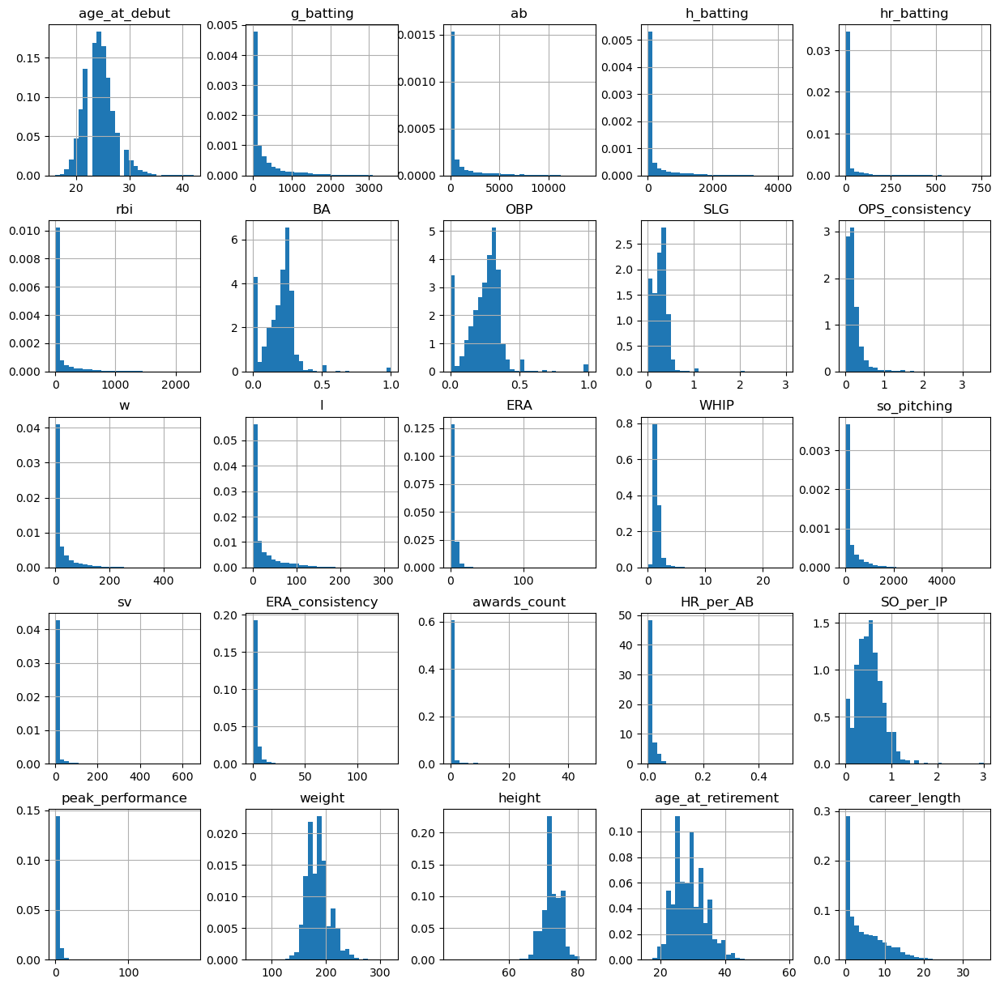

In [77]:
# Visualise the distribution of numerical features using histograms
final_data.hist(bins=30, figsize=(15,15), density=True)
plt.show()

### Univariate Analysis

#### Categorical Variables Analysis

In [78]:
# Calculates the frequency of each unique value in the 'pos' column of the final_data DataFrame
# and print the resulting frequencies as percentages.

# pos
pos_label_freq = final_data['pos'].value_counts() / len(final_data)
print(pos_label_freq)

pos
P     0.454089
OF    0.130982
C     0.095603
2B    0.079129
1B    0.066652
3B    0.056012
SS    0.047748
LF    0.027547
CF    0.027223
DH    0.004483
RF    0.000108
Name: count, dtype: float64


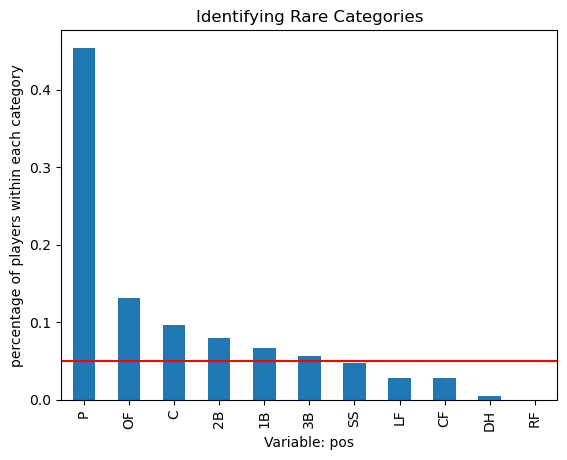

In [79]:
# let's make plot with the category frequencies
fig = pos_label_freq.sort_values(ascending=False).plot.bar()

# add a line to signal 5 % frequency limit
# under which we will consider a category as rare
fig.axhline(y=0.05, color='red')

# add axis labels and title
fig.set_ylabel('percentage of players within each category')
fig.set_xlabel('Variable: pos')
fig.set_title('Identifying Rare Categories')
plt.show()

#### Boolean Variables Analysis

In [80]:
# Frequency Distribution

# Calculate and print the frequency distribution of 'Reached3000Hits', 'Reached500HR', and 'Reached300Wins' columns
# showing the counts of True and False values for each.
print("Frequency Distribution:")
Reached3000Hits_freq = final_data['reached_3000_hits'].value_counts()  # Count True and False values
Reached500HR_freq = final_data['reached_500_HR'].value_counts()  # Count True and False values
Reached300Wins_freq = final_data['reached_300_wins'].value_counts()  # Count True and False values

print(f"{Reached3000Hits_freq}\n")
print(f"{Reached500HR_freq}\n")
print(f"{Reached300Wins_freq}\n")

Frequency Distribution:
reached_3000_hits
False    18485
True        29
Name: count, dtype: int64

reached_500_HR
False    18487
True        27
Name: count, dtype: int64

reached_300_wins
False    18490
True        24
Name: count, dtype: int64



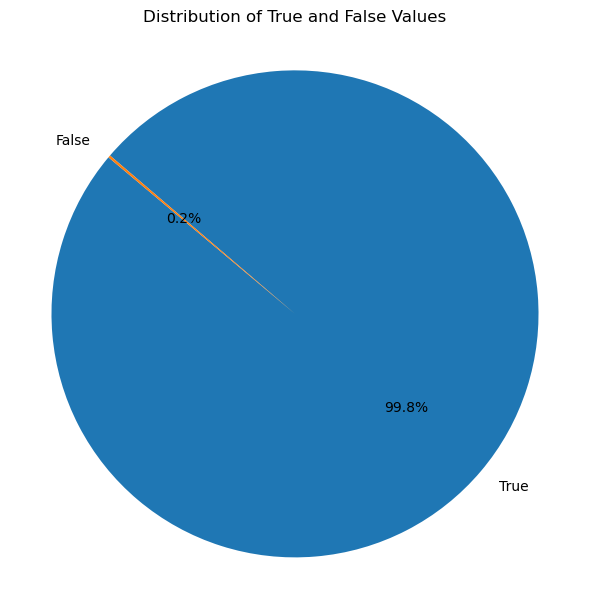

In [81]:
# Create a visual representation of the True and False value distribution in the Reached3000Hits column
# which helps in understanding the data.
plt.figure(figsize=(6, 6))
plt.pie(Reached3000Hits_freq, labels=['True', 'False'], autopct="%1.1f%%", startangle=140)
plt.title("Distribution of True and False Values\n")
plt.axis('equal')  # Equal aspect ratio for a circular pie chart
plt.tight_layout()
plt.show()

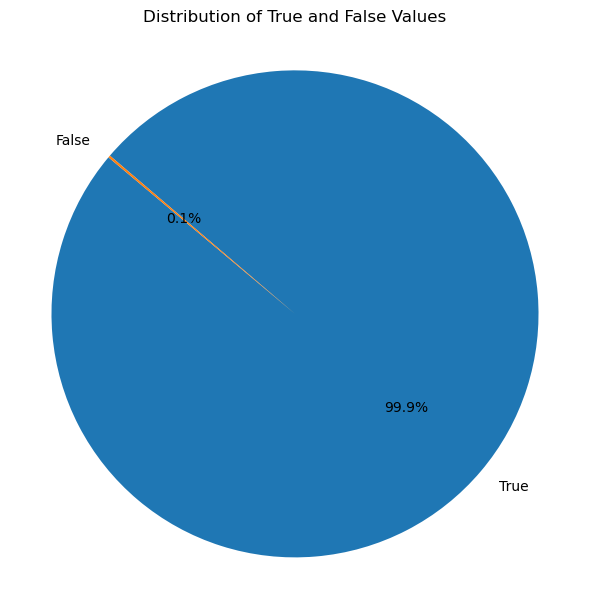

In [82]:
# Create a visual representation of the True and False value distribution in the Reached500HR column
# which helps in understanding the data.
plt.figure(figsize=(6, 6))
plt.pie(Reached500HR_freq, labels=['True', 'False'], autopct="%1.1f%%", startangle=140)
plt.title("Distribution of True and False Values\n")
plt.axis('equal')  # Equal aspect ratio for a circular pie chart
plt.tight_layout()
plt.show()

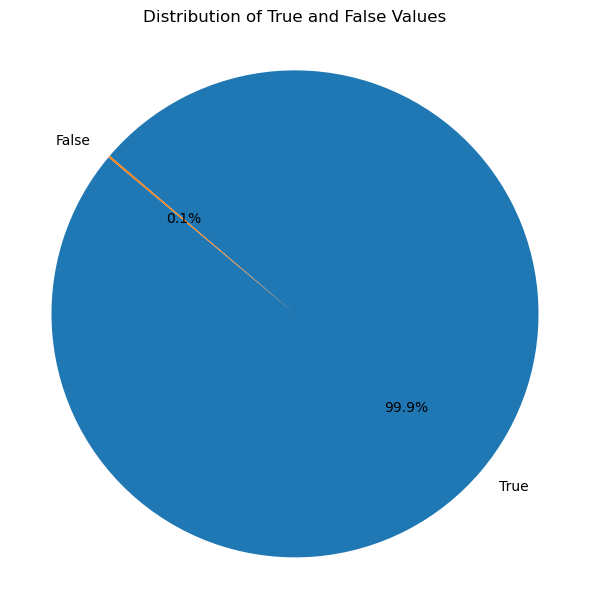

In [83]:
# Create a visual representation of the True and False value distribution in the Reached300Wins column
# which helps in understanding the data.
plt.figure(figsize=(6, 6))
plt.pie(Reached300Wins_freq, labels=['True', 'False'], autopct="%1.1f%%", startangle=140)
plt.title("Distribution of True and False Values\n")
plt.axis('equal')  # Equal aspect ratio for a circular pie chart
plt.tight_layout()
plt.show()

In [84]:
# Create a new column named 'Milestone_Achievement' that combines the
# 3 boolean columns ('reached_3000_hits', 'reached_500_HR', and 'reached_300_wins') into a single string containing 
# the achieved milestones for each row.
def combine_milestones(row):
    milestones = []
    if row['reached_3000_hits']:
        milestones.append('3000Hits')
    if row['reached_500_HR']:
        milestones.append('500HR')
    if row['reached_300_wins']:
        milestones.append('300Wins')
    return ','.join(milestones) if milestones else 'None'

final_data['Milestone_Achievement'] = final_data.apply(combine_milestones, axis=1)

In [85]:
pd.set_option('display.max_columns', None)
display(final_data.head())

,player_id,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,career_length,reached_3000_hits,reached_500_HR,reached_300_wins,Milestone_Achievement
0,aardsda01,23,331.0,4.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,4.272997,1.421365,340.0,69.0,1.967524,P,0.0,0.000000,1.008902,4.272997,220.0,75.0,R,R,34,11.378508,False,False,False,None
1,aaronha01,20,3298.0,12364.0,3771.0,755.0,2297.0,0.304998,0.373949,0.554513,0.101729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.061064,NaN,0.928462,180.0,72.0,R,R,42,22.475017,True,True,False,"3000Hits,500HR"
2,aaronto01,23,437.0,944.0,216.0,13.0,94.0,0.228814,0.291506,0.327331,0.087157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.013771,NaN,0.618836,190.0,75.0,R,R,32,9.462012,False,False,False,None
3,aasedo01,23,448.0,5.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,66.0,60.0,3.796875,1.390024,641.0,82.0,0.997324,P,0.0,0.000000,0.577825,3.796875,190.0,75.0,R,R,36,13.188227,False,False,False,None
4,abadan01,29,15.0,21.0,2.0,0.0,0.0,0.095238,0.240000,0.095238,0.213251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.000000,NaN,0.335238,184.0,73.0,L,L,34,4.588638,False,False,False,None


In [86]:
# Drop the unnecessary columns after creating 'Milestone Achievement'
final_data.drop(columns=['reached_3000_hits', 'reached_500_HR', 'reached_300_wins'], inplace=True)

In [87]:
pd.set_option('display.max_columns', None)
display(final_data.head())

,player_id,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,career_length,Milestone_Achievement
0,aardsda01,23,331.0,4.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,16.0,18.0,4.272997,1.421365,340.0,69.0,1.967524,P,0.0,0.000000,1.008902,4.272997,220.0,75.0,R,R,34,11.378508,None
1,aaronha01,20,3298.0,12364.0,3771.0,755.0,2297.0,0.304998,0.373949,0.554513,0.101729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OF,16.0,0.061064,NaN,0.928462,180.0,72.0,R,R,42,22.475017,"3000Hits,500HR"
2,aaronto01,23,437.0,944.0,216.0,13.0,94.0,0.228814,0.291506,0.327331,0.087157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.013771,NaN,0.618836,190.0,75.0,R,R,32,9.462012,None
3,aasedo01,23,448.0,5.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,NaN,66.0,60.0,3.796875,1.390024,641.0,82.0,0.997324,P,0.0,0.000000,0.577825,3.796875,190.0,75.0,R,R,36,13.188227,None
4,abadan01,29,15.0,21.0,2.0,0.0,0.0,0.095238,0.240000,0.095238,0.213251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1B,0.0,0.000000,NaN,0.335238,184.0,73.0,L,L,34,4.588638,None


### Univariate Analysis

#### Categorical Variables Analysis

In [88]:
# Calculate the frequency of each unique value in the 'Milestone_Achievement' column
# and print the resulting frequencies as percentages.

# pos
Milestone_Achievement_freq = final_data['Milestone_Achievement'].value_counts() / len(final_data)
print(Milestone_Achievement_freq)

Milestone_Achievement
None              0.995949
300Wins           0.001296
3000Hits          0.001296
500HR             0.001188
3000Hits,500HR    0.000270
Name: count, dtype: float64


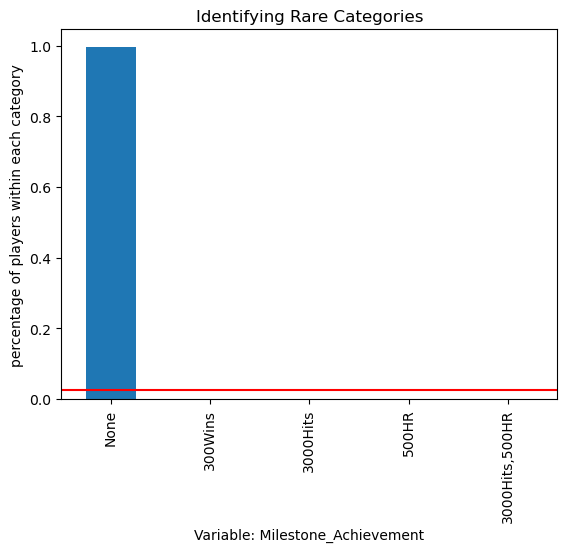

In [89]:
# let's make plot with the category frequencies
fig = Milestone_Achievement_freq.sort_values(ascending=False).plot.bar()

# add a line to signal 2.5 % frequency limit
# under which we will consider a category as rare
fig.axhline(y=0.025, color='red')

# add axis labels and title
fig.set_ylabel('percentage of players within each category')
fig.set_xlabel('Variable: Milestone_Achievement')
fig.set_title('Identifying Rare Categories')
plt.show()

#### Numerical Variables Analysis

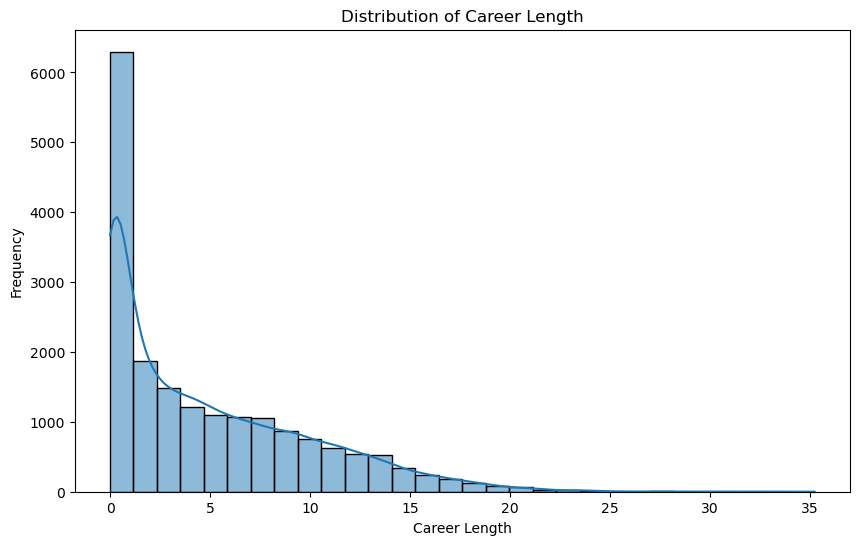

In [90]:
# Distribution of Career Length
plt.figure(figsize=(10, 6))
sns.histplot(final_data['career_length'], bins=30, kde=True)
plt.title('Distribution of Career Length')
plt.xlabel('Career Length')
plt.ylabel('Frequency')
plt.show()

In [91]:
# Plot histogram, Q-Q plots, and boxplot to have a look at the variable distribution

def diagnostic_plots(final_data, variable):
    # function takes a final_data and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.distplot(final_data[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(final_data[variable], dist="norm", plot=plt)
    plt.ylabel('quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=final_data[variable])
    plt.title('Boxplot')

    plt.show()

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


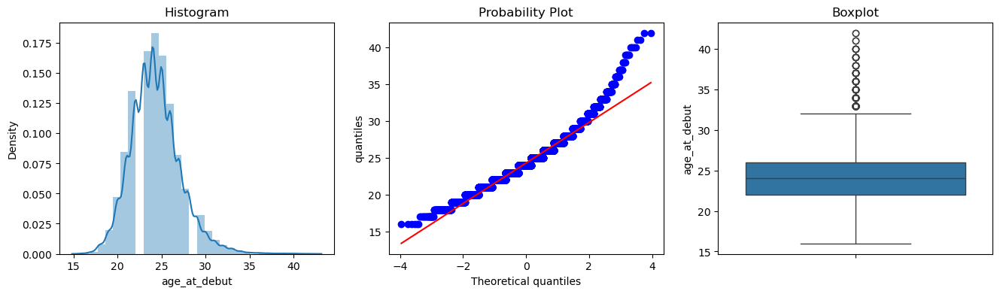

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


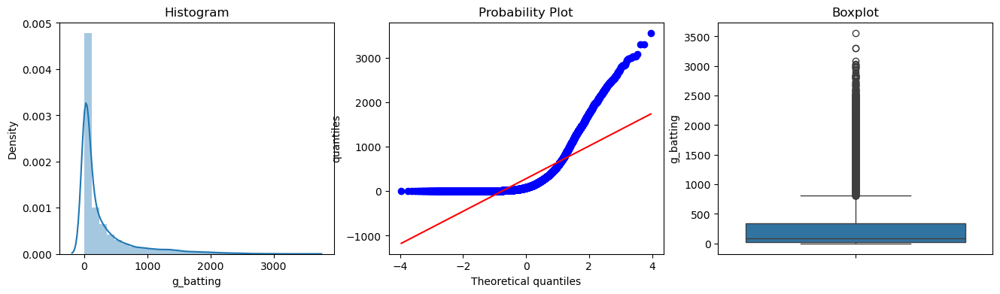

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


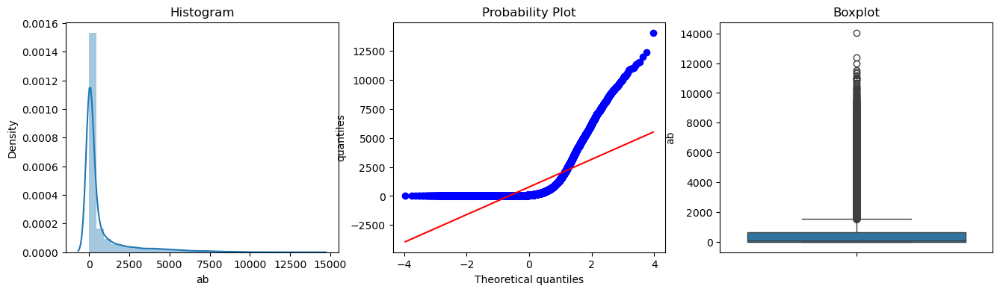

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


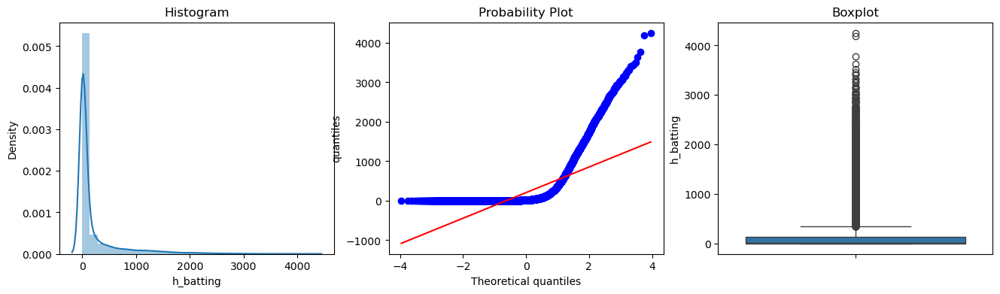

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


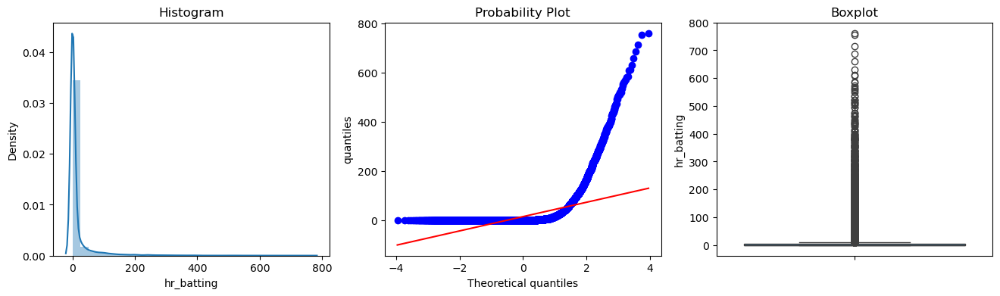

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


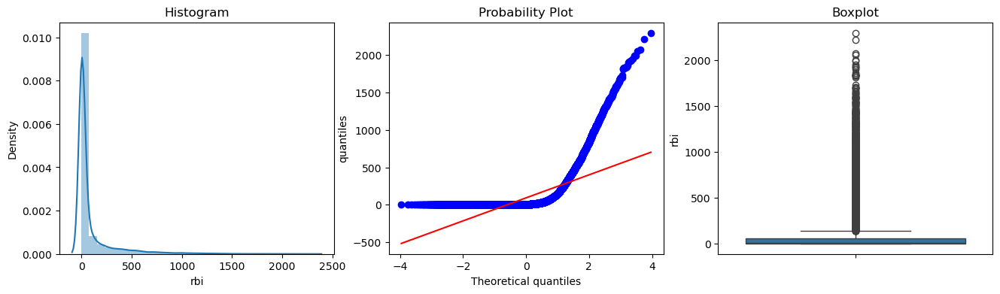

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


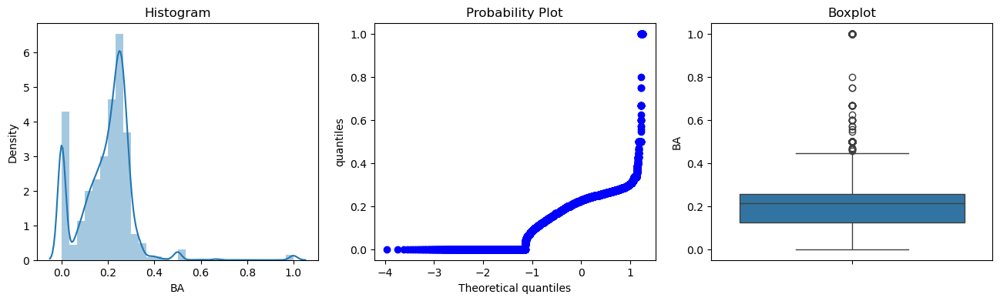

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


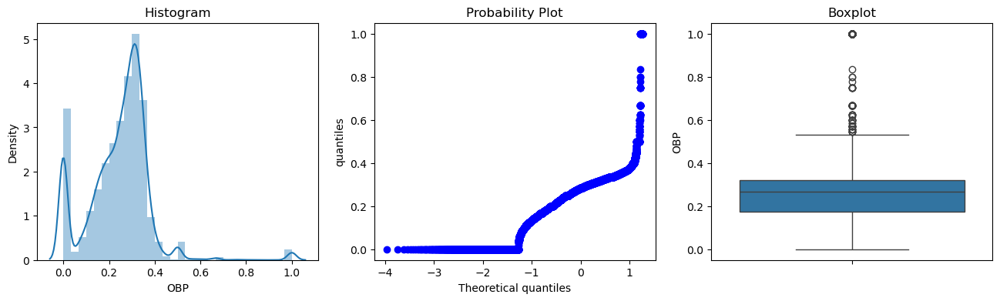

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


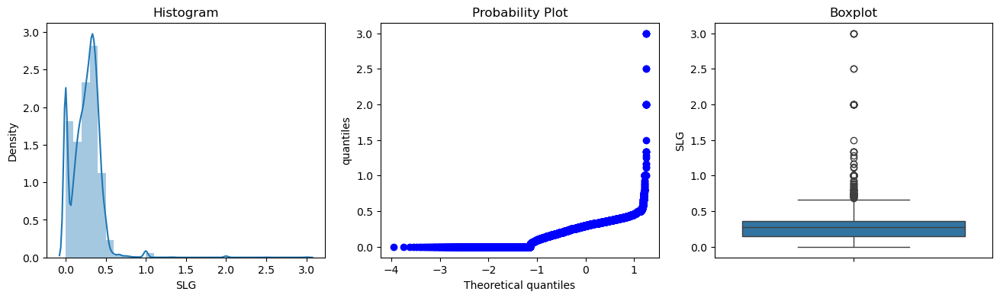

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


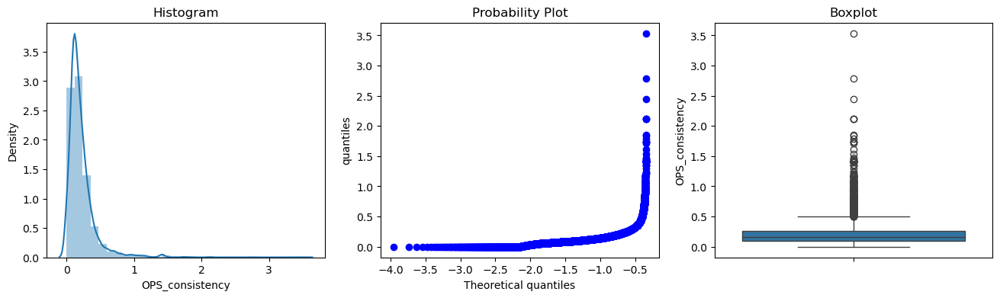

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


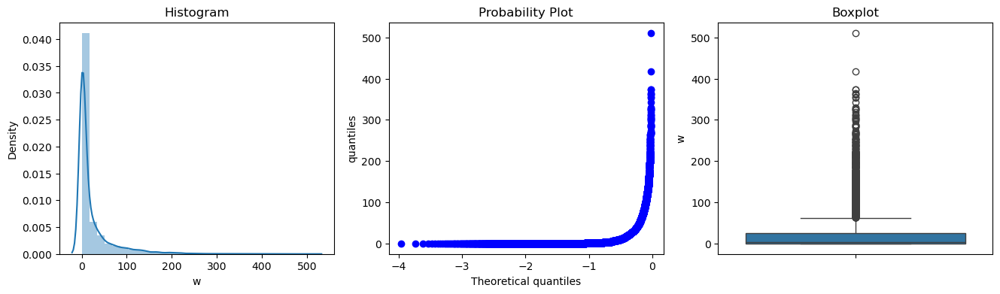

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


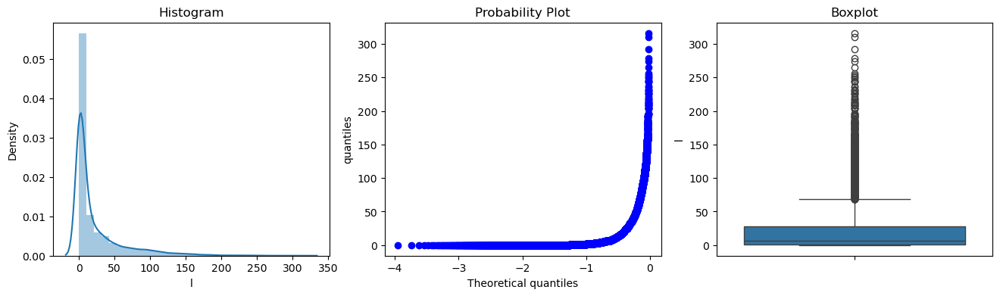

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


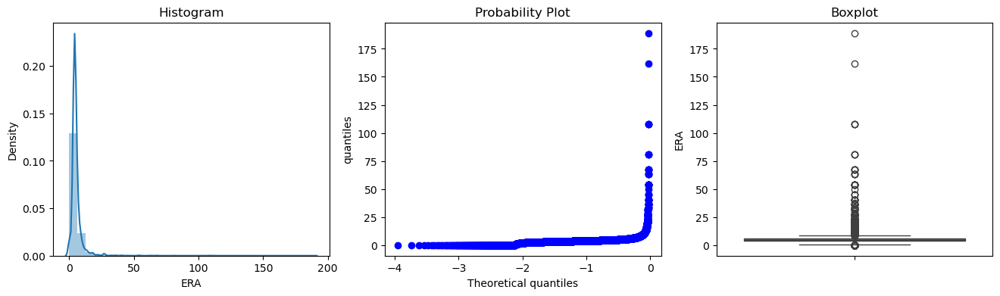

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


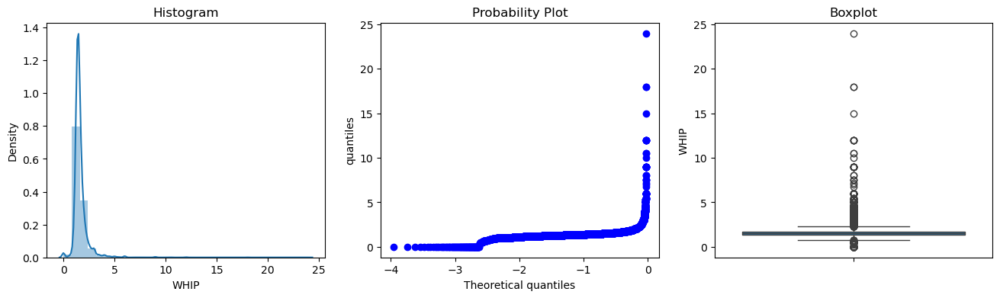

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


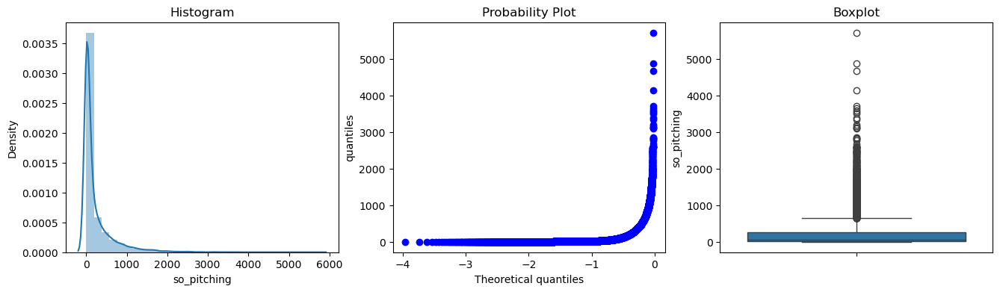

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


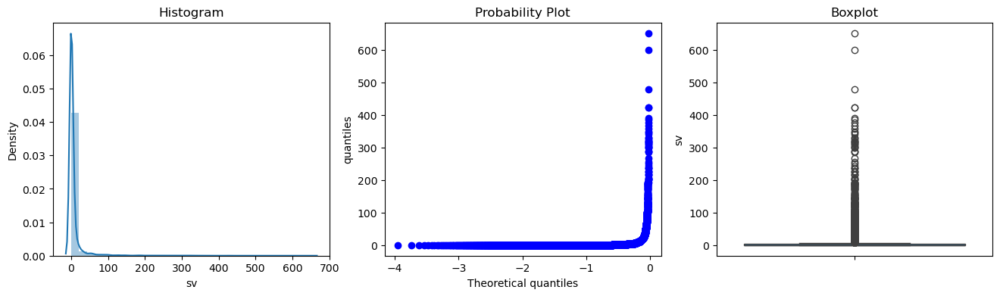

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


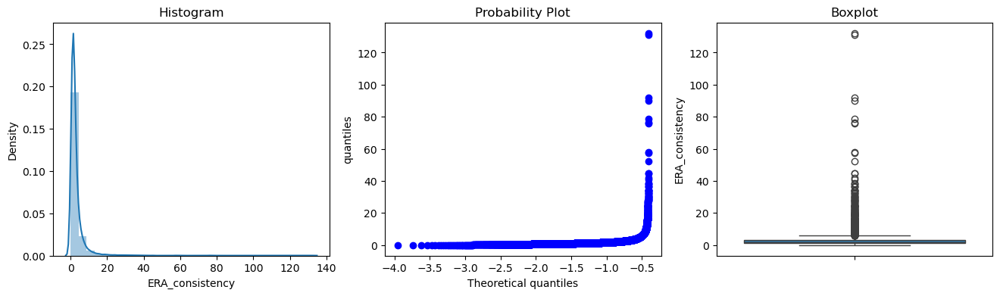

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


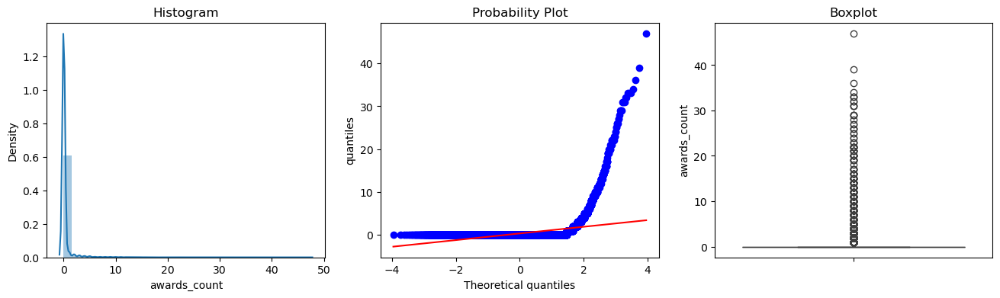

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


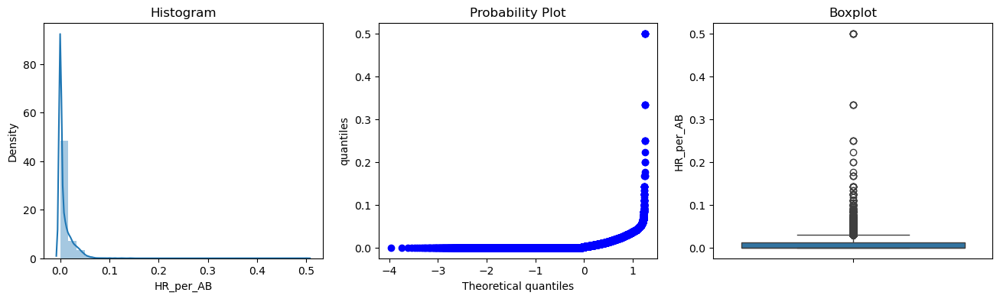

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


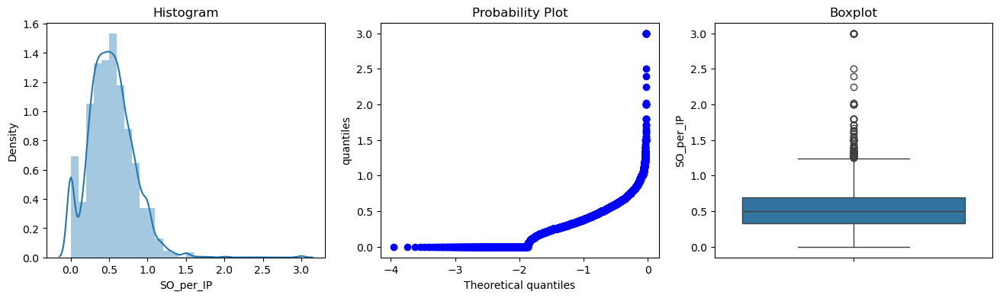

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


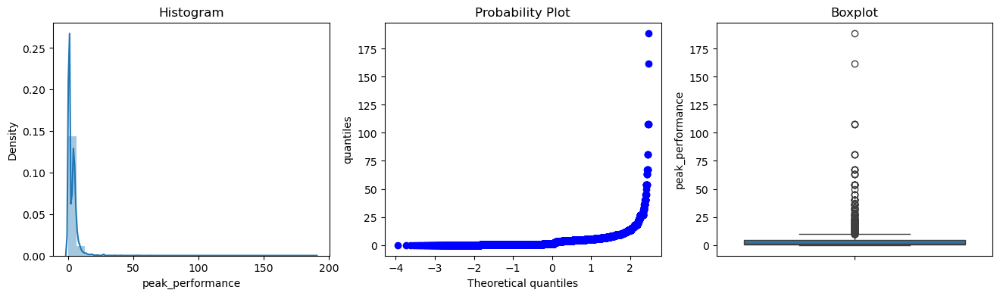

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


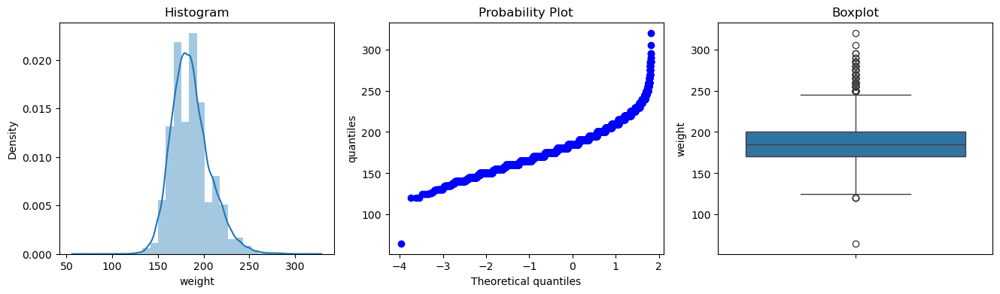

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


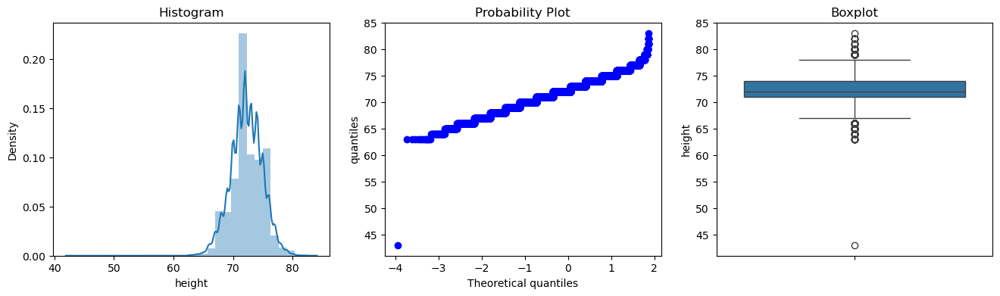

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


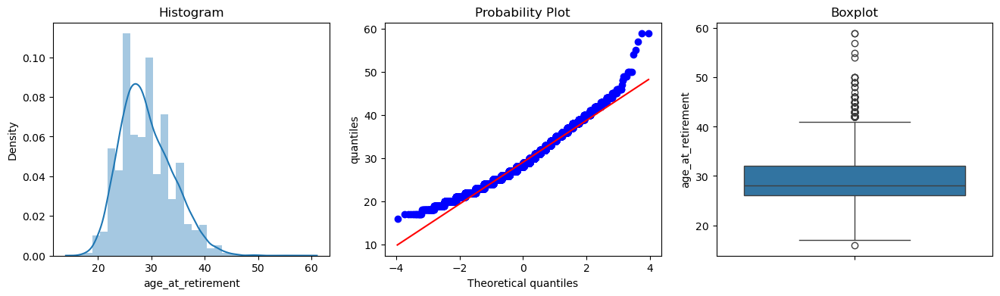

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(final_data[variable], bins=30)


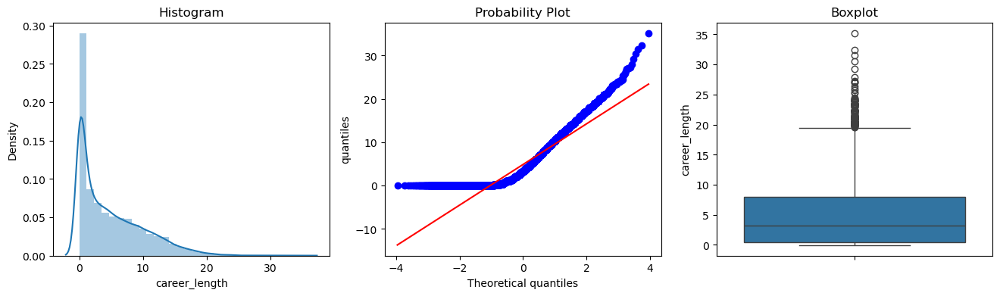

In [92]:
# Check original distribution
# and detecting outliers using boxplots
for num_column in final_data[num_cols]:
    diagnostic_plots(final_data, num_column)

### Correlations

In [93]:
# Explore the correlations between any two features / variables
final_data[num_cols].corr()

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,age_at_retirement,career_length
age_at_debut,1.000000,-0.244833,-0.229737,-0.221025,-0.168807,-0.214149,-0.043078,-0.029821,-0.055218,0.046071,-0.204543,-0.222205,0.014142,0.004076,-0.208466,-0.026504,0.022617,-0.137900,-0.049312,0.042357,0.005962,0.042856,-0.008885,0.239876,-0.319323
g_batting,-0.244833,1.000000,0.965738,0.954439,0.761148,0.922772,0.277082,0.276896,0.341534,-0.214438,0.397198,0.397062,-0.084198,-0.084218,0.404103,0.315601,-0.037326,0.494631,0.318753,0.027196,-0.152975,-0.003850,-0.046539,0.653449,0.776785
ab,-0.229737,0.965738,1.000000,0.995065,0.782505,0.960318,0.307863,0.306206,0.368644,-0.243599,0.161412,0.142205,-0.011041,0.022594,0.102864,-0.024093,0.035354,0.498178,0.319289,-0.132105,-0.158779,-0.052111,-0.106092,0.542992,0.660368
h_batting,-0.221025,0.954439,0.995065,1.000000,0.782379,0.966892,0.307898,0.305386,0.367000,-0.233902,0.087136,0.066554,-0.000265,0.036143,0.036267,-0.030255,0.047425,0.519346,0.312439,-0.124516,-0.151477,-0.049504,-0.104328,0.524433,0.637340
hr_batting,-0.168807,0.761148,0.782505,0.782379,1.000000,0.884517,0.213380,0.227440,0.323975,-0.174336,0.004844,-0.011775,0.011423,0.026180,-0.011473,-0.022383,0.044038,0.568575,0.451064,-0.062032,-0.114727,0.104762,0.049548,0.385536,0.471337
rbi,-0.214149,0.922772,0.960318,0.966892,0.884517,1.000000,0.288627,0.291474,0.368172,-0.212433,0.073532,0.050449,0.002565,0.036430,0.025941,-0.028768,0.043007,0.557673,0.368938,-0.115161,-0.140359,0.003060,-0.057258,0.501134,0.610363
BA,-0.043078,0.277082,0.307863,0.307898,0.213380,0.288627,1.000000,0.915597,0.908180,0.092772,0.055229,0.050069,0.045735,0.068768,0.006879,-0.030822,-0.011908,0.101306,0.259739,-0.149339,-0.168445,-0.095417,-0.156842,0.145694,0.167917
OBP,-0.029821,0.276896,0.306206,0.305386,0.227440,0.291474,0.915597,1.000000,0.846921,0.047080,0.036379,0.029278,0.038411,0.068014,-0.009389,-0.027119,0.000238,0.102664,0.280197,-0.144699,-0.189248,-0.097938,-0.174844,0.141460,0.156336
SLG,-0.055218,0.341534,0.368644,0.367000,0.323975,0.368172,0.908180,0.846921,1.000000,0.064355,0.056618,0.049730,0.049357,0.071411,0.013570,-0.018603,-0.008071,0.142858,0.516292,-0.125877,-0.190639,-0.013206,-0.099468,0.180765,0.208619
OPS_consistency,0.046071,-0.214438,-0.243599,-0.233902,-0.174336,-0.212433,0.092772,0.047080,0.064355,1.000000,-0.056377,-0.058595,-0.021564,-0.026574,-0.036035,0.078502,-0.002863,-0.073310,-0.011888,0.053181,0.119278,0.055517,0.090411,-0.046772,-0.070405


Career Length as Target

In [94]:
# Calculate the correlation between numerical columns in a DataFrame and a specific target variable named 'careerLength'
correlation_matrix = final_data[num_cols].corr()

# Display the correlations with the target variable in descending order
target_variable = 'career_length'
correlations = correlation_matrix[target_variable].sort_values(ascending=False)

print(correlations)

career_length        1.000000
age_at_retirement    0.842490
g_batting            0.776785
l                    0.711269
so_pitching          0.694227
w                    0.685415
ab                   0.660368
h_batting            0.637340
rbi                  0.610363
hr_batting           0.471337
awards_count         0.369380
sv                   0.336826
SLG                  0.208619
HR_per_AB            0.199350
BA                   0.167917
OBP                  0.156336
SO_per_IP            0.063789
weight               0.037526
height               0.034334
OPS_consistency     -0.070405
ERA_consistency     -0.074780
peak_performance    -0.102296
ERA                 -0.162424
WHIP                -0.195185
age_at_debut        -0.319323
Name: career_length, dtype: float64


In [95]:
# Set the limit to 0.50 for strong positive correlations
limit = 0.50 

# Select columns with null percentage above limit
high_positive_corr = correlations[correlations > limit]

# Print or further process these columns
print(f"Columns with correlations exceeding {limit}:", high_positive_corr.index.tolist())

Columns with correlations exceeding 0.5: ['career_length', 'age_at_retirement', 'g_batting', 'l', 'so_pitching', 'w', 'ab', 'h_batting', 'rbi']


In [96]:
# Set the limit to -0.50 for strong negative correlations
limit = -0.50 

# Select columns with null percentage above limit
high_negative_corr = correlations[correlations < limit]

# Print or further process these columns
print(f"Columns with correlations below {limit}:", high_negative_corr.index.tolist())

Columns with correlations below -0.5: []


### Visualisations: Static and Interactive Charts

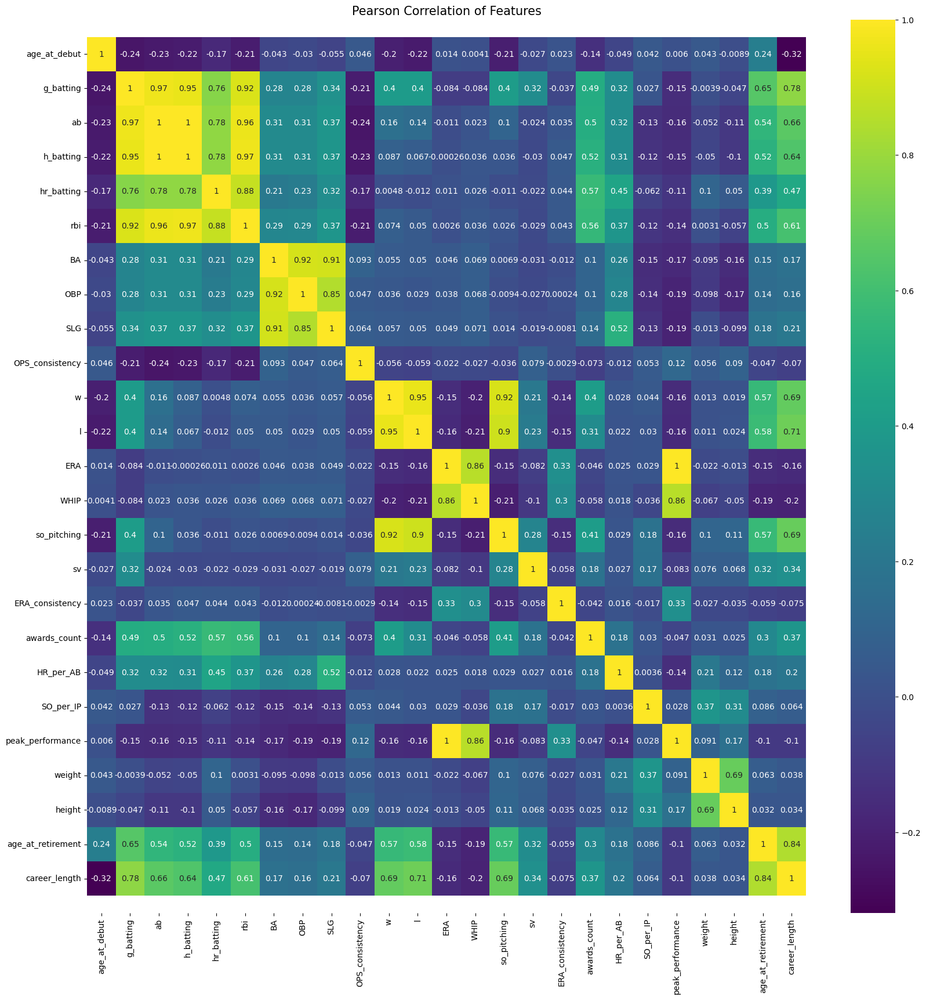

In [97]:
# Heatmap: visualize the correlation between any two features / variables

colormap = plt.cm.viridis
plt.figure(figsize=(20,20))
plt.title('Pearson Correlation of Features', size=15)
ax = sns.heatmap(final_data[num_cols].corr(), cmap=colormap, annot=True)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.show()

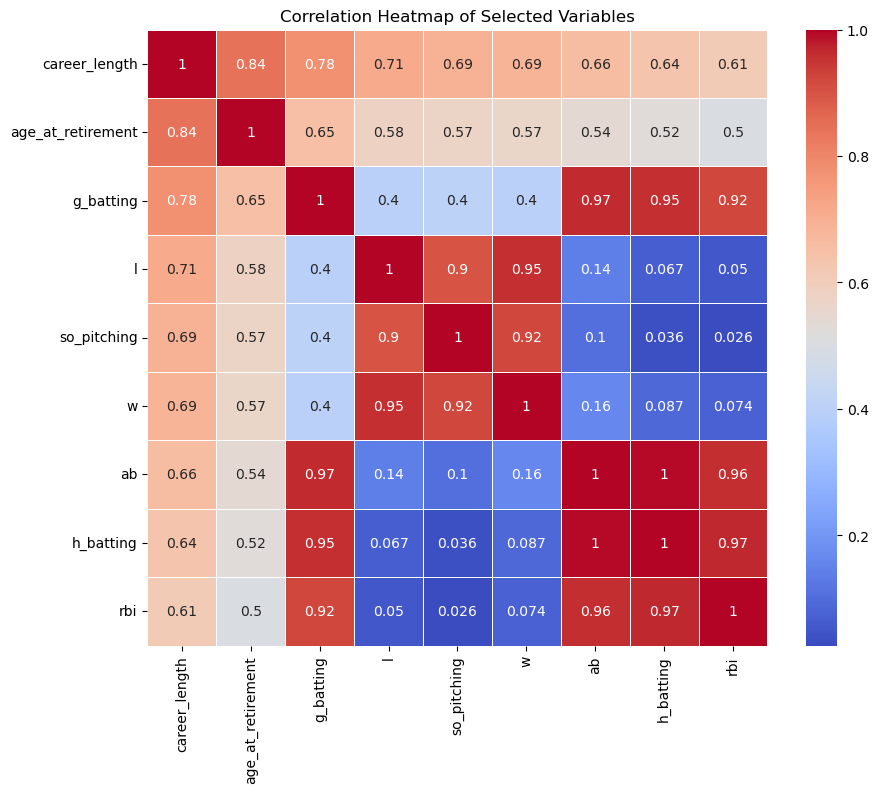

In [98]:
# 1. Key factors influencing career longevity
# selected columns with high correlations
selected_columns = ['career_length', 'age_at_retirement', 'g_batting', 'l', 'so_pitching', 'w', 'ab', 'h_batting', 'rbi']
filtered_data = final_data[selected_columns]

# Compute the correlation matrix
corr_matrix = filtered_data.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Selected Variables')
plt.show()

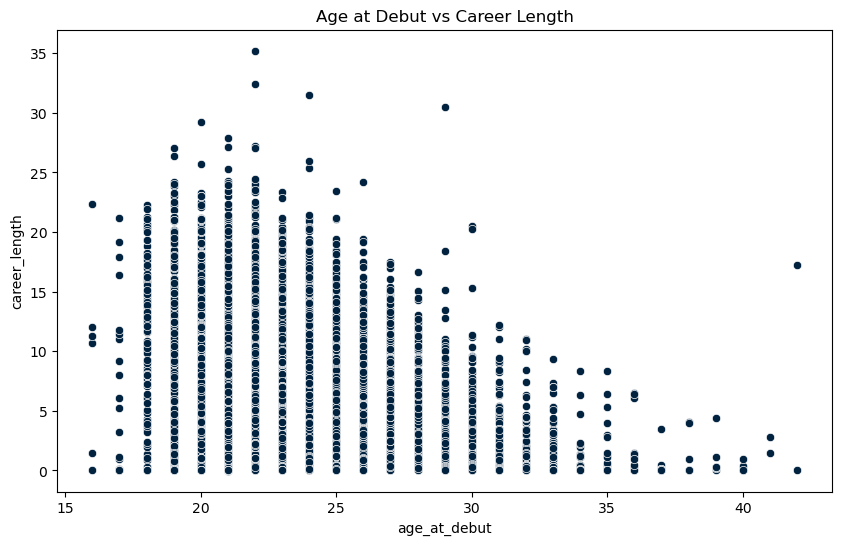

In [99]:
# Impact of age_at_debut on career outcomes

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Create the figure
plt.figure(figsize=(10, 6))

# Define colour palette from mlb_colours
palette = mlb_colours

# Scatter plot with custom mlb_colour
sns.scatterplot(data=final_data, x='age_at_debut', y='career_length', color=palette[2])  # Use first color

# Title
plt.title('Age at Debut vs Career Length')

plt.show()

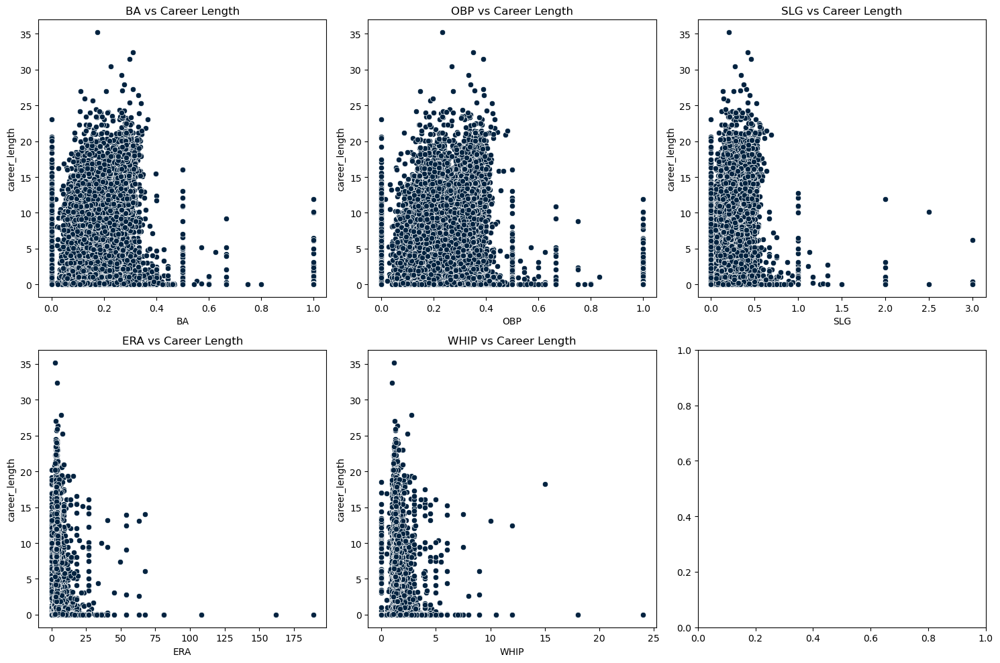

In [100]:
# Relationship between performance metrics and career success

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Specify performance metrics to monitor here
performance_metrics = ['BA', 'OBP', 'SLG', 'ERA', 'WHIP']

# Create the figure and subplots
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Define colour palette from mlb_colours
palette = mlb_colours

# Scatter plots with custom mlb_colour
for i, metric in enumerate(performance_metrics):
    sns.scatterplot(data=final_data, x=metric, y='career_length', ax=axes[i//3, i%3], color=palette[2])
    axes[i//3, i%3].set_title(f'{metric} vs Career Length')
    
plt.tight_layout()

plt.show()

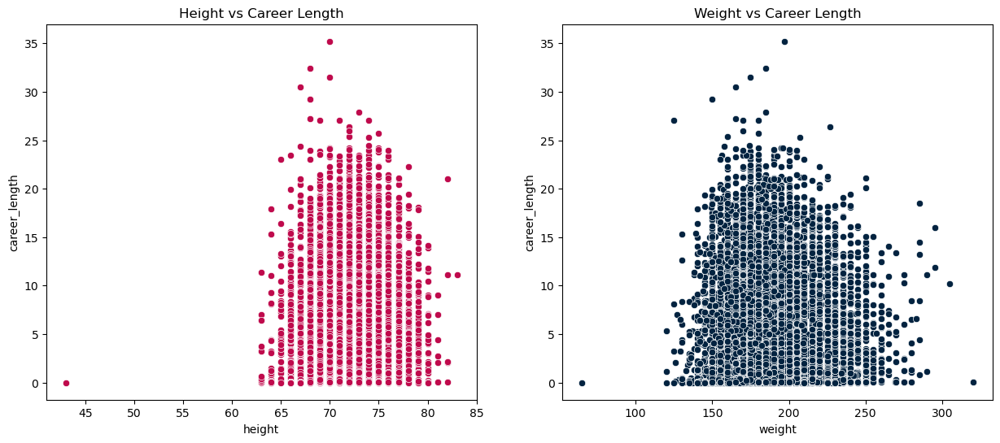

In [101]:
# Effect of physical attributes on performance and longevity

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Create the figure and subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Define colour palette from mlb_colours
palette = mlb_colours

# First scatter plot with custom mlb_colour
sns.scatterplot(data=final_data, x='height', y='career_length', ax=axes[0], color=palette[0])  # Use first color

# Set title
axes[0].set_title('Height vs Career Length')

# Second scatter plot with another custom mlb_colour
sns.scatterplot(data=final_data, x='weight', y='career_length', ax=axes[1], color=palette[2])  # Use second color

# Set title
axes[1].set_title('Weight vs Career Length')

plt.show()

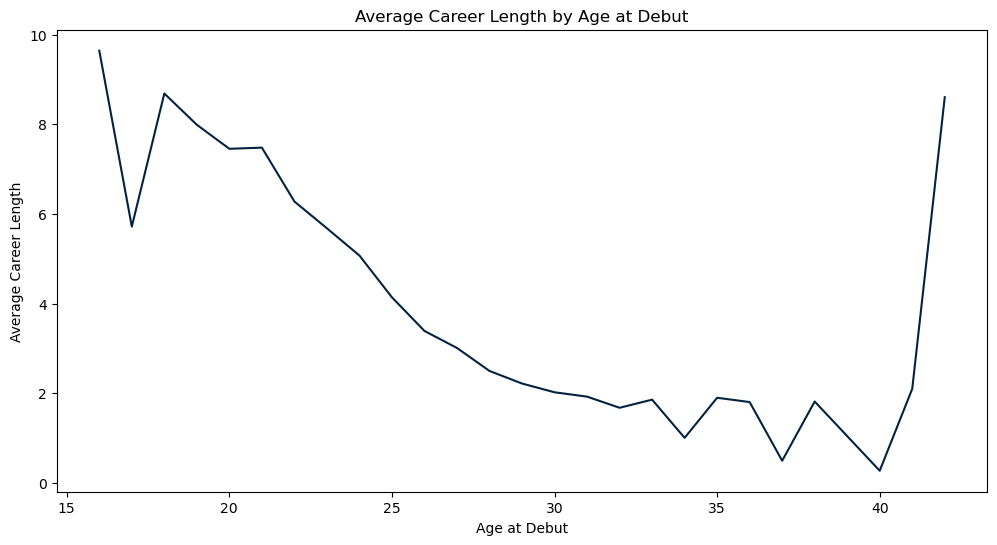

Optimal age range for debut: 16


In [102]:
# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Group by age_at_debut and calculate average careerLength
age_career = final_data.groupby('age_at_debut')['career_length'].mean().reset_index()

# Define colour palette from mlb_colours
palette = mlb_colours

# Plot

# Create the figure
plt.figure(figsize=(12, 6))

# Line plot with custom colour
sns.lineplot(x='age_at_debut', y='career_length', data=age_career, color=palette[2])

# Set title
plt.title('Average Career Length by Age at Debut')

# Set labels
plt.xlabel('Age at Debut')
plt.ylabel('Average Career Length')

plt.show()

# Find the age range with the highest average careerLength
optimal_age_range = age_career.loc[age_career['career_length'].idxmax(), 'age_at_debut']
print(f"Optimal age range for debut: {optimal_age_range}")

In [103]:
# Specify performance metrics to monitor here
performance_metrics = ['BA', 'OBP', 'SLG', 'HR_per_AB']

for metric in performance_metrics:
    # Calculate median as threshold
    threshold = final_data[metric].median()
    
    # Calculate percentage of players reaching milestones above threshold
    above_threshold = final_data[final_data[metric] > threshold]
    below_threshold = final_data[final_data[metric] <= threshold]
    
    above_milestone = above_threshold['Milestone_Achievement'].value_counts(normalize=True)
    below_milestone = below_threshold['Milestone_Achievement'].value_counts(normalize=True)
    
    print(f"\nPerformance metric: {metric}")
    print(f"Threshold: {threshold:.3f}")
    print("Percentage reaching milestones above threshold:")
    print(above_milestone)
    print("Percentage reaching milestones below threshold:")
    print(below_milestone)


Performance metric: BA
Threshold: 0.214
Percentage reaching milestones above threshold:
Milestone_Achievement
None              0.992995
3000Hits          0.002899
500HR             0.002657
300Wins           0.000845
3000Hits,500HR    0.000604
Name: proportion, dtype: float64
Percentage reaching milestones below threshold:
Milestone_Achievement
None       0.997948
300Wins    0.002052
Name: proportion, dtype: float64

Performance metric: OBP
Threshold: 0.268
Percentage reaching milestones above threshold:
Milestone_Achievement
None              0.993257
3000Hits          0.002890
500HR             0.002649
3000Hits,500HR    0.000602
300Wins           0.000602
Name: proportion, dtype: float64
Percentage reaching milestones below threshold:
Milestone_Achievement
None       0.997712
300Wins    0.002288
Name: proportion, dtype: float64

Performance metric: SLG
Threshold: 0.273
Percentage reaching milestones above threshold:
Milestone_Achievement
None              0.992753
3000Hits        

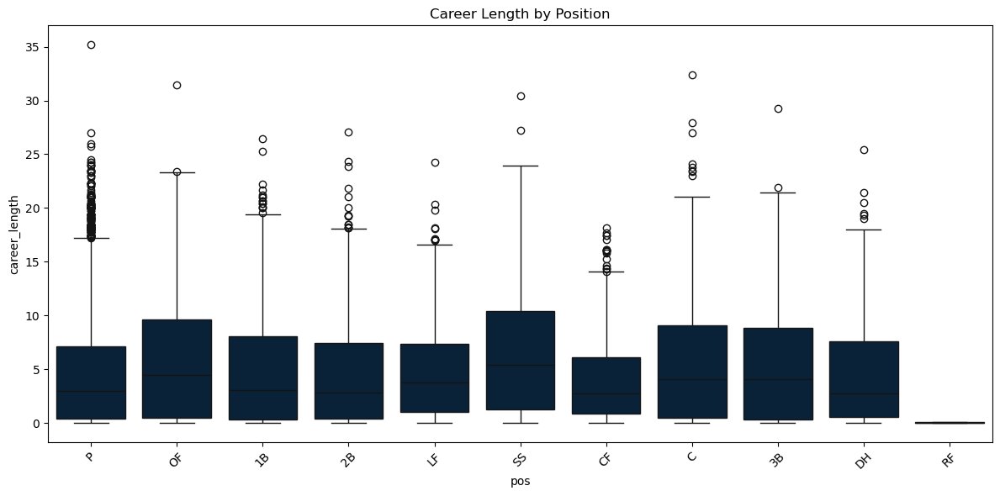

In [104]:
# Correlation between position and career length

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Create the figure
plt.figure(figsize=(12, 6))

# Define color palette from mlb_colours
palette = mlb_colours

# Box plot with custom mlb_colour
sns.boxplot(x='pos', y='career_length', data=final_data, color=palette[2])

# Set title
plt.title('Career Length by Position')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

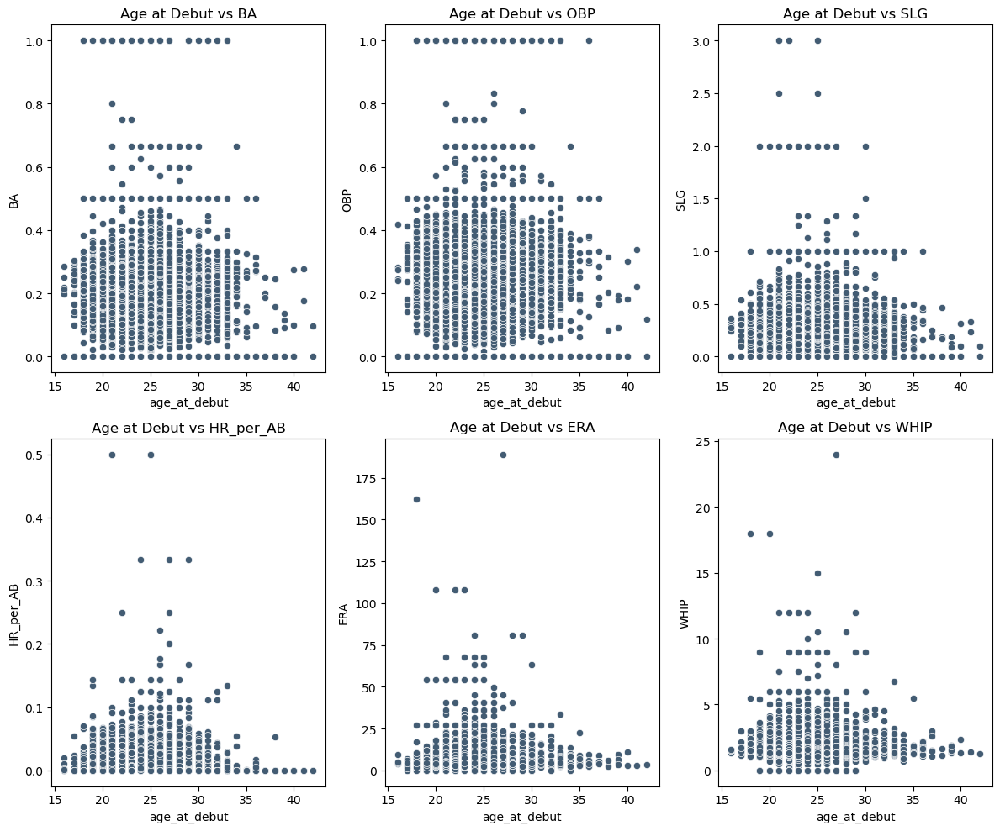

In [105]:
# Correlation between age_at_debut and performance metrics

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2", "#F2AEC7", "#CCD3D9", "#435C73"]

# Specify performance metrics to monitor here
performance_metrics = ['BA', 'OBP', 'SLG', 'HR_per_AB', 'ERA', 'WHIP']

# Create the figure
plt.figure(figsize=(12, 10))

# Define color palette from mlb_colours
palette = mlb_colours

# Scatter plot with custom mlb_colour
for i, metric in enumerate(performance_metrics):
    plt.subplot(2, 3, i+1)
    sns.scatterplot(x='age_at_debut', y=metric, data=final_data, color=palette[7])
    plt.title(f'Age at Debut vs {metric}')

plt.tight_layout()
plt.show()

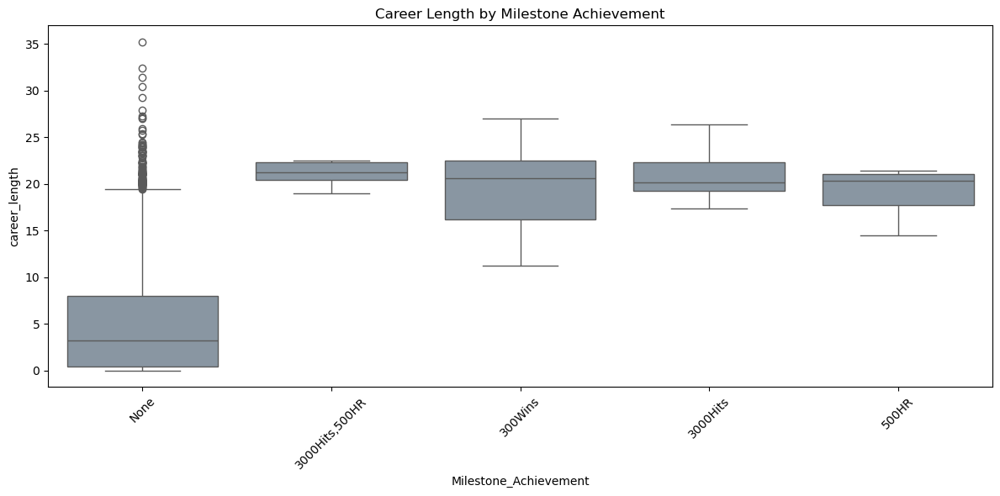

In [106]:
# Correlation between position and career length

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Create the figure
plt.figure(figsize=(12, 6))

# Define color palette from mlb_colours
palette = mlb_colours

# Box plot with custom mlb_colour
sns.boxplot(x='Milestone_Achievement', y='career_length', data=final_data, color=palette[3])

# Set title
plt.title('Career Length by Milestone Achievement')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [107]:
# Display a box plot to visualize the distribution of 'careerLength' for different levels of OPS_consistency

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_performance1 = px.scatter(final_data, x='OPS_consistency', y='career_length', 
                                       color_discrete_sequence=['#435C73'],
                                       title='OPS Consistency by Career Length')
fig_careerLength_performance1.show()

In [108]:
# Display a scatter plot to visualize the distribution of 'careerLength' for different levels of ERA_consistency

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_performance2 = px.scatter(final_data, x='ERA_consistency', y='career_length', 
                                       color_discrete_sequence=['#435C73'], 
                                       title='ERA Consistency by Career Length')
fig_careerLength_performance2.show()

In [109]:
# Display a scatter plot to visualize the distribution of 'careerLength' for different BA ranges

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_BA = px.scatter(final_data, x='BA', y='career_length', 
                             color_discrete_sequence=['#435C73'], 
                             title='BA by Career Length')
fig_careerLength_BA.show()

In [110]:
# Display a scatter plot to visualize the distribution of 'careerLength' for different OBP ranges

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_OBP = px.scatter(final_data, x='OBP', y='career_length', 
                              color_discrete_sequence=['#435C73'], 
                              title='OBP by Career Length')
fig_careerLength_OBP.show()

In [111]:
# Display a scatter plot to visualize the distribution of 'careerLength' for different SLG ranges

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_SLG = px.scatter(final_data, x='SLG', y='career_length', 
                              color_discrete_sequence=['#435C73'], 
                              title='SLG by Career Length')
fig_careerLength_SLG.show()

In [112]:
# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_ERA = px.scatter(final_data, x='ERA', y='career_length', 
                              color_discrete_sequence=['#435C73'], 
                              title='ERA Consistency by Career Length')
fig_careerLength_ERA.show()

In [113]:
# Display a scatter plot to visualize the distribution of 'careerLength' for different WHIP ranges

# MLB Colour palette
mlb_colours = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_careerLength_WHIP = px.scatter(final_data, x='WHIP', y='career_length',
                               color_discrete_sequence=['#435C73'], 
                               title='WHIP by Career Length')
fig_careerLength_WHIP.show()

In [114]:
# Define a MLB-themed color palette
mlb_colors = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

fig_career_length = px.histogram(final_data, x='career_length', 
                                 color_discrete_sequence=['#8596A6'], 
                                 title='Distribution of Career Length')
fig_career_length.show()

In [115]:
# Define a MLB-themed color palette
mlb_colors = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_age_milestone = px.scatter(final_data, x='age_at_debut', y='Milestone_Achievement', color='pos', 
                               color_discrete_sequence=mlb_colors, 
                               title='Milestone Achievement vs Age at Debut by Position')

# Modify the marker size and design (outline the markers)
fig_age_milestone.update_traces(
    marker=dict(
        size=10,  # Adjust the size as needed
        line=dict(
            color='Black',  # Outline color
            width=1.25         # Outline width
        )
    )
)

# fig.update_traces(marker_color=mlb_colors)
fig_age_milestone.show()

C:\Users\tswr1\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [116]:
# Define a MLB-themed color palette
mlb_colors = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

fig_performance_pos = px.box(final_data, x='pos', y='OPS_consistency', 
                             color_discrete_sequence=['#435C73'], 
                             title='OPS Consistency by Position')
fig_performance_pos.show()

In [117]:
# Define a MLB-themed color palette
mlb_colors = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_era_whip = px.scatter(final_data, x='WHIP', y='ERA_consistency', color='pos', 
                          color_discrete_sequence=mlb_colors,
                          title='ERA Consistency vs WHIP by Position')

# Modify the marker size and design (outline the markers)
fig_era_whip.update_traces(
    marker=dict(
        size=8,  # Adjust the size as needed
        line=dict(
            color='Black',  # Outline color
            width=1.25         # Outline width
        )
    )
)

fig_era_whip.show()

C:\Users\tswr1\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [118]:
# Define a MLB-themed color palette
mlb_colors = ["#BF0A4C", "#D94A7E", "#022340", "#8596A6", "#F2F2F2","#F2AEC7","#CCD3D9","#435C73"]

# Scatter plot with custom mlb_colour
fig_awards_careerlength = px.scatter(final_data, x='awards_count', y='career_length', 
                                     color_discrete_sequence=mlb_colors, 
                                     title='Number of Awards by Career Length')

# Modify the marker size and design (outline the markers)
fig_awards_careerlength.update_traces(
    marker=dict(
        size=8,  # Adjust the size as needed
        line=dict(
            color='Black',  # Outline color
            width=1.25         # Outline width
        )
    )
)

fig_awards_careerlength.show()

In [119]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18514 entries, 0 to 18845
Data columns (total 30 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   player_id              18514 non-null  object 
 1   age_at_debut           18514 non-null  int32  
 2   g_batting              18514 non-null  float64
 3   ab                     18514 non-null  float64
 4   h_batting              18514 non-null  float64
 5   hr_batting             18514 non-null  float64
 6   rbi                    18514 non-null  float64
 7   BA                     16564 non-null  float64
 8   OBP                    16611 non-null  float64
 9   SLG                    16564 non-null  float64
 10  OPS_consistency        6794 non-null   float64
 11  w                      9087 non-null   float64
 12  l                      9087 non-null   float64
 13  ERA                    9061 non-null   float64
 14  WHIP                   9061 non-null   float64
 15  so_pitc

## Step 5: Train Test Split

In [120]:
# Separate the data into training (70%) and testing sets (30%)
# Target variable is careerLength
finalData = final_data.drop(['player_id'], axis=1)

X_train, X_test, y_train, y_test = train_test_split(
    finalData.drop('career_length', axis=1), finalData['career_length'], test_size=0.3, random_state=0)

X_train.shape, X_test.shape

((12959, 28), (5555, 28))

In [121]:
# Find numerical variables after train and test split
X_train_num_cols = [n for n in X_train.columns if X_train[n].dtypes!='O']
X_train[X_train_num_cols].isnull().mean().sort_values()

age_at_debut         0.000000
awards_count         0.000000
rbi                  0.000000
hr_batting           0.000000
age_at_retirement    0.000000
ab                   0.000000
g_batting            0.000000
h_batting            0.000000
peak_performance     0.006945
height               0.031252
weight               0.035574
OBP                  0.103557
BA                   0.106104
SLG                  0.106104
HR_per_AB            0.106104
so_pitching          0.508218
w                    0.508218
sv                   0.508218
l                    0.508218
WHIP                 0.509530
ERA                  0.509530
SO_per_IP            0.509530
OPS_consistency      0.636315
ERA_consistency      0.657072
dtype: float64

In [122]:
# Find categorical variables after train and test split
X_train_cat_cols = [c for c in X_train.columns if X_train[c].dtypes=='O']
X_train[X_train_cat_cols].isnull().mean().sort_values()

Milestone_Achievement    0.000000
pos                      0.010726
throws                   0.039046
bats                     0.051084
dtype: float64

## Step 6: Data Cleansing and Transformation

### Handling Missing Values

In [123]:
# Make a list with numerical varibles (arbitrary & median) and categorical variables (frequent & missing). 
# we make a list with the numerical vars
features_num_arbitrary = ['so_pitching', 'w', 'sv', 'l', 'WHIP', 'ERA', 'SO_per_IP', 'OPS_consistency',
                          'ERA_consistency']
features_num_median = ['peak_performance', 'height', 'weight', 'OBP', 'BA', 'SLG', 'HR_per_AB']

# we make a list with the categorical vars
features_cat_frequent = ['Milestone_Achievement']
features_cat_missing = ['pos','throws','bats']

In [124]:
# Assembling an imputation pipeline using Feature Engine

pipe = Pipeline(steps=[
    ('imp_num_arbitrary', mdi.ArbitraryNumberImputer(variables = features_num_arbitrary)),
    ('imp_num_median', mdi.MeanMedianImputer(imputation_method = 'median', variables=features_num_median)),
    ('imp_cat_frequent', mdi.CategoricalImputer(variables = features_cat_frequent, imputation_method='frequent')),
    ('imp_cat_missing', mdi.CategoricalImputer(variables=features_cat_missing, imputation_method='missing'))
])

# now we fit the preprocessor
pipe.fit(X_train)

Pipeline(steps=[('imp_num_arbitrary',
                 ArbitraryNumberImputer(variables=['so_pitching', 'w', 'sv',
                                                   'l', 'WHIP', 'ERA',
                                                   'SO_per_IP',
                                                   'OPS_consistency',
                                                   'ERA_consistency'])),
                ('imp_num_median',
                 MeanMedianImputer(variables=['peak_performance', 'height',
                                              'weight', 'OBP', 'BA', 'SLG',
                                              'HR_per_AB'])),
                ('imp_cat_frequent',
                 CategoricalImputer(imputation_method='frequent',
                                    variables=['Milestone_Achievement'])),
                ('imp_cat_missing',
                 CategoricalImputer(variables=['pos', 'throws', 'bats']))])

In [125]:
# and now we impute the data
X_train_imputed = pipe.transform(X_train)
X_test_imputed = pipe.transform(X_test)

X_train_imputed

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,pos,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,bats,throws,age_at_retirement,Milestone_Achievement
1917,26,12.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,999.000000,0.0,1.0,4.584906,1.301887,18.0,0.0,3.304364,P,0.0,0.000000,1.018868,4.584906,190.0,73.0,L,L,27,None
14227,34,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,999.000000,999.0,999.0,999.000000,999.000000,999.0,999.0,999.000000,Missing,0.0,0.000000,999.000000,0.000000,190.0,72.0,R,R,34,None
3037,23,506.0,1536.0,390.0,6.0,127.0,0.253906,0.318263,0.333333,999.000000,999.0,999.0,999.000000,999.000000,999.0,999.0,999.000000,C,0.0,0.003906,999.000000,0.651596,165.0,68.0,L,R,38,None
6295,25,72.0,8.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.0,3.0,4.556962,1.582278,55.0,0.0,0.779150,P,0.0,0.000000,0.696203,4.556962,190.0,72.0,L,L,27,None
9711,22,8.0,27.0,4.0,0.0,0.0,0.148148,0.148148,0.148148,999.000000,2.0,6.0,5.676923,1.692308,27.0,0.0,999.000000,P,0.0,0.000000,0.415385,5.676923,185.0,71.0,R,R,22,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9374,24,284.0,6.0,2.0,0.0,1.0,0.333333,0.333333,0.333333,999.000000,20.0,29.0,3.674556,1.338018,251.0,22.0,1.994036,P,0.0,0.000000,0.556953,3.674556,210.0,77.0,R,L,31,None
13349,23,402.0,1258.0,297.0,8.0,131.0,0.236089,0.316501,0.325119,999.000000,999.0,999.0,999.000000,999.000000,999.0,999.0,999.000000,2B,0.0,0.006359,999.000000,0.641620,160.0,68.0,R,R,28,None
10007,23,289.0,788.0,207.0,5.0,52.0,0.262690,0.294331,0.336294,0.239058,999.0,999.0,999.000000,999.000000,999.0,999.0,999.000000,2B,0.0,0.006345,999.000000,0.630625,200.0,72.0,B,R,27,None
10980,19,443.0,619.0,156.0,9.0,74.0,0.252019,0.311573,0.348950,0.146227,69.0,69.0,3.909873,1.518228,757.0,14.0,2.072985,P,0.0,0.014540,0.574937,3.909873,170.0,74.0,L,L,32,None


In [126]:
X_train_imputed.isnull().sum()

age_at_debut             0
g_batting                0
ab                       0
h_batting                0
hr_batting               0
rbi                      0
BA                       0
OBP                      0
SLG                      0
OPS_consistency          0
w                        0
l                        0
ERA                      0
WHIP                     0
so_pitching              0
sv                       0
ERA_consistency          0
pos                      0
awards_count             0
HR_per_AB                0
SO_per_IP                0
peak_performance         0
weight                   0
height                   0
bats                     0
throws                   0
age_at_retirement        0
Milestone_Achievement    0
dtype: int64

In [127]:
# find categorical variables after imputation
X_train_imputed_cat_cols = [c for c in X_train_imputed.columns if X_train_imputed[c].dtypes=='O'] 

In [128]:
# Find numerical variables after imputation
X_train_imputed_num_cols = [n for n in X_train_imputed.columns if X_train_imputed[n].dtypes!='O']

In [129]:
# Calculate the percentage of missing values in numerical columns after imputation
X_train_imputed[X_train_imputed_num_cols].isnull().mean().sort_values()

age_at_debut         0.0
weight               0.0
peak_performance     0.0
SO_per_IP            0.0
HR_per_AB            0.0
awards_count         0.0
ERA_consistency      0.0
sv                   0.0
so_pitching          0.0
WHIP                 0.0
ERA                  0.0
l                    0.0
w                    0.0
OPS_consistency      0.0
SLG                  0.0
OBP                  0.0
BA                   0.0
rbi                  0.0
hr_batting           0.0
h_batting            0.0
ab                   0.0
g_batting            0.0
height               0.0
age_at_retirement    0.0
dtype: float64

In [130]:
# Calculate the percentage of missing values in categorical columns after imputation
X_train_imputed[X_train_imputed_cat_cols].isnull().mean().sort_values()

pos                      0.0
bats                     0.0
throws                   0.0
Milestone_Achievement    0.0
dtype: float64

### Naive Baseline Model

In [131]:
# pick the mean target value from all of train data
print(y_train.mean())

mean_target_value = y_train.mean()

print(f"The train mean target value is {mean_target_value:.2f}.")

4.805559618105836
The train mean target value is 4.81.


In [132]:
# Create a list of predicted values for the target variable
y_train_preds_naive = [round(mean_target_value,2) for row in X_train_imputed.iloc[:,0]]
y_train_preds_naive[0:5]

[4.81, 4.81, 4.81, 4.81, 4.81]

In [133]:
# Create a list of predictions for the target variable in the test set
# And each prediction is the rounded mean of the training target variable

y_test_preds_naive = [round(mean_target_value,2) for row in X_test_imputed.iloc[:,0]]
y_test_preds_naive[0:5]

[4.81, 4.81, 4.81, 4.81, 4.81]

In [134]:
# Mean Squared Error (the lower the better, 0 is best possible score)

# train MSE score
y_true = y_train
y_pred = y_train_preds_naive

train_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on train data is {train_mse_naive:.2f}.")

# test MSE score
y_true = y_test
y_pred = y_test_preds_naive

test_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on test data is {test_mse_naive:.2f}.")

print()

# Root Mean Squared Error (if MSE < 1, rooting it makes it numerically larger, vice-versa if MSE > 1)

# train RMSE score
y_true = y_train
y_pred = y_train_preds_naive

train_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on train data is {train_rmse_naive:.2f}.")

# test RMSE score
y_true = y_test
y_pred = y_test_preds_naive

test_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on test data is {test_rmse_naive:.2f}.")

print()

# R2 Value (Coefficient of Determination, which measures how well the X cols account for y's variance, 1.0 is best score)

# train R2 score
y_true = y_train
y_pred = y_train_preds_naive

train_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on train data is {train_r2_naive:.2f}.")

# test R2 score
y_true = y_test
y_pred = y_test_preds_naive

test_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on test data is {test_r2_naive:.2f}.")

The Naive Baseline Model's MSE on train data is 25.01.
The Naive Baseline Model's MSE on test data is 25.93.

The Naive Baseline Model's RMSE on train data is 5.00.
The Naive Baseline Model's RMSE on test data is 5.09.

The Naive Baseline Model's R2 on train data is -0.00.
The Naive Baseline Model's R2 on test data is -0.00.


C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.

C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.



### Numerical Data Transformation

To address the skewness in the data, I opted for the Yeo-Johnson transformation which helps to normalise the skewed data.

In [135]:
# initialize the transformer with a subset of variables to transform
yjt = YeoJohnsonTransformer(variables = ['g_batting', 'ab', 'h_batting', 'hr_batting', 'rbi',
                                         'BA', 'OBP', 'SLG', 'ERA', 'WHIP', 'HR_per_AB', 'SO_per_IP',
                                         'awards_count','peak_performance'])

# fit transformer to the dataframe
yjt.fit(X_train_imputed)

YeoJohnsonTransformer(variables=['g_batting', 'ab', 'h_batting', 'hr_batting',
                                 'rbi', 'BA', 'OBP', 'SLG', 'ERA', 'WHIP',
                                 'HR_per_AB', 'SO_per_IP', 'awards_count',
                                 'peak_performance'])

In [136]:
# transform indicated variables

X_train_transformed = yjt.transform(X_train_imputed)
X_test_transformed = yjt.transform(X_test_imputed)

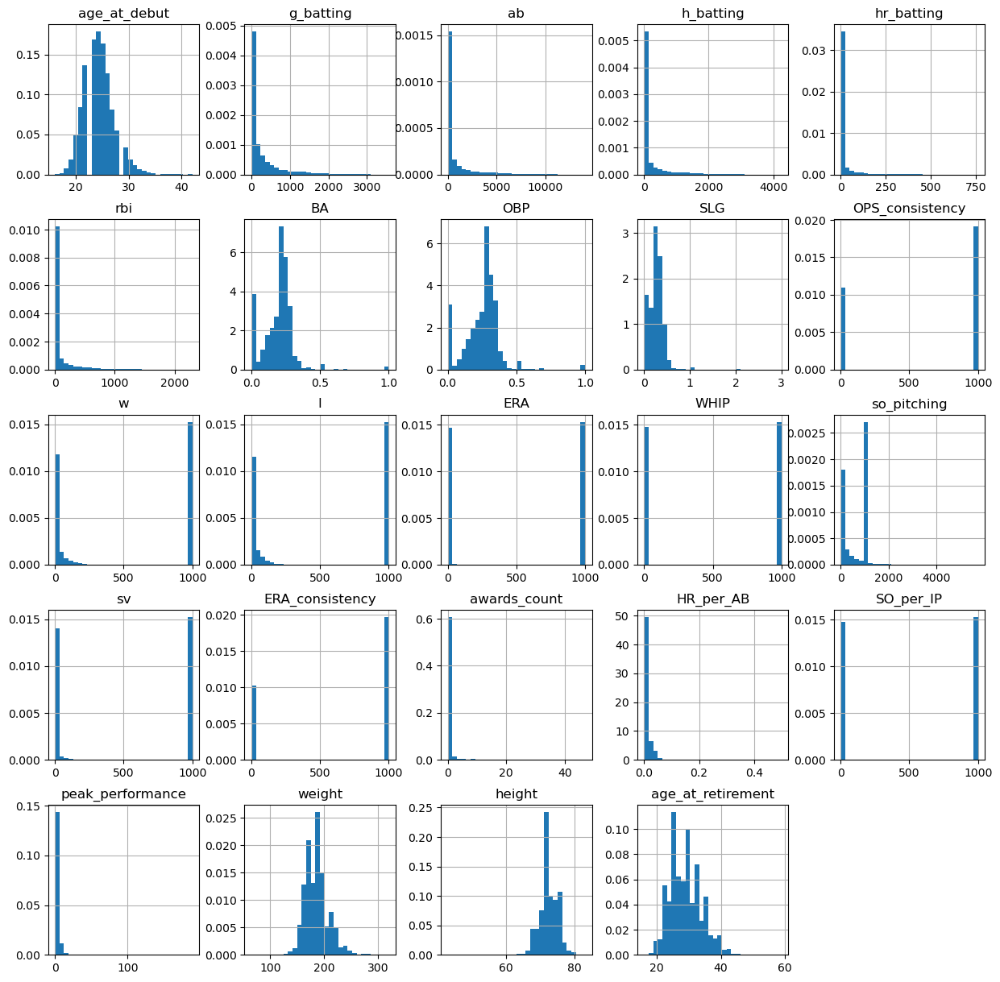

In [137]:
# Visualise the distribution of un-transformed numerical features (after imputation and before transformation), using histogramx
X_train_imputed.hist(bins=30, figsize=(15,15), density=True)
plt.show()

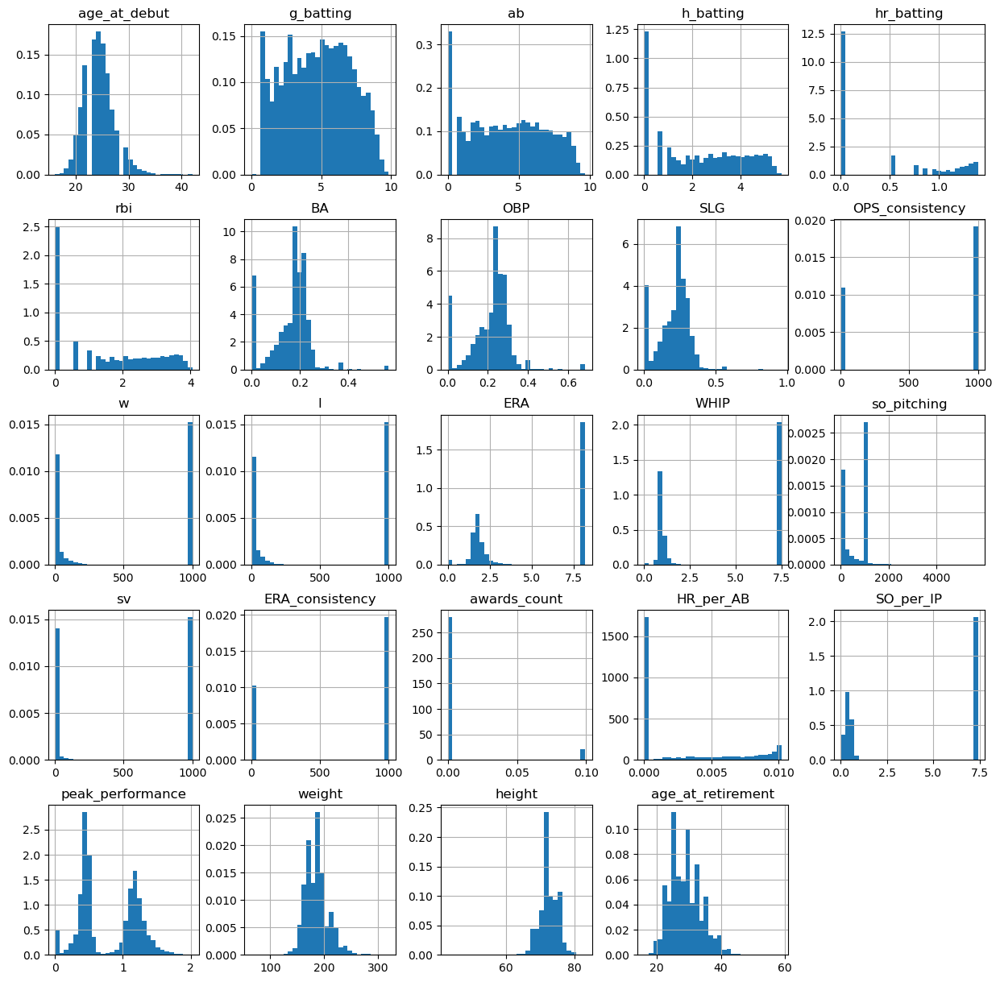

In [138]:
# Visualise the distribution of transformed numerical features (after imputation and transformation), using histograms
X_train_transformed.hist(bins=30, figsize=(15,15), density=True)
plt.show()

In [139]:
# Find numerical variables after imputation and transformation
X_train_transformed_num_cols = [n for n in X_train_transformed.columns if X_train_transformed[n].dtypes!='O']

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




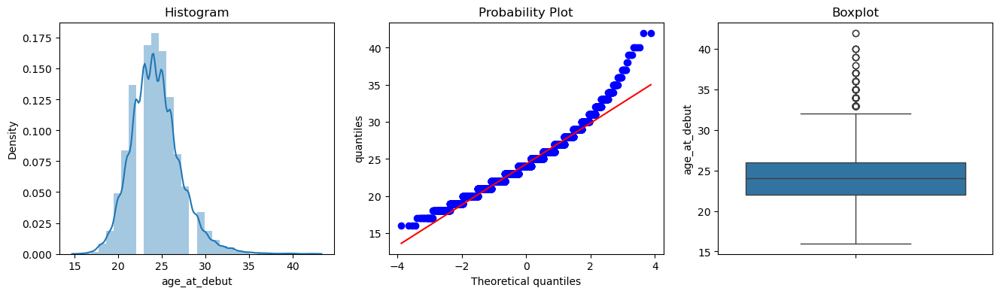

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




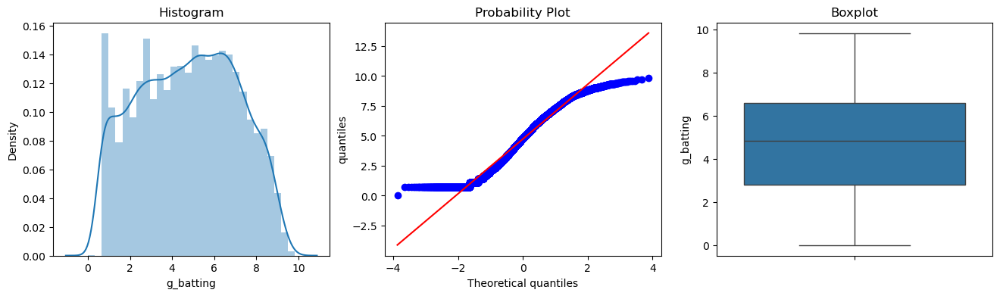

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




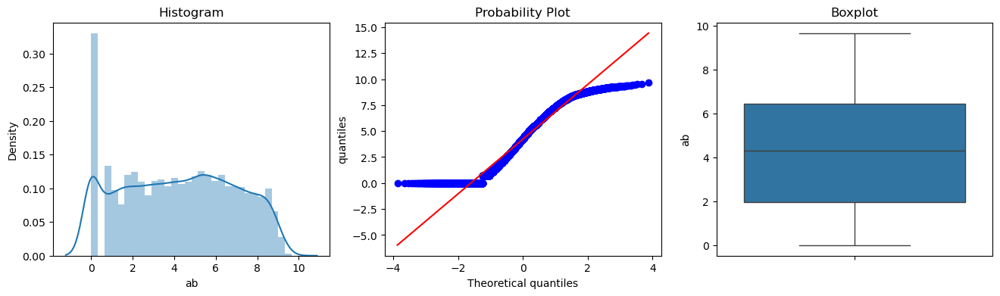

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




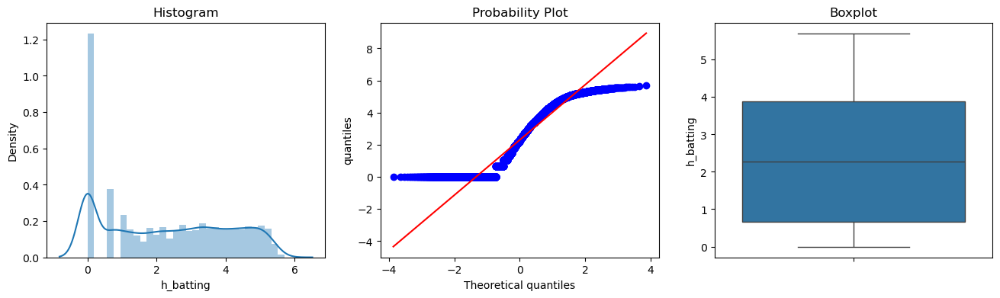

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




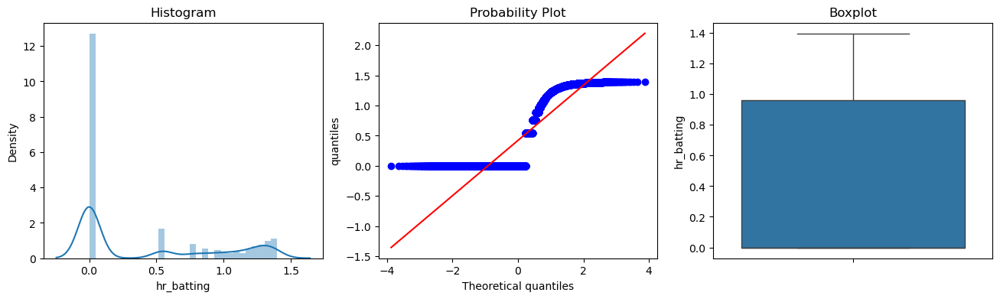

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




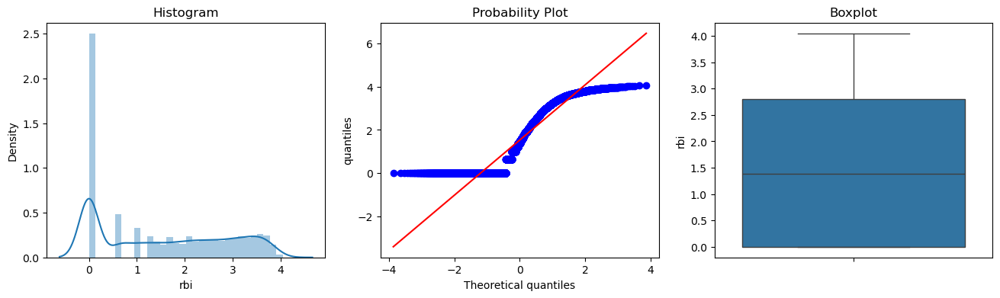

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




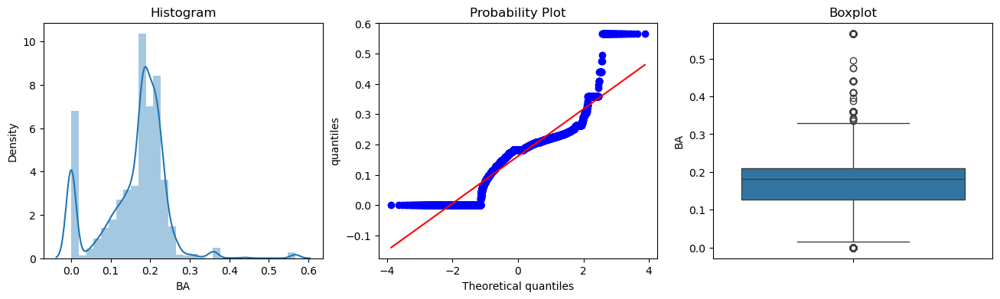

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




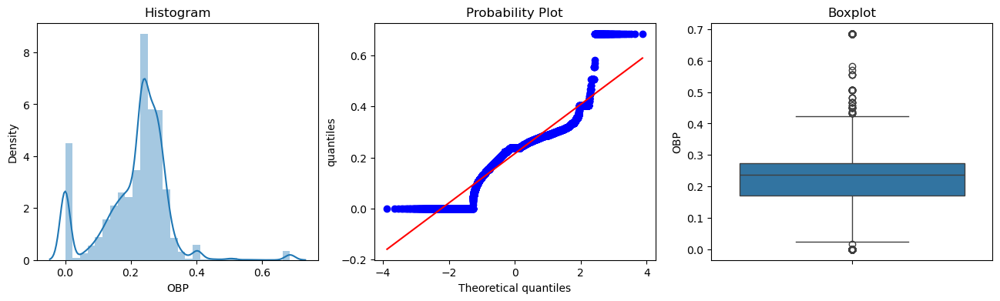

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




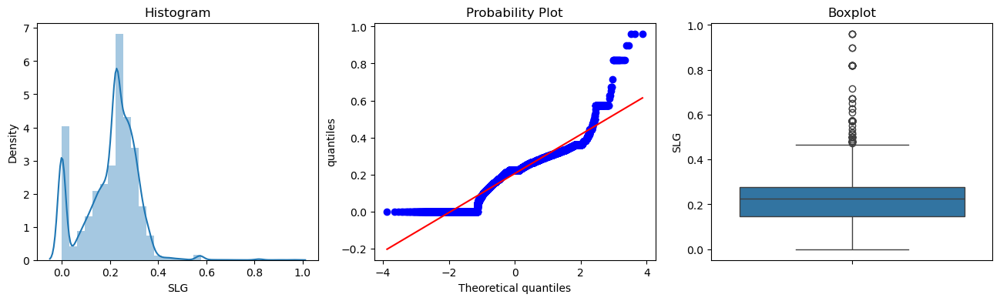

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




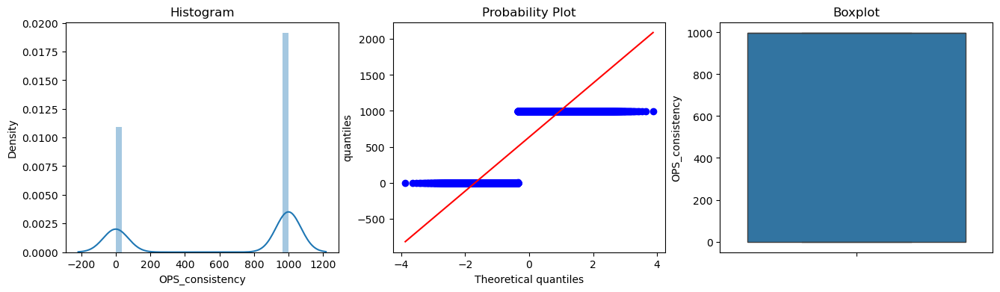

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




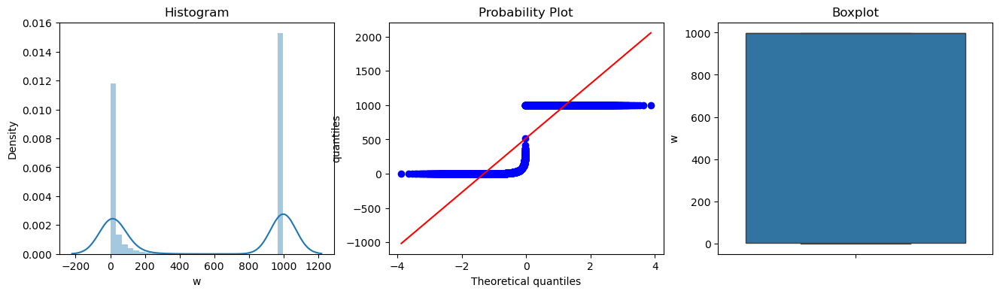

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




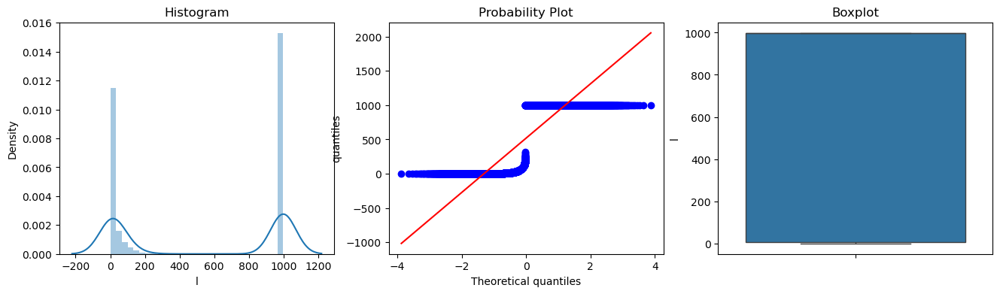

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




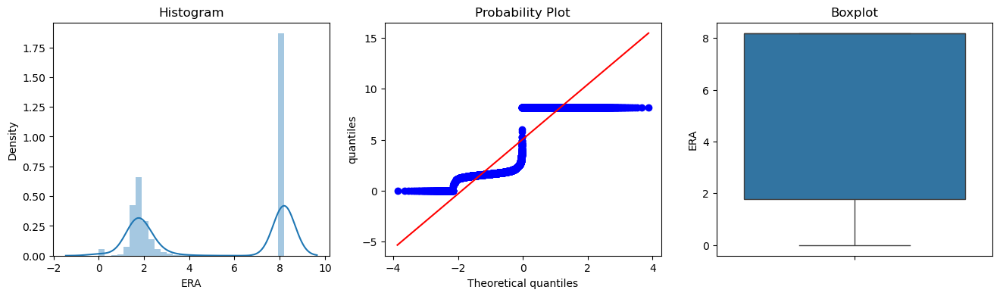

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




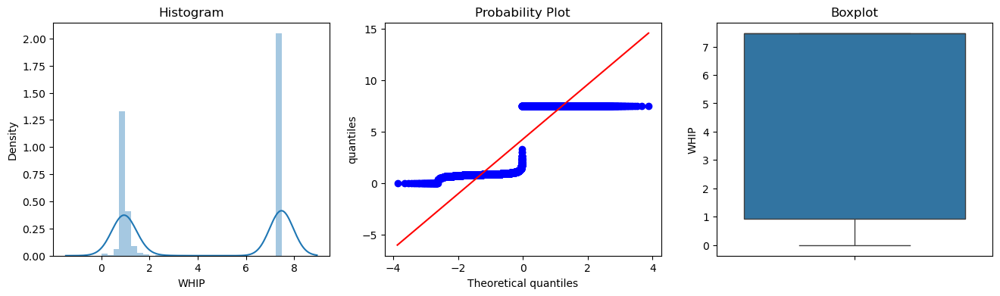

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




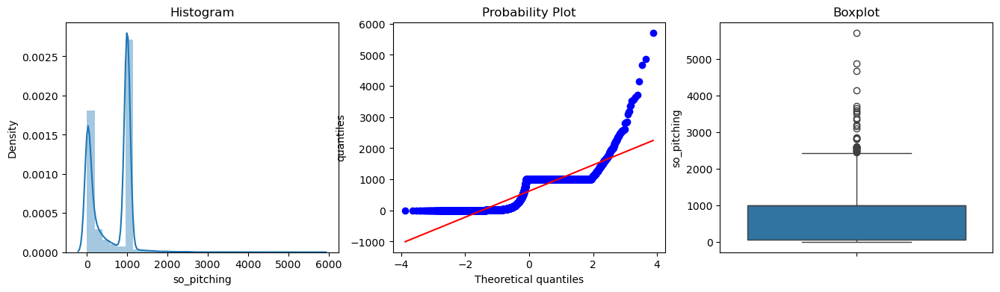

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




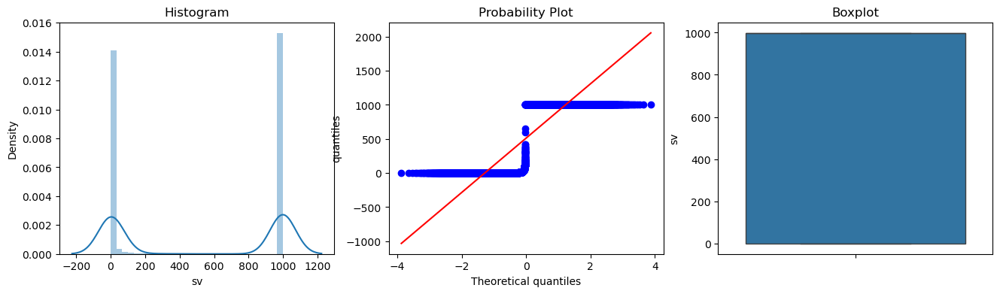

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




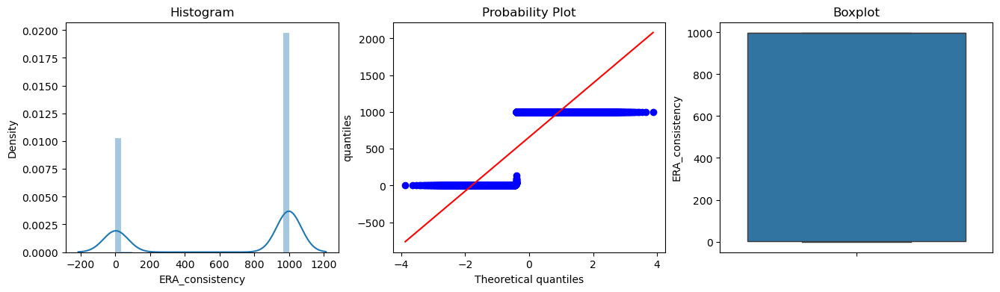

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




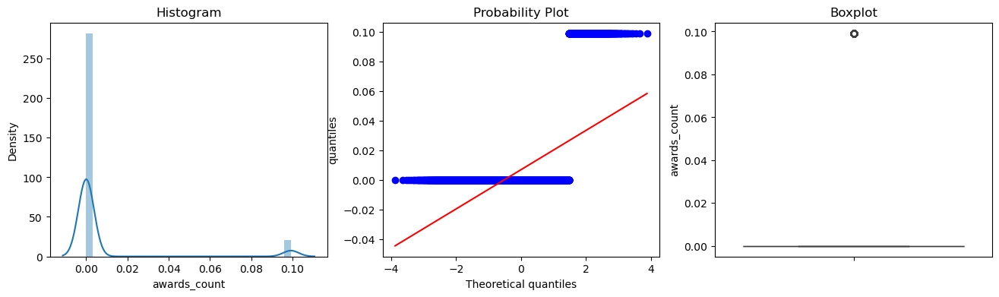

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




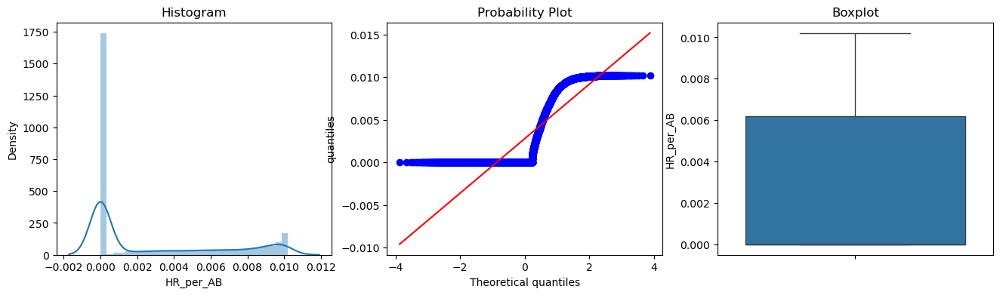

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




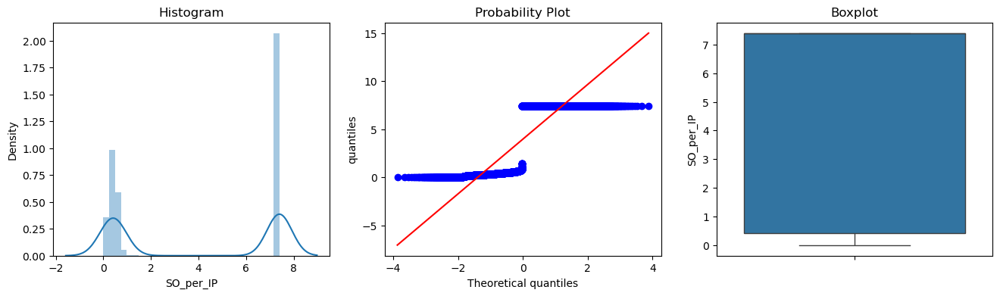

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




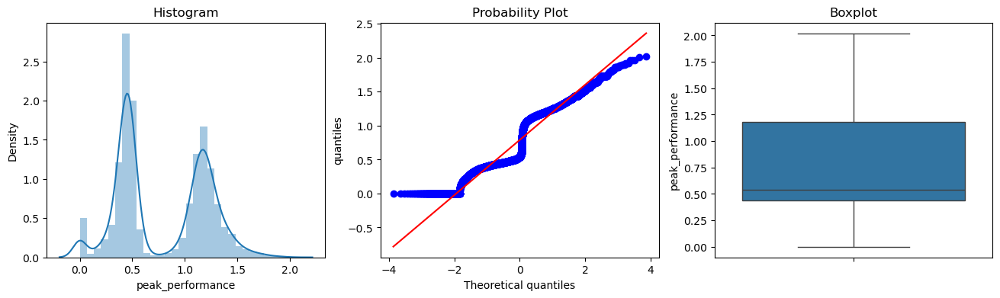

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




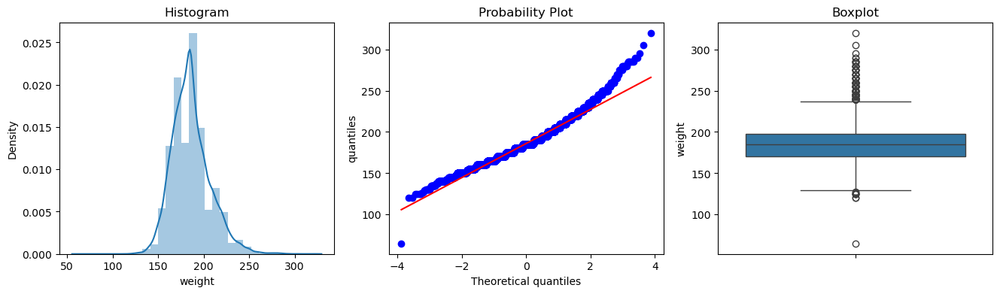

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




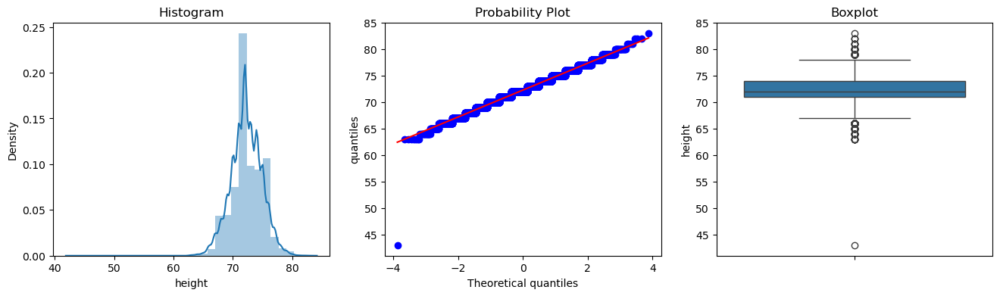

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\2288886072.py:12: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




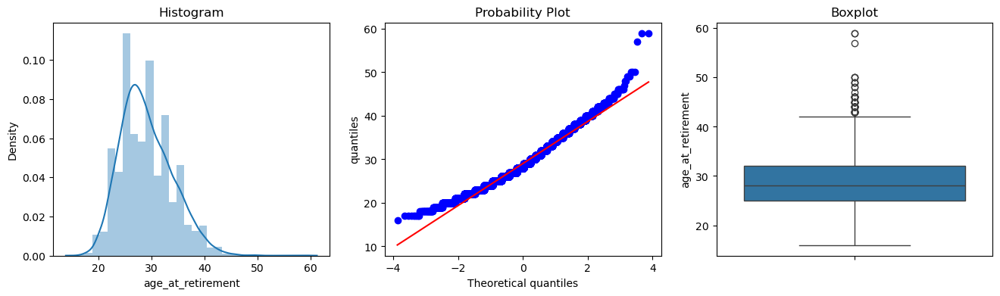

In [140]:
# check transformed distribution
# Detecting outliers using boxplots
for transformed_num_cols in X_train_transformed[X_train_transformed_num_cols]:
    diagnostic_plots(X_train_transformed, transformed_num_cols)

In [141]:
# Calculate and print the skewness of each numerical column before transformation
print("Before Numerical Transformation:")
for before_transformation_column in X_train_imputed[X_train_imputed_num_cols]:
    skewness_before_transformation = X_train_imputed[before_transformation_column].skew()
    display(f"{before_transformation_column}: {skewness_before_transformation}")

Before Numerical Transformation:


'age_at_debut: 0.6715857325709177'

'g_batting: 2.5136231840421757'

'ab: 2.9594370727778068'

'h_batting: 3.2193671319496517'

'hr_batting: 6.00333981332318'

'rbi: 3.7574183917268993'

'BA: 1.559232098917575'

'OBP: 0.9930908272751247'

'SLG: 2.849553619526345'

'OPS_consistency: -0.5667919681351874'

'w: -0.04400317552800979'

'l: -0.04127029474442493'

'ERA: -0.0383494518369128'

'WHIP: -0.03813591041079424'

'so_pitching: 0.26690573600752154'

'sv: -0.03736316683294686'

'ERA_consistency: -0.6619953400979951'

'awards_count: 10.253554792954203'

'HR_per_AB: 11.0237161288075'

'SO_per_IP: -0.03813210673901208'

'peak_performance: 12.574999354803321'

'weight: 0.701961064296313'

'height: -0.1795578547663561'

'age_at_retirement: 0.5522583612704723'

In [142]:
# Calculate and print the skewness of each numerical column after transformation
print("After Numerical Transformation:")
for after_transformation_column in X_train_transformed[X_train_transformed_num_cols]:
    skewness_after_transformation = X_train_transformed[after_transformation_column].skew()
    display(f"{after_transformation_column}: {skewness_after_transformation}")

After Numerical Transformation:


'age_at_debut: 0.6715857325709177'

'g_batting: -0.029106464406893507'

'ab: -0.0024604821345444116'

'h_batting: 0.10864878289823184'

'hr_batting: 0.6856177658377499'

'rbi: 0.21106868353142028'

'BA: -0.054763150517290804'

'OBP: -0.0030947268515434372'

'SLG: -0.0551864118611422'

'OPS_consistency: -0.5667919681351874'

'w: -0.04400317552800979'

'l: -0.04127029474442493'

'ERA: -0.08149383634227085'

'WHIP: -0.04481689441023517'

'so_pitching: 0.26690573600752154'

'sv: -0.03736316683294686'

'ERA_consistency: -0.6619953400979951'

'awards_count: 3.378286034709401'

'HR_per_AB: 0.880626674656945'

'SO_per_IP: -0.042620565039849664'

'peak_performance: 0.14164921981228712'

'weight: 0.701961064296313'

'height: -0.1795578547663561'

'age_at_retirement: 0.5522583612704723'

In [143]:
# Calculate the sum of missing values (NaNs) in each numerical column after transformation
X_train_transformed[X_train_transformed_num_cols].isnull().sum().sort_values()

age_at_debut         0
weight               0
peak_performance     0
SO_per_IP            0
HR_per_AB            0
awards_count         0
ERA_consistency      0
sv                   0
so_pitching          0
WHIP                 0
ERA                  0
l                    0
w                    0
OPS_consistency      0
SLG                  0
OBP                  0
BA                   0
rbi                  0
hr_batting           0
h_batting            0
ab                   0
g_batting            0
height               0
age_at_retirement    0
dtype: int64

### Binning

In [144]:
# Variable binning the continuous 'age_at_debut' variable into specified age ranges.
age_bins = [0, 20, 25, 30]
age_labels = ['young', 'average', 'late']
X_train_transformed['age_at_debut_binned'] = pd.cut(X_train_transformed['age_at_debut'], bins=age_bins, labels=age_labels, right=False)
X_test_transformed['age_at_debut_binned'] = pd.cut(X_test_transformed['age_at_debut'], bins=age_bins, labels=age_labels, right=False)

Categorizes players based on the total number of awards they have received, from none to a substantial number.

In [145]:
# Variable binning the continuous 'age_at_debut' variable into specified age ranges.
awards_bins = [0, 1, 3, 5, 10, 50, 100]
awards_labels = ['none', 'few', 'some', 'moderate', 'many', 'exceptional']
X_train_transformed['awards_count_binned'] = pd.cut(X_train_transformed['awards_count'], bins=awards_bins, labels=awards_labels, right=False)
X_test_transformed['awards_count_binned'] = pd.cut(X_test_transformed['awards_count'], bins=awards_bins, labels=awards_labels, right=False)

In [146]:
X_train_transformed.dtypes

age_at_debut                int32
g_batting                 float64
ab                        float64
h_batting                 float64
hr_batting                float64
rbi                       float64
BA                        float64
OBP                       float64
SLG                       float64
OPS_consistency           float64
w                         float64
l                         float64
ERA                       float64
WHIP                      float64
so_pitching               float64
sv                        float64
ERA_consistency           float64
pos                        object
awards_count              float64
HR_per_AB                 float64
SO_per_IP                 float64
peak_performance          float64
weight                    float64
height                    float64
bats                       object
throws                     object
age_at_retirement           int32
Milestone_Achievement      object
age_at_debut_binned      category
awards_count_b

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\4180922436.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\4180922436.py:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Text(0, 0.5, 'Number of observations per bin')

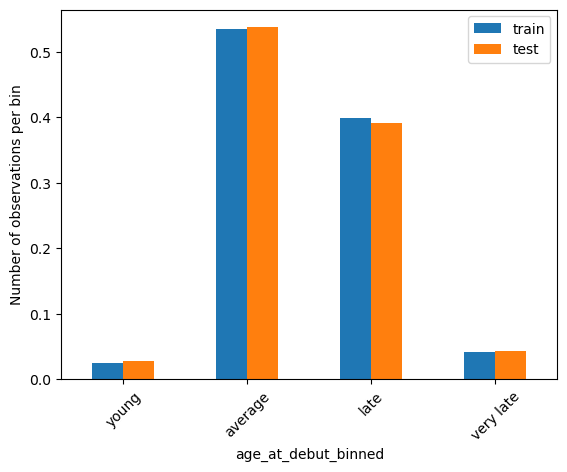

In [147]:
# if the distributions in train and test set are similar, we should expect similar propotion of
# observations in the different intervals in the train and test set

# age_at_debut

t1 = X_train_transformed.groupby(['age_at_debut_binned'])['age_at_debut_binned'].count() / len(X_train_transformed)
t2 = X_test_transformed.groupby(['age_at_debut_binned'])['age_at_debut_binned'].count() / len(X_test_transformed)

tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['train', 'test']
tmp.plot.bar()
plt.xticks(rotation=45)
plt.ylabel('Number of observations per bin')

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\79678514.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\tswr1\AppData\Local\Temp\ipykernel_51148\79678514.py:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Text(0, 0.5, 'Number of observations per bin')

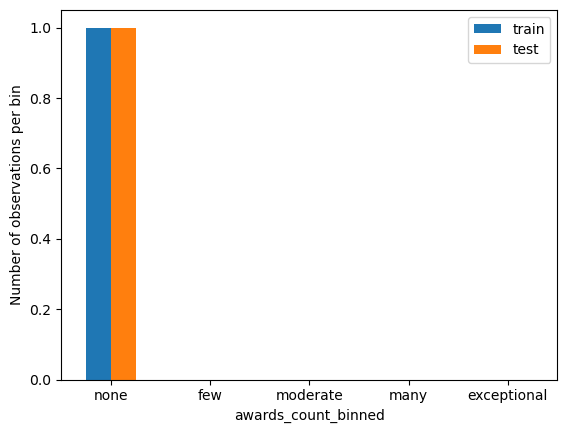

In [148]:
# if the distributions in train and test set are similar, we should expect similar propotion of
# observations in the different intervals in the train and test set

# LSTAT
# calculate proportion of observations per interval
t1 = X_train_transformed.groupby(['awards_count_binned'])['awards_count_binned'].count() / len(X_train_transformed)
t2 = X_test_transformed.groupby(['awards_count_binned'])['awards_count_binned'].count() / len(X_test_transformed)

# concatenate aggregated views
tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['train', 'test']

# plot
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

In [149]:
display(X_train_transformed.info)

<bound method DataFrame.info of        age_at_debut  g_batting        ab  h_batting  hr_batting       rbi  \
1917             26   2.714415  0.693731  -0.000000   -0.000000 -0.000000   
14227            34   0.703765  0.693731  -0.000000   -0.000000 -0.000000   
3037             23   7.159858  7.403333   4.518481    1.055113  3.168140   
6295             25   4.719597  2.203095  -0.000000   -0.000000 -0.000000   
9711             22   2.306309  3.345719   1.488887   -0.000000 -0.000000   
...             ...        ...       ...        ...         ...       ...   
9374             24   6.412839  1.950514   1.041517   -0.000000  0.649393   
13349            23   6.859874  7.200282   4.365155    1.112991  3.180331   
10007            23   6.435119  6.725076   4.155805    1.014154  2.786708   
10980            19   6.986109  6.480165   3.986799    1.134349  2.944580   
2770             19   9.022263  8.993921   5.379022    1.376675  3.837888   

             BA       OBP       SLG  OPS_co

In [150]:
# Percentage of null data in each column of the merged dataset
null_percentages = X_train_transformed.isnull().mean() * 100
null_percentages.sort_values(ascending=True)

age_at_debut             0.0
Milestone_Achievement    0.0
age_at_retirement        0.0
throws                   0.0
bats                     0.0
height                   0.0
weight                   0.0
peak_performance         0.0
SO_per_IP                0.0
HR_per_AB                0.0
awards_count             0.0
pos                      0.0
ERA_consistency          0.0
sv                       0.0
so_pitching              0.0
WHIP                     0.0
ERA                      0.0
l                        0.0
w                        0.0
OPS_consistency          0.0
SLG                      0.0
OBP                      0.0
BA                       0.0
rbi                      0.0
hr_batting               0.0
h_batting                0.0
ab                       0.0
g_batting                0.0
age_at_debut_binned      0.0
awards_count_binned      0.0
dtype: float64

In [151]:
# Find numerical variables after one-hot encoding
X_train_bin_num_cols = [n for n in X_train_transformed.columns if X_train_transformed[n].dtypes!='O']

In [152]:
print(X_train_transformed.dtypes)

age_at_debut                int32
g_batting                 float64
ab                        float64
h_batting                 float64
hr_batting                float64
rbi                       float64
BA                        float64
OBP                       float64
SLG                       float64
OPS_consistency           float64
w                         float64
l                         float64
ERA                       float64
WHIP                      float64
so_pitching               float64
sv                        float64
ERA_consistency           float64
pos                        object
awards_count              float64
HR_per_AB                 float64
SO_per_IP                 float64
peak_performance          float64
weight                    float64
height                    float64
bats                       object
throws                     object
age_at_retirement           int32
Milestone_Achievement      object
age_at_debut_binned      category
awards_count_b

### Categorical Data Encoding

In [153]:
# let's create the encoder
from feature_engine.encoding import OneHotEncoder

ohe_enc = OneHotEncoder(
    
    # to indicate how many top categories
    top_categories=None,  
    
    # we can select which variables to encode
    variables=['pos','throws','bats','Milestone_Achievement','age_at_debut_binned','awards_count_binned'],
    
    # to indicate if we drop one of the binaries
    drop_last=False)

In [154]:
# fit the encoder to the train set: it will learn the variables and 
# categories to encode

ohe_enc.fit(X_train_transformed)

OneHotEncoder(variables=['pos', 'throws', 'bats', 'Milestone_Achievement',
                         'age_at_debut_binned', 'awards_count_binned'])

In [155]:
# we can see which variables the encoder will encode

ohe_enc.variables_

['pos',
 'throws',
 'bats',
 'Milestone_Achievement',
 'age_at_debut_binned',
 'awards_count_binned']

In [156]:
# let's transform train and test set

X_train_enc = ohe_enc.transform(X_train_transformed)
X_test_enc = ohe_enc.transform(X_test_transformed)

In [157]:
# let's inspect the encoded train set

X_train_enc.head()

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,age_at_retirement,pos_P,pos_Missing,pos_C,pos_CF,pos_2B,pos_SS,pos_OF,pos_1B,pos_3B,pos_LF,pos_DH,pos_RF,throws_L,throws_R,throws_Missing,bats_L,bats_R,bats_B,bats_Missing,Milestone_Achievement_None,Milestone_Achievement_300Wins,Milestone_Achievement_500HR,"Milestone_Achievement_3000Hits,500HR",Milestone_Achievement_3000Hits,age_at_debut_binned_late,age_at_debut_binned_very late,age_at_debut_binned_average,age_at_debut_binned_young,awards_count_binned_none
1917,26,2.714415,0.693731,-0.000000,-0.000000,-0.00000,-0.000000,-0.000000,-0.000000,999.0,0.0,1.0,1.793269,0.841643,18.0,0.0,3.304364,-0.0,-0.000000,0.707423,1.199569,190.0,73.0,27,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,1
14227,34,0.703765,0.693731,-0.000000,-0.000000,-0.00000,-0.000000,-0.000000,-0.000000,999.0,999.0,999.0,8.194567,7.476901,999.0,999.0,999.000000,-0.0,-0.000000,7.400093,-0.000000,190.0,72.0,34,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,1
3037,23,7.159858,7.403333,4.518481,1.055113,3.16814,0.211493,0.275174,0.265517,999.0,999.0,999.0,8.194567,7.476901,999.0,999.0,999.000000,-0.0,0.003241,7.400093,0.449389,165.0,68.0,38,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1
6295,25,4.719597,2.203095,-0.000000,-0.000000,-0.00000,-0.000000,-0.000000,-0.000000,0.0,1.0,3.0,1.787821,0.958928,55.0,0.0,0.779150,-0.0,-0.000000,0.531153,1.197244,190.0,72.0,27,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,1
9711,22,2.306309,3.345719,1.488887,-0.000000,-0.00000,0.132547,0.137865,0.132896,999.0,2.0,6.0,1.988108,1.001580,27.0,0.0,999.000000,-0.0,-0.000000,0.348593,1.279042,185.0,71.0,22,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1


In [158]:
# let's inspect the encoded test set

X_test_enc.head()

,age_at_debut,g_batting,ab,h_batting,hr_batting,rbi,BA,OBP,SLG,OPS_consistency,w,l,ERA,WHIP,so_pitching,sv,ERA_consistency,awards_count,HR_per_AB,SO_per_IP,peak_performance,weight,height,age_at_retirement,pos_P,pos_Missing,pos_C,pos_CF,pos_2B,pos_SS,pos_OF,pos_1B,pos_3B,pos_LF,pos_DH,pos_RF,throws_L,throws_R,throws_Missing,bats_L,bats_R,bats_B,bats_Missing,Milestone_Achievement_None,Milestone_Achievement_300Wins,Milestone_Achievement_500HR,"Milestone_Achievement_3000Hits,500HR",Milestone_Achievement_3000Hits,age_at_debut_binned_late,age_at_debut_binned_very late,age_at_debut_binned_average,age_at_debut_binned_young,awards_count_binned_none
896,24,8.260844,8.355942,5.060860,1.269824,3.589183,0.227861,0.311215,0.292628,999.00000,999.0,999.0,8.194567,7.476901,999.0,999.0,999.000000,-0.0,0.004738,7.400093,0.492363,168.0,67.0,32,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1
13648,24,5.651201,6.401870,3.730788,-0.000000,2.686479,0.157328,0.186851,0.189287,999.00000,999.0,999.0,8.194567,7.476901,999.0,999.0,999.000000,-0.0,-0.000000,7.400093,0.329151,166.0,67.0,31,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1
4374,22,4.542422,3.910264,1.643212,-0.000000,0.649393,0.096186,0.115313,0.096368,1.09626,9.0,14.0,1.742011,0.902066,94.0,1.0,2.974529,-0.0,-0.000000,0.387267,1.177463,175.0,71.0,28,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1
12957,21,3.200931,4.164042,2.516942,-0.000000,1.626365,0.225427,0.267189,0.268934,999.00000,5.0,8.0,2.023474,1.023037,24.0,1.0,5.765982,-0.0,-0.000000,0.164645,1.292730,200.0,74.0,29,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1
18844,22,6.738462,7.217908,4.480023,1.286214,3.343569,0.232286,0.299695,0.328115,999.00000,999.0,999.0,8.194567,7.476901,999.0,999.0,999.000000,-0.0,0.009154,7.400093,0.512002,160.0,66.0,28,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1


In [159]:
# Percentage of null data in each column of the merged dataset
null_percentages = X_train_enc.isnull().mean() * 100
null_percentages.sort_values(ascending=True)

age_at_debut                            0.0
pos_2B                                  0.0
pos_SS                                  0.0
pos_OF                                  0.0
pos_1B                                  0.0
pos_3B                                  0.0
pos_LF                                  0.0
pos_DH                                  0.0
pos_RF                                  0.0
throws_L                                0.0
throws_R                                0.0
throws_Missing                          0.0
bats_L                                  0.0
bats_R                                  0.0
bats_B                                  0.0
bats_Missing                            0.0
Milestone_Achievement_None              0.0
Milestone_Achievement_300Wins           0.0
Milestone_Achievement_500HR             0.0
Milestone_Achievement_3000Hits,500HR    0.0
Milestone_Achievement_3000Hits          0.0
age_at_debut_binned_late                0.0
age_at_debut_binned_very late   

### Outliers Removal Capping

No Outlier Removal Capping implemented, why....

### Feature Scaling

In [160]:
# standardisation: with the StandardScaler from sklearn

# set up the scaler
scaler = StandardScaler()

# fit the scaler to the train set, it will learn the parameters
scaler.fit(X_train_enc)

# Fit the scaler on the training data and transform both training and test data
X_train_scaled = X_train_enc.copy()
X_test_scaled = X_test_enc.copy()

# transform train and test sets
X_train_scaled = scaler.transform(X_train_enc)
X_test_scaled = scaler.transform(X_test_enc)

In [161]:
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_enc.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_enc.columns)

In [162]:
X_train_scaled.dtypes

age_at_debut                            float64
g_batting                               float64
ab                                      float64
h_batting                               float64
hr_batting                              float64
rbi                                     float64
BA                                      float64
OBP                                     float64
SLG                                     float64
OPS_consistency                         float64
w                                       float64
l                                       float64
ERA                                     float64
WHIP                                    float64
so_pitching                             float64
sv                                      float64
ERA_consistency                         float64
awards_count                            float64
HR_per_AB                               float64
SO_per_IP                               float64
peak_performance                        

In [163]:
y_train.dtype

dtype('float64')

In [164]:
# Find numerical variables after one-hot encoding
X_train_scaled_num_cols = [n for n in X_train_scaled.columns if X_train_scaled[n].dtypes!='O']

In [165]:
# Percentage of null data in each column of the merged dataset
null_percentages = X_train_scaled.isnull().mean() * 100
null_percentages.sort_values(ascending=True)

age_at_debut                            0.0
pos_2B                                  0.0
pos_SS                                  0.0
pos_OF                                  0.0
pos_1B                                  0.0
pos_3B                                  0.0
pos_LF                                  0.0
pos_DH                                  0.0
pos_RF                                  0.0
throws_L                                0.0
throws_R                                0.0
throws_Missing                          0.0
bats_L                                  0.0
bats_R                                  0.0
bats_B                                  0.0
bats_Missing                            0.0
Milestone_Achievement_None              0.0
Milestone_Achievement_300Wins           0.0
Milestone_Achievement_500HR             0.0
Milestone_Achievement_3000Hits,500HR    0.0
Milestone_Achievement_3000Hits          0.0
age_at_debut_binned_late                0.0
age_at_debut_binned_very late   

## Step 7: Machine Learning Modelling

### Naive Baseline Model

In [166]:
import numpy as np
from scipy import stats

# pick the mean target value from all of train data
print(y_train.mean())

mean_target_value = y_train.mean()

print(f"The train mean target value is {mean_target_value:.2f}.")

4.805559618105836
The train mean target value is 4.81.


In [167]:
y_train_preds_naive = [round(mean_target_value,2) for row in X_train_scaled.iloc[:,0]]
y_train_preds_naive[0:5]

[4.81, 4.81, 4.81, 4.81, 4.81]

In [168]:
# insert code here
y_test_preds_naive = [round(mean_target_value,2) for row in X_test_scaled.iloc[:,0]]
y_test_preds_naive[0:5]

[4.81, 4.81, 4.81, 4.81, 4.81]

In [169]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Mean Squared Error (the lower the better, 0 is best possible score)

# train MSE score
y_true = y_train
y_pred = y_train_preds_naive

train_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on train data is {train_mse_naive:.2f}.")

# test MSE score
y_true = y_test
y_pred = y_test_preds_naive

test_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on test data is {test_mse_naive:.2f}.")

print()

# Root Mean Squared Error (if MSE < 1, rooting it makes it numerically larger, vice-versa if MSE > 1)

# train RMSE score
y_true = y_train
y_pred = y_train_preds_naive

train_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on train data is {train_rmse_naive:.2f}.")

# test RMSE score
y_true = y_test
y_pred = y_test_preds_naive

test_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on test data is {test_rmse_naive:.2f}.")

print()

# R2 Value (Coefficient of Determination, which measures how well the X cols account for y's variance, 1.0 is best score)

# train R2 score
y_true = y_train
y_pred = y_train_preds_naive

train_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on train data is {train_r2_naive:.2f}.")

# test R2 score
y_true = y_test
y_pred = y_test_preds_naive

test_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on test data is {test_r2_naive:.2f}.")

The Naive Baseline Model's MSE on train data is 25.01.
The Naive Baseline Model's MSE on test data is 25.93.

The Naive Baseline Model's RMSE on train data is 5.00.
The Naive Baseline Model's RMSE on test data is 5.09.

The Naive Baseline Model's R2 on train data is -0.00.
The Naive Baseline Model's R2 on test data is -0.00.


C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.

C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.



### Linear Regression

In [170]:
from sklearn.linear_model import LinearRegression

linreg = LinearRegression().fit(X_train_scaled, y_train)

In [171]:
y_train_preds_linreg = linreg.predict(X_train_scaled)
y_test_preds_linreg = linreg.predict(X_test_scaled)

In [172]:
# Mean Squared Error (the lower the better, 0 is best possible score)

# train MSE score
y_true = y_train
y_pred = y_train_preds_linreg

train_mse_linreg = mean_squared_error(y_true, y_pred)
print(f"The LinReg Model's MSE on train data is {train_mse_linreg:.4f}.")

# test MSE score
y_true = y_test
y_pred = y_test_preds_linreg

test_mse_linreg = mean_squared_error(y_true, y_pred)
print(f"The LinReg Model's MSE on test data is {test_mse_linreg:.4f}.")

print()

# Root Mean Squared Error (if MSE < 1, rooting it makes it numerically larger, vice-versa if MSE > 1)

# train RMSE score
y_true = y_train
y_pred = y_train_preds_linreg

train_rmse_linreg = mean_squared_error(y_true, y_pred, squared=False)
print(f"The LinReg Model's RMSE on train data is {train_rmse_linreg:.4f}.")

# test RMSE score
y_true = y_test
y_pred = y_test_preds_linreg

test_rmse_linreg = mean_squared_error(y_true, y_pred, squared=False)
print(f"The LinReg Model's RMSE on test data is {test_rmse_linreg:.4f}.")

print()

# R2 Value (Coefficient of Determination, which measures how well the X cols account for y's variance, 1.0 is best score)

# train R2 score
y_true = y_train
y_pred = y_train_preds_linreg

train_r2_linreg = r2_score(y_true, y_pred)
print(f"The LinReg Model's R2 on train data is {train_r2_linreg:.4f}.")

# test R2 score
y_true = y_test
y_pred = y_test_preds_linreg

test_r2_linreg = r2_score(y_true, y_pred)
print(f"The LinReg Model's R2 on test data is {test_r2_linreg:.4f}.")

# MSE varies based on the context and nature of the dataset
# but R^2 can be compared among models

######################################################################################
# TESTING WITH MULTIPLE MODELS, IMPLEMENTATIONS, AND MODEL RESULTS
######################################################################################
# MODEL 1, The first model i tested was when i chose not to transform AwardsCount 
# and Peak_Performance even though they had a very skewed distribution:

# MODEL 1 RESULTS:
# The LinReg Model's MSE on train data is 0.6254.
# The LinReg Model's MSE on test data is 0.6572.

# The LinReg Model's RMSE on train data is 0.7908.
# The LinReg Model's RMSE on test data is 0.8107.

# The LinReg Model's R2 on train data is 0.9750.
# The LinReg Model's R2 on test data is 0.9746.

######################################################################################
# MODEL 2, The second model I tested With Outlier Handling and Capping implemented:

# MODEL 2 RESULTS:
# The LinReg Model's MSE on train data is 0.7201.
# The LinReg Model's MSE on test data is 0.7646.

# The LinReg Model's RMSE on train data is 0.8486.
# The LinReg Model's RMSE on test data is 0.8744.

# The LinReg Model's R2 on train data is 0.9712.
# The LinReg Model's R2 on test data is 0.9705.

########################################################################################
# MODEL 3, The third model I tested with EqualWidthDiscretiser and
# EqualFrequencyDiscretiser (Automated Binning) instead of Manual Binning (what was chosen to be implemented):

# MODEL 3 RESULTS:
# The LinReg Model's MSE on train data is 0.6251.
# The LinReg Model's MSE on test data is 0.6557.

# The LinReg Model's RMSE on train data is 0.7907.
# The LinReg Model's RMSE on test data is 0.8098.

# The LinReg Model's R2 on train data is 0.9750.
# The LinReg Model's R2 on test data is 0.9747.


# This is the code used for Automated Binning below ↓↓:
# disc = EqualFrequencyDiscretiser(
#     q=10, variables=['age_at_debut'], return_object=True)
# disc.fit(X_train_transformed)

# # transform train and test
# X_train_binned_1stPart = disc.transform(X_train_transformed)
# X_test_binned_1stPart = disc.transform(X_test_transformed)

# from feature_engine.discretisation import EqualWidthDiscretiser
# disc = EqualWidthDiscretiser(bins=10, variables = ['AwardsCount'])
# disc.fit(X_train_binned_1stPart)
# # the limits of the intervals are stored in the binner_dict_
# disc.binner_dict_

# # transform train and test sets
# X_train_binned = disc.transform(X_train_binned_1stPart)
# X_test_binned = disc.transform(X_test_binned_1stPart)


########################################################################################
# MODEL 4, The third model I tested with PCA but decided not to use PCA 
# (decided not to use PCA because the test results didnt improve, and no purpose of PCA):

# MODEL 4 RESULTS:
# The LinReg Model's MSE on train data is 0.0378.
# The LinReg Model's MSE on test data is 0.0379.

# The LinReg Model's RMSE on train data is 0.1944.
# The LinReg Model's RMSE on test data is 0.1947.

# The LinReg Model's R2 on train data is 0.9985.
# The LinReg Model's R2 on test data is 0.9985.


# # This is the code used for PCA below ↓↓:
# # set up the PCA
# pca = PCA()

# # train the PCA
# pca.fit(X_train_scaled)

# # create the principal components
# X_train_pca = pca.transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # show the variance explanation for each Principal Component
# print(len(pca.explained_variance_ratio_))
# print(pca.explained_variance_ratio_)

# # determine the number of informative components
# # the number of components is determined by the change
# # in the decay in the percentage of variance explained
# # by each component
# plt.plot(pca.explained_variance_ratio_, linewidth=2)
# plt.title('Percentage of Variance Explained')
# plt.xlabel('Index Number of Components')
# plt.ylabel('Percentage of Variance Explained')

# X_train_pca

The LinReg Model's MSE on train data is 0.0378.
The LinReg Model's MSE on test data is 0.0379.

The LinReg Model's RMSE on train data is 0.1944.
The LinReg Model's RMSE on test data is 0.1947.

The LinReg Model's R2 on train data is 0.9985.
The LinReg Model's R2 on test data is 0.9985.


C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.

C:\Users\tswr1\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.



### Create dataframe with Linear Regression model data and results

In [174]:
df_linReg=pd.DataFrame(X_test_enc)
df_linReg['prediction_linReg']=y_test_preds_linreg
df_linReg['ID']=[final_data['player_id'][index] for index in df_linReg.reset_index()['index']]
df_linReg['pos']=[final_data['pos'][index] for index in df_linReg.reset_index()['index']]
df_linReg['career_length']=[final_data['career_length'][index] for index in df_linReg.reset_index()['index']]
df_linReg = df_linReg[['ID','ab','rbi','pos','career_length','prediction_linReg']]
df_linReg

,ID,ab,rbi,pos,career_length,prediction_linReg
896,batesjo02,8.355942,3.589183,OF,8.495551,8.231152
13648,powerph01,6.401870,2.686479,C,6.986995,7.150610
4374,dixonto01,3.910264,0.649393,P,6.149213,6.002725
12957,parkedo01,4.164042,1.626365,P,7.942505,7.886741
18844,zwilldu01,7.217908,3.343569,OF,5.911020,6.161448
...,...,...,...,...,...,...
16572,surhobj01,9.118525,3.882126,OF,18.485969,18.032673
3928,davalyo01,4.097787,0.991410,SS,0.060233,0.117383
15378,sentepa01,5.312077,2.116335,OF,1.040383,1.178597
13452,piktuge01,0.000000,-0.000000,P,0.008214,0.043202


In [178]:
df_linReg['excess']=df_linReg['prediction_linReg']-df_linReg['career_length']
df_linReg.sort_values(by='excess')

,ID,ab,rbi,pos,career_length,prediction_linReg,excess
11631,minosmi01,8,3,OF,31.463381,30.766326,-0.697055
12736,orourji01,9,3,C,32.405202,31.783789,-0.621413
17570,vizquom01,9,3,SS,23.501711,22.972915,-0.528796
12931,papajo01,0,0,P,1.431896,0.909486,-0.522410
6857,halldi01,6,2,P,19.444216,18.922656,-0.521560
...,...,...,...,...,...,...,...
2713,castipe01,7,3,3B,6.622861,7.206729,0.583868
3384,coonebi01,3,0,2B,0.607803,1.195336,0.587534
10894,mccarle01,7,3,C,7.619439,8.210908,0.591469
4759,eastelu01,7,3,1B,4.728268,5.321518,0.593250


In [179]:
# Define the limit for excess in years
limit = -1.0  # Set your desired limit here

# Identify which rows exceed the limit
df_linReg['exceeds_limit'] = df_linReg['excess'] < limit

# Count how many predictions exceed the limit
exceed_count = df_linReg['exceeds_limit'].sum()

# Display the DataFrame sorted by excess
df_linReg_sorted = df_linReg.sort_values(by='excess')

print(f"Number of predictions exceeding the excess prediction limit of {limit} years: {exceed_count}")
display(df_linReg_sorted)

Number of predictions exceeding the excess prediction limit of -1.0 years: 0


,ID,ab,rbi,pos,career_length,prediction_linReg,excess,exceeds_limit
11631,minosmi01,8,3,OF,31.463381,30.766326,-0.697055,False
12736,orourji01,9,3,C,32.405202,31.783789,-0.621413,False
17570,vizquom01,9,3,SS,23.501711,22.972915,-0.528796,False
12931,papajo01,0,0,P,1.431896,0.909486,-0.522410,False
6857,halldi01,6,2,P,19.444216,18.922656,-0.521560,False
...,...,...,...,...,...,...,...,...
2713,castipe01,7,3,3B,6.622861,7.206729,0.583868,False
3384,coonebi01,3,0,2B,0.607803,1.195336,0.587534,False
10894,mccarle01,7,3,C,7.619439,8.210908,0.591469,False
4759,eastelu01,7,3,1B,4.728268,5.321518,0.593250,False


In [180]:
df_linReg.style.format({'prediction_linReg': "{0:,.2f}",'careerLength': "{0:,.2f}",'excess': "{0:,.2f}"})
df_linReg = df_linReg.astype({"ab": int,"rbi": int}) 
df_linReg

,ID,ab,rbi,pos,career_length,prediction_linReg,excess,exceeds_limit
896,batesjo02,8,3,OF,8.495551,8.231152,-0.264399,False
13648,powerph01,6,2,C,6.986995,7.150610,0.163615,False
4374,dixonto01,3,0,P,6.149213,6.002725,-0.146488,False
12957,parkedo01,4,1,P,7.942505,7.886741,-0.055765,False
18844,zwilldu01,7,3,OF,5.911020,6.161448,0.250428,False
...,...,...,...,...,...,...,...,...
16572,surhobj01,9,3,OF,18.485969,18.032673,-0.453295,False
3928,davalyo01,4,0,SS,0.060233,0.117383,0.057150,False
15378,sentepa01,5,2,OF,1.040383,1.178597,0.138213,False
13452,piktuge01,0,0,P,0.008214,0.043202,0.034988,False


In [181]:
type(df_linReg.style.format({'prediction_linReg': "{0:,.2f}",'careerLength': "{0:,.2f}",'excess': "{0:,.2f}"})
)

pandas.io.formats.style.Styler

### Evaluate Model

In [182]:
abs(df_linReg['excess']).mean()

0.149324829005257

In [183]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(df_linReg['career_length'], df_linReg['prediction_linReg'])

0.149324829005257

In [184]:
print(f"MAE score of Linear Regression Model: {mean_absolute_error(df_linReg['career_length'], df_linReg['prediction_linReg'])} years.")

MAE score of Linear Regression Model: 0.149324829005257 years.


In [185]:
df_linReg['career_length'].mean()

4.974989819310473

In [186]:
df_linReg['career_length'].median()

3.3648186173853527

In [ ]:
# # Download the dataframe with Linear Regression model data and results (uncomment if you want to download the test results)
# df_linReg.to_csv('LinearRegPredictiveResults')

## Report Section

## Report Table of Contents
* [Introduction with Value Based Problem Statement](#Introduction-with-Value-Based-Problem-Statement)
* [Introduction to my role](#Introduction-to-my-role)
* [Stakeholder](#Stakeholder)
* [Problem Formulation](#Problem-Formulation)
    * [Load and Explore Data](#Load-and-Explore-Data)
        * [Loading Data from CSV Files](#Loading-Data-from-CSV-Files)
    * [Understand the Data](#Load-and-Explore-Data)
    * [Formulate a Prediction Problem](#Formulate-a-Prediction-Problem)    
* [Data Wrangling on multiple tables](#Data-Wrangling-on-multiple-tables)
    * [Concatenate, Merge or Join the table](#Concatenate,-Merge-or-Join-the-table)
    * [Extract and Create features from different tables](#Extract-and-Create-features-from-different-tables)
* [Data Cleansing and Transformation](#Data-Cleansing-and-Transformation)
    * [Handling Missing Values](#Handling-Missing-Values)
    * [Numerical Data Transformation](#Numerical-Data-Transformation)
    * [Binning](#Binning)       
    * [Categorical Data Encoding](#Categorical-Data-Encoding)    
    * [Outliers Removal/Capping](#Outliers-Removal-Capping)
    * [Feature Scaling](#Feature-Scaling)
* [Model Building](#Model-Building)
    * [Naive Baseline Model](#Naive-Baseline-Model)
    * [Simple Machine Learning Model](#Simple-Machine-Learning-Model)
    * [Model Evaluation](#Model-Evaluation)
    * [Model Comparison](#Model-Comparison)
* [Conclusion](#Conclusion)
    * [Summary of Findings](#Summary-of-Findings)
    * [Further Improvements](#Further-Improvements)

## Introduction with Value Based Problem Statement

In the realm of Major League Baseball, one of the most significant challenges is understanding the factors that contribute to a player's career longevity is of paramount importance. And the ability to predict how long a player will remain active can provide valuable insights for team management agencies, coaches, and players alike. This knowledge not only aids in player development and management but also enhances strategic decision-making regarding recruitment and investment in talent.

This report addresses the challenge of developing a predictive model that forecasts a player's career longevity based on a range  of influential factors. Utilizing the comprehensive Lahman Baseball Database, we will analyze a diverse array of variables, including demographic information, career timing, batting and pitching metrics, physical attributes, awards and recognition, positional play, and milestone achievements. By leveraging these factors, we aim to create a robust model that can identify patterns and correlations that contribute to a player's sustained success in the league.

The significance of this predictive model extends beyond mere statistics; it holds the potential to revolutionize how teams approach player management and career planning. By understanding the predictors of longevity, team management organisations can make informed decisions that enhance team performance and player satisfaction. Furthermore, this analysis can benefit players themselves, offering insights into the attributes and behaviors that may extend their careers, ultimately contributing to the overall growth and excitement of the sport.

## Introduction to my role

My role here is a data analyst from DataGoal Analytics, a sports analytics company. And as a data analyst, my primary responsibility is to develop a predictive model that can predict a player’s career longevity based on
various factors such as their demographic and career timing, batting metrics, pitching metrics, physical attributes, awards and recognition, position and playing style, milestone achievement indicators using the Lahman Baseball Database. This involves leveraging historical performance data from multiple sources, performing data wrangling and cleansing, and building machine learning models to make precise predictions. My role also includes evaluating the model’s performance and providing actionable insights based on the results.

## Stakeholder

The stakeholders for this project is team management agencies, which play a crucial role in the professional sports landscape. I hope to address the interests and needs of my stakeholders by developing a predictive model that helps to enhances their decision-making capabilities.

Team management companies rely on predictions to evaluate player performance and make strategic decisions regarding player acquisitions and matchups. By understanding the factors that contribute to a player's career longevity, these companies can better assess which players are likely to deliver consistent performance over time. This insight is particularly valuable when selecting players for their rosters, as it enables them to maximize their chances of success in competitive environments, such as fantasy leagues or actual team lineups.

These predictions will not only help team management companies make informed decisions about player selection but also enhance their overall strategy. 

## Problem Formulation

### Load and Explore Data

#### Loading Data from CSV Files

In this section, I loaded five datasets from CSV files into separate DataFrames using the pandas library. 

The people demographics DataFrame contains 18,846 rows and 24 columns, detailing various player attributes such as identifiers (player_id, name_first, name_last, name_given), birth information (with significant missing values), death information (all with substantial missing values), physical attributes (weight, height), and career details (bats, throws, debut, final_game, retro_id, bbref_id), providing a comprehensive view of player demographics and career timelines. 

The batting DataFrame consists of 101,332 rows and 22 columns, capturing performance metrics like g (games played), ab (at-bats), r (runs), h (hits), and hr (home runs), along with demographic and career information, enabling in-depth analysis of player performance. 

The pitching DataFrame, with 44,139 rows and 30 columns, details pitcher performance metrics such as w (wins), l (losses), g (games played), and advanced metrics like era and baopp, facilitating detailed analyses of pitcher effectiveness. 

The fielding DataFrame has 170,526 rows and 18 columns, focusing on fielding performance metrics like pos, g, gs, and advanced metrics (many with missing data), allowing for thorough analysis of fielding effectiveness. 

Lastly, the awards DataFrame consists of 6,078 rows and 6 columns, capturing player achievements with identifiers (player_id, award_id, year, league_id) and additional information about ties and notes, enabling analysis of player recognition across different leagues and years.

### Understand the Data 

The descriptive statistics for the people DataFrame provide valuable insights into the characteristics of the players. The average birth year is approximately 1930, with a standard deviation of about 41 years, indicating a wide range from 1820 to 1995. The average birth month is around June (6.63), suggesting a relatively even distribution across the year, while the average birth day is approximately 15.61, reflecting a clustering around the middle of the month. The average death year is around 1963, with a standard deviation of 31.51 years, and the earliest recorded death year is 1872, with the latest being 2016. The average weight of players is approximately 186 pounds, with a standard deviation of 21.23 pounds, and weights range from 65 pounds to 320 pounds, indicating a wide variety of player sizes. The average height is about 72.26 inches (approximately 6 feet), with a minimum height of 43 inches and a maximum of 83 inches (approximately 6 feet 11 inches), highlighting diversity among players. These statistics reveal trends such as a long history of player participation, seasonal clustering of birth and death months, and significant variation in physical attributes, providing a foundational understanding of the dataset for further analysis and modeling.

The descriptive statistics for the batting DataFrame, which includes 101,332 observations, provide a comprehensive overview of player statistics across various metrics. The average year of play is approximately 1963, with a standard deviation of 38.63 years, indicating a broad historical range of player participation from 1871 to 2015. Players participated in an average of 51.4 games per season, with a maximum of 165 games recorded. The average number of at-bats (ab) is approximately 149.97, with a maximum of 716, while the average runs scored (r) is about 19.89, peaking at 192. The dataset shows significant variability in performance metrics, as evidenced by the high standard deviation for at-bats (186.56) and runs scored (28.67), suggesting a wide range of player contributions. Notably, the minimum values for several metrics, including runs, hits, and home runs, are 0, indicating that some players had limited or no contributions in certain seasons. The average number of home runs (hr) is approximately 2.95, with a maximum of 36, while the average number of strikeouts (so) is about 21.63, with a maximum of 232. These statistics highlight the diversity in player performance and provide a foundational understanding of trends within the dataset, which will be useful for further analysis and modeling. This paragraph summarizes the key statistics and insights derived from the .describe() output, providing a clear understanding of the dataset's characteristics and the variability in player performance.


The descriptive statistics for the pitching DataFrame, which encompasses 44,139 observations, provide a detailed overview of various performance metrics. The average year of play is approximately 1967, with a standard deviation of 37.35 years, indicating a historical range from 1871 to 2015. Pitchers have an average of 1.08 stints per player, with a maximum of 4 stints. The average number of games played (g) is about 23.67, with a maximum of 106 games, while the average innings pitched (ipouts) is approximately 255.67, peaking at 2040 innings. The average number of wins (w) and losses (l) per pitcher is around 4.75, reflecting a competitive performance landscape. Key metrics such as earned runs (er) average 85.54, with a maximum of 772, and home runs allowed (hr) average 6.43, with a maximum of 291. The average earned run average (ERA) is 5.07, indicating the overall effectiveness of pitchers, while the batting average against opponents (baopp) is approximately 0.32, suggesting that pitchers generally allow a moderate level of hits. Notably, the dataset reveals significant variability in several metrics, as indicated by high standard deviations, particularly for innings pitched and earned runs. The minimum values for wins, losses, and several other metrics are 0, highlighting instances of limited contributions in certain seasons. These statistics underscore the diversity in pitching performance and provide a foundational understanding of trends within the dataset, which will be instrumental for further analysis and modeling. This paragraph summarizes the key statistics and insights derived from the .describe() output, providing a clear understanding of the dataset's characteristics and the variability in pitching performance.


The descriptive statistics for the fielding DataFrame, which includes 170,526 observations, provide a comprehensive overview of various player fielding metrics. The average year of play is approximately 1966, with a standard deviation of 38.55 years, indicating a historical range from 1871 to 2015. Players have an average of 33.65 games played (g) per season, with a maximum of 165 games recorded. The average number of games started (gs) is about 26.93, with a maximum of 164 games, while the average innings played (inn_outs) is approximately 708.23, peaking at 4,469 innings, which reflects a significant range of player participation. The dataset shows that players have an average of 79.46 putouts (po) and 30.83 assists (a), with maximum values of 1,846 putouts and 641 assists, indicating substantial defensive contributions. The average number of errors (e) is 30.83, with a maximum of 641, while the average number of double plays (dp) is approximately 3.51, with a maximum of 119. Notably, the dataset reveals significant variability in several metrics, as indicated by high standard deviations, particularly for innings played and putouts. The minimum values for games played, innings, and other metrics are 0, highlighting instances of limited contributions in certain seasons. These statistics underscore the diversity in fielding performance and provide a foundational understanding of trends within the dataset, which will be instrumental for further analysis and modeling. This paragraph summarizes the key statistics and insights derived from the .describe() output, providing a clear understanding of the dataset's characteristics and the variability in fielding performance.

### Formulate a Prediction Problem

Develop a predictive model that can predict a player’s career longevity based on
various factors such as their demographic and career timing, batting metrics, pitching metrics,
physical attributes, awards and recognition, position and playing style, milestone achievement
indicators using the Lahman Baseball Database.

## Data Wrangling on multiple tables

### Extract and Create features from different tables 

I focused on crafting the key features that would help predict how long a player might stay in their career. This involved digging into the raw data and transforming it into meaningful insights that could tell me more about player performance and career trajectories, ultimately aiming to improve the accuracy of the predictions.

I started with the People Table, which holds basic demographic information about each player. One of the first things I did was convert the debut and final_game columns into a datetime format. This was an essential step because it allowed me to calculate dates effectively. From these, I derived several important features. Firstly, the players' age at debut. I calculated this by subtracting the player’s birth year from the year they first played in the league. Knowing when players start their careers can give me a clue about their potential longevity—players who debut at a younger age might have longer careers ahead of them. Next would be the players' age at retirement. Similarly, I figured out the age at retirement by comparing the final game date with their birth year. This helps me understand how long players stay active in their careers and spot any trends related to aging in sports. And career length, where I calculated was the duration of a player’s career. By measuring the time between their debut and final game, I determined their career length in years. This metric is closely tied to the goal of predicting player longevity and serves as a target variable in the analysis.

Next, I turned my attention to the batting statistics, summarizing each player’s performance over their career. Using the groupby() function, I grouped the data by player_id and calculated a variety of important stats. Firstly, Games Played (g) which is the total number of games a player participated in, which helps gauge their overall activity level in the league. Next, At-Bats (ab) which displays the total number of times a player batted, providing insight into their opportunities to contribute offensively. Following that we have Hits (h), Home Runs (hr), and Runs Batted In (rbi). These stats are key indicators of a player’s offensive performance and effectiveness.

Additionally, I also calculated some advanced statistics to get a deeper understanding of a player’s performance. First on the list is Batting Average (BA). This simple metric, calculated as hits divided by at-bats, measures a player’s success at the plate. Next is On-Base Percentage (OBP), this stat shows how often a player gets on base, incorporating hits, walks, and being hit by pitches—crucial for assessing offensive value. Another important statistic is the Slugging Percentage (SLG). This gives more weight to extra-base hits and helps evaluate a player’s power-hitting ability. And lastly, the On-Base Plus Slugging (OPS). By adding OBP and SLG, I get a well-rounded view of a player’s ability to both get on base and hit for power.

To add another layer to my analysis, I looked at the OPS consistency metric by calculating the standard deviation of OPS over different years for each player. This gives insight into how consistent a player’s performance is over time. Players with lower variability might be seen as more reliable, which could correlate with longer careers.

Moving on, I applied a similar approach to pitching statistics, grouping the data by player_id and calculating key metrics. Firstly, Wins (w) and Losses (l). These basics give a quick sense of how effective a pitcher was in games. And next is Innings Pitched (IP), this metric, derived from the total number of outs recorded, is crucial for understanding a pitcher’s durability and workload. Thirdly, the Earned Run Average (ERA) which shows how many earned runs a pitcher allows per nine innings, offering a clearer picture of their effectiveness.

After crunching all these numbers, I merged everything—demographics, performance metrics, fielding positions, and awards—into one comprehensive dataset. This holistic view captures all aspects of a player’s career, making sure nothing was left out.

I also created milestone flags to highlight whether players achieved significant career milestones, like 3,000 hits, 500 home runs, or 300 wins. These milestones are not just impressive career achievements but also valuable indicators of a player’s longevity and success. Recognizing these milestones helps me understand how they tie into a player’s overall career trajectory.

But as I conducted the Exploratory Data Analysis (EDA) with final merged dataset, I decided that in order to make things simpler, I combined these milestone flags into a single feature called Milestone Achievement. This consolidation made it easier to analyze the impact of these achievements on career longevity.

In the end, this entire process of feature extraction and creation allowed me to build a rich dataset that covers a wide range of metrics related to player performance, consistency, and significant career milestones. These features are at the heart of my predictive modeling efforts, as they provide crucial insights into what contributes to a player’s career longevity. By honing in on these metrics, I’m working toward developing a model that can accurately predict player success based on historical data, giving a better understanding of what drives careers in professional baseball.

### Concatenate, Merge or Join the table

In the process of combining data from multiple tables in the Lahman Baseball Database, I used various methods to create a comprehensive dataset essential for my predictive modeling efforts. The primary technique I employed was merging, which allowed me to integrate different datasets based on a common key, specifically player_id. This key is crucial because it uniquely identifies each player across the various tables, ensuring that the data I combine corresponds accurately to the same individual.

To facilitate this merging process, I set player_id as the index for the people DataFrame, which contains demographic information about the players. By using the join() method, I combined this DataFrame with several aggregated DataFrames, including batting statistics, pitching statistics, fielding positions, and awards data. The how='left' parameter in the join operation was particularly important, as it ensured that all records from the people DataFrame were retained, even if there were no matching records in the other DataFrames. This approach helps maintain the integrity of the dataset, allowing me to analyze all players, including those who may not have complete batting or pitching records.

Prior to merging, I aggregated data from the batting and pitching tables to summarize player performance metrics. For example, I grouped the batting data by player_id and calculated the total number of games played, at-bats, hits, home runs, and other relevant statistics. This aggregation is crucial because it transforms raw data into meaningful metrics that reflect a player's overall contributions over their career. Similarly, I aggregated pitching statistics to include wins, losses, and earned runs, which are essential for evaluating a pitcher's effectiveness.

To avoid any potential conflicts during the merging process, I renamed columns in the aggregated batting and pitching DataFrames. This step is vital to ensure that each feature is uniquely identifiable in the final dataset, preventing any confusion during analysis. For instance, I changed the column names for games played, hits, and home runs in the batting DataFrame to include a suffix that distinguishes them from similar metrics in the pitching DataFrame.

In addition to merging, I also utilized the join() method to combine the DataFrames based on their indices. This method is particularly effective when the indices represent meaningful keys, allowing for seamless integration of related data. After merging, I created milestone flags to indicate whether players achieved significant career milestones, such as reaching 3,000 hits or 500 home runs. These milestones are not only important achievements in a player's career but also serve as valuable predictors of longevity and success in the sport.

Through this thorough integration process, I successfully combined multiple tables into a unified DataFrame that provides a holistic view of each player's performance and career trajectory. This comprehensive dataset serves as a robust foundation for my analysis and predictive modeling, enabling me to explore the various factors that contribute to a player's career longevity and make informed predictions based on historical data. Understanding these methods of data integration is critical for effective data manipulation and ensures that I have a complete and accurate view of the players I am analyzing.

## Data Cleansing and Transformation

### Handling Missing Values

First, I split the dataset into training and testing sets, with 70% of the data allocated for training and 30% for testing. This separation allowed me to evaluate the model's performance on unseen data while ensuring that my imputation strategies were based solely on the training set. After the split, I examined the numerical and categorical variables in the training data to identify the extent of missing values, determining which variables had missing values and the percentage of missingness in both numerical and categorical columns.

To handle the missing values, I used an imputation pipeline that applied different strategies for numerical and categorical variables. I categorized the features into different groups based on the nature of the missing data. For numerical variables, I identified two groups: those for which I would use an arbitrary number imputer and those that would be filled with the median value. The arbitrary number imputer is useful for specific metrics where a constant value is meaningful, while the median imputation method is effective for skewed distributions, as it minimizes the impact of outliers.

For categorical variables, I also had two groups: Frequent Value Imputation and Missing Value Imputation. Frequent Value Imputation was used for categorical features with sparse missing values, filling in the gaps with the most frequent category. Missing Value Imputation was used for categorical features with significant missingness, where I created a specific category to represent the missing values and filled in missing values with a placeholder. This approach ensured that the integrity of categorical data was maintained while addressing any gaps.

To implement these strategies, I assembled an imputation pipeline using the Feature Engine library. This pipeline included steps for imputing numerical and categorical variables according to the methods I identified. Once the pipeline was constructed, I fitted it to the training data and subsequently applied it to both the training and testing sets to fill in missing values.

After imputation, I conducted a final check to confirm that all missing values had been addressed. I calculated the percentage of missing values in both numerical and categorical columns post-imputation to ensure that the dataset was complete and ready for modeling. This thorough approach to handling missing values not only enhanced the quality of the dataset but also strengthened the reliability of the predictive model I aimed to develop, allowing for more accurate predictions regarding player career longevity.

### Numerical Data Transformation

Here, I explored the transformations applied to numerical data to enhance the performance of the predictive model. Transforming numerical features is crucial because it addresses issues like skewness in the data and ensures that the model can effectively learn from it.

I started by identifying a subset of numerical variables that required transformation by creating histograms of the original numerical features after imputation but before transformation. And the visualizations clearly demonstrated the skewness in several features. Hence I decided on this subset of numerical variables to transform which includes metrics such as games played (g_batting), at-bats (ab), hits (h_batting), home runs (hr_batting), and advanced statistics like Batting Average (BA), On-Base Percentage (OBP), Earned Run Average (ERA), and Walks plus Hits per Inning Pitched (WHIP). Many of these features exhibited skewness in their distributions, which could negatively impact the model’s performance. To address this, I chose to use the Yeo-Johnson transformation, a technique that normalizes data while accommodating both positive and negative values.

I chose to set up the Yeo-Johnson transformer with the selected variables and fitted it to the imputed training data. This step allowed the transformer to learn the necessary parameters based on the training dataset. After fitting the transformer, I applied it to both the training and testing sets, resulting in a new set of transformed features.

To evaluate the effectiveness of the transformation, I created histograms of the original numerical features after imputation and before transformation again for an easier comparison to the results after the transformation. And these visualizations clearly demonstrated the skewness in several features. Following the Yeo-Johnson transformation, I generated histograms of the transformed variables, and the improvement was notable. The transformed distributions appeared much more normalized, which is crucial for ensuring effective model learning.

I also calculated the skewness of each numerical column both before and after the transformation. This analysis provided concrete evidence of the transformation’s effectiveness; ideally, skewness values close to zero indicate a more symmetrical distribution. The results showed a significant reduction in skewness for many of the transformed variables, confirming the Yeo-Johnson transformation’s success.

Finally, I checked for any remaining missing values in the transformed dataset to ensure that the numerical features were complete and ready for analysis. By applying these transformation techniques, I enhanced the quality of the numerical data, which is vital for building a robust predictive model capable of accurately forecasting player career longevity. This careful attention to data transformation not only improves the model’s performance but also boosts the reliability of predictions based on historical data.

### Binning

Here, I'll discuss the process of binning continuous variables into discrete intervals. This technique is particularly useful for variables that exhibit a wide range of values, as it can help simplify the data and reveal patterns that may not be apparent in the original continuous form. In my case, I manually binned two variables: age at debut and awards count.

For the age at debut variable, I created bins with the following age ranges: 20-25 (young), 25-30 (average), 30-100 (late). I chose these bins based on my domain knowledge and understanding of typical player debut ages in professional baseball. By manually defining the bins, I could ensure that the intervals aligned with my specific research goals and provided meaningful insights into the relationship between debut age and career longevity.

Similarly, for the awards count variable, I created bins with the following ranges: 0 (none), 1 (few), 3-5 (some), 5-10 (moderate), 10-100 (many), and 100+ (exceptional). Again, I manually defined these bins based on my understanding of the distribution of awards in baseball and the potential impact of awards on a player's career trajectory.

I opted for manual binning over techniques like EqualFrequencyDiscretizer or EqualWidthDiscretizer for several reasons. Firstly, interpretability. Manual binning allowed me to create bins that aligned with my research objectives and were easily interpretable by domain experts. The bin labels I chose, such as "young," "average," and "exceptional," provided a clear and intuitive understanding of the variable's values. Secondly, domain knowledge played a significant role.

After binning the variables, I visually inspected the distribution of observations in each bin for both the training and testing sets. This inspection revealed that the distributions were similar, indicating that the binning process was consistent across the datasets. This consistency is important for ensuring that the model's performance is not biased by differences in the data distributions between the training and testing sets.

In summary, I chose to manually bin the age at debut and awards count variables based on my domain knowledge, research objectives, and the need for interpretable bins across the training and testing sets. This approach aligns with my goal of developing a predictive model that provides meaningful insights into the factors influencing player career longevity in professional baseball.

### Categorical Data Encoding

I decided to encode categorical variables in my dataset which is also an important step when preparing my data for prediction. 

For this, I chose to use one-hot encoding, which creates binary columns for each category within a categorical variable. And this approach works particularly well for the nominal categorical variables that i have, where there is no inherent order among the categories. I applied one-hot encoding to several categorical variables, including position (pos), throwing hand (throws), batting hand (bats), Milestone Achievement, age at debut binned, and awards count binned.

I initialized the one-hot encoder using the OneHotEncoder class from the feature_engine library. By setting top_categories=None, I allowed the encoder to consider all categories present in the specified variables. This flexibility is important, especially for variables like Milestone Achievement, where the number of categories can vary depending on the players in my dataset. I also decided not to drop any binary columns by setting drop_last=False, ensuring that I retained all the information from the categorical variables.

After creating the encoder, I fit it to my training set, which allowed it to learn the unique categories for each variable. This step is essential because it establishes a reference for how to encode these variables consistently across both the training and testing datasets. Once fitted, I transformed both the training and testing sets using the encoder, resulting in new DataFrames that included the one-hot encoded variables. By converting categorical variables into a numerical format, enabled my machine learning algorithms to effectively utilize this information. For instance, the position of a player can significantly influence their performance and career longevity, making it a valuable feature for my model. Similarly, encoding Milestone Achievement allows me to capture the impact of significant career milestones on a player's longevity.

And then after encoding, I took the time to inspect the transformed training and testing sets to ensure that the encoding process was successful and that no new missing values were introduced. I calculated the percentage of null data in each column of the encoded dataset, confirming that the integrity of the data was maintained throughout the encoding process.

In summary, I utilized one-hot encoding to transform categorical variables into a numerical format suitable for my predictive model. This method enhances the model's ability to learn from the data by providing it with meaningful, encoded features that reflect important aspects of player performance and career trajectories. By effectively encoding categorical variables, I aim to improve the accuracy and reliability of my predictions regarding player career longevity.

### Outliers Removal Capping

I decided not to implement outlier removal and capping in my data preprocessing phase because I observed that these techniques negatively impacted the model's performance. At first, I believed that handling outliers was important for improving the quality of my data and ultimately my model's accuracy. However, after experimenting with different approaches and models, I found that it led to a decrease in the model's performance metrics. 

### Feature Scaling

Here, I've described the scaling techniques I used to prepare the numerical features for my predictive model. Feature scaling is an important step in the data preprocessing pipeline, as it ensures that all features contribute equally to the model's performance. This is particularly crucial for algorithms that rely on distance calculations, such as k-nearest neighbors or gradient descent-based methods.

For my analysis, I employed standardization using the StandardScaler from the sklearn library. Standardization transforms the data to have a mean of zero and a standard deviation of one, which is beneficial when the features have different units or scales. This technique helps to normalize the distribution of the data, making it easier for the model to learn from the features without being biased by their original scales.

To implement standardization, I first set up the scaler and fitted it to my training data. Fitting the scaler allows it to learn the mean and standard deviation of each feature in the training set. After fitting, I transformed both the training and testing sets using the learned parameters. This step is crucial because it ensures that the same scaling is applied to both datasets, maintaining consistency.

I created copies of the encoded training and testing sets and then applied the transformation. The resulting scaled datasets, X_train_scaled and X_test_scaled, were converted back into DataFrames for easier handling and analysis. I ensured that the column names remained the same as those in the encoded datasets, which helps maintain clarity throughout the preprocessing steps.

After scaling, I checked the data types of the scaled training set to confirm that they were appropriate for further analysis. I also identified the numerical columns in the scaled dataset to ensure that the scaling process was applied correctly. Finally, I calculated the percentage of null values in each column of the scaled dataset to verify that no missing values were introduced during the scaling process.

In summary, I used standardization to scale the numerical features in my dataset, which is a vital step in preparing the data for my predictive model. This technique helps ensure that all features contribute equally to the model's learning process, ultimately improving the accuracy and reliability of my predictions regarding player career longevity.

## Model Building

### Naive Baseline Model

In here, I'll describe how I've created my simple naive baseline model to serve as a reference point for evaluating the performance of more complex models such as my linear regression model. Establishing a baseline is a crucial step in any predictive modeling process, as it provides a benchmark against which the effectiveness of more sophisticated algorithms can be measured.

For this baseline model, I used the mean value of the target variable, career length, from the training dataset. This approach is straightforward: the model predicts that every instance will have a career length equal to the average career length of all players in the training set. To implement this, I calculated the mean of the target variable using the training data and stored it as mean_target_value. This value represents the naive prediction for every player.

I then created a list of predictions for both the training and testing datasets, where each prediction is simply the rounded mean value of the training target variable. This method allows me to generate a set of predictions that can be easily compared against the predictions made by more complex models later on.

To evaluate the performance of the naive baseline model, I calculated the Mean Squared Error (MSE) and Root Mean Squared Error (RMSE) for both the training and testing sets. The MSE provides a measure of the average squared difference between the predicted and actual values, with lower values indicating better model performance. Similarly, the RMSE, which is the square root of the MSE, gives a more interpretable measure of error in the same units as the target variable.

Additionally, I computed the R² value for the naive model, which measures how well the model's predictions account for the variance in the target variable. An R² value of 1.0 indicates perfect predictions, while a value of 0 suggests that the model does not explain any of the variability in the data.

The purpose of this naive baseline model is to provide a simple benchmark that I can use to assess the performance of more complex models. If a more sophisticated model does not outperform the naive baseline, it indicates that the model may not be capturing the underlying patterns in the data effectively. By comparing the results of the naive model with those of advanced models, I can better understand the improvements gained through more complex modeling techniques and ensure that my predictive efforts are meaningful and effective.

### Simple Machine Learning Model

I implemented a linear regression model to predict player career longevity based on the features I prepared. I chose to use Linear Regression, a straightforward yet effective algorithm that works well for predicting continuous outcomes. I imported the LinearRegression class from the sklearn.linear_model module and fitted the model to my scaled training data. After training, I generated predictions for both the training and testing datasets. To evaluate the model's performance, I calculated the Mean Squared Error (MSE) and Root Mean Squared Error (RMSE) for both datasets, with lower values indicating better performance. I also computed the R² value, which measures how well the model explains the variance in the target variable.

In the model here, the results showed that the MSE values for both the training and test sets were relatively low, and the R² scores indicated that the model was explaining a significant portion of the variance in the target variable. However, to explore further, I tested additional models with different preprocessing techniques.

Model 1 involved using the Linear Regression model without any transformations on features with skewed distributions, such as AwardsCount and Peak_Performance. This model achieved an MSE of 0.6254 on the training data and 0.6572 on the test data. The RMSE values were 0.7908 for training and 0.8107 for testing, with R² scores of 0.9750 and 0.9746, respectively. These results were quite good, indicating that the model performed well with high R² scores, but there might be room for improvement.

Model 2 included outlier handling and capping. Although these adjustments aimed to improve model robustness, they actually led to slightly worse performance. The MSE for this model was 0.7201 on the training set and 0.7646 on the test set, with RMSE values of 0.8486 and 0.8744, and R² scores of 0.9712 and 0.9705. This suggested that outlier handling did not significantly enhance model performance in this case.

In Model 3, I used automated binning techniques, such as EqualWidthDiscretiser and EqualFrequencyDiscretiser, instead of manual binning. The performance metrics were very similar to those of Model 1, with an MSE of 0.6251 on the training set and 0.6557 on the test set. The RMSE values were 0.7907 for training and 0.8098 for testing, and R² scores were 0.9750 and 0.9747. Automated binning did not provide significant improvements over manual binning, suggesting that the choice of binning method had a minimal impact on the model's performance.

Finally, Model 4 involved Principal Component Analysis (PCA) for dimensionality reduction. Although PCA showed impressive results with an MSE of 0.0378 on the training set and 0.0379 on the test set, along with RMSE values of 0.1944 and 0.1947, and R² scores of 0.9985 for both sets, the improvement was not substantial enough to justify its complexity. Therefore, PCA was not utilized in the final model.

In conclusion, the Linear Regression model that I chose proved to be the most effective and practical choice. It delivered strong performance with high R² scores, and the additional complexity introduced by other models and techniques did not significantly enhance the results.

### Model Evaluation

The Naive Baseline Model performs relatively poorly in predicting player career longevity based on the provided performance metrics. The Mean Squared Error (MSE) values for both the training and testing sets are quite high, with the training MSE at 25.01 and the testing MSE at 25.93. These scores indicate that, on average, the model's predictions deviate significantly from the actual career lengths, with errors of around 25 years squared.

The Root Mean Squared Error (RMSE) provides a more interpretable measure of the model's accuracy. With training and testing RMSE values of 5.00 and 5.09, respectively, the typical error in the model's predictions is approximately 5 years. This means that, on average, the naive model's predictions are off by about 5 years from the true career lengths.

The R² (R-squared) value, which measures how well the model explains the variance in the target variable, is close to 0 for both the training and testing sets. This suggests that the naive model does not account for any meaningful proportion of the variability in player career lengths. In other words, the model's predictions are not closely aligned with the actual values.

In summary, the Naive Baseline Model, which simply predicts the mean career length for all players, performs poorly in terms of MSE, RMSE, and R². Its high error rates and inability to explain the variance in the data indicate that this model is not suitable for accurately predicting player career longevity. More sophisticated models that incorporate relevant features and capture the underlying relationships in the data are likely to outperform this naive approach.

The Linear Regression Model demonstrates exceptional performance in predicting player career longevity based on the provided metrics. The Mean Squared Error (MSE) values are impressively low, with the training MSE at 0.0378 and the testing MSE at 0.0379. These scores indicate that the model's predictions are very close to the actual career lengths, with minimal average squared errors, suggesting a high level of accuracy.

The Root Mean Squared Error (RMSE) further reinforces this positive evaluation, with training and testing RMSE values of 0.1944 and 0.1947, respectively. This means that, on average, the model's predictions are off by only about 0.19 years, or roughly 2.3 months. Such a small error margin indicates that the model is effectively capturing the nuances of the data and making reliable predictions.

The R² (R-squared) value is another critical indicator of the model's performance, and in this case, it is outstanding, sitting at 0.9985 for both the training and testing sets. This high R² value means that the model explains approximately 99.85% of the variance in player career lengths. In practical terms, this suggests that the linear regression model does an excellent job of accounting for the factors that influence career longevity, making it a highly effective predictive tool.

In summary, the Linear Regression Model shows remarkable accuracy and reliability in predicting player career longevity, as evidenced by its low MSE and RMSE values and an extremely high R². These results indicate that the model is not only fitting the training data well but also generalizing effectively to unseen data, making it a strong candidate for further analysis and application in this domain.

### Model Comparison

When comparing the Naive Baseline Model and the Linear Regression Model, the differences in their performance highlight the effectiveness of using a more sophisticated approach to prediction.

The Naive Baseline Model simply predicts the mean career length for all players, resulting in a Mean Squared Error (MSE) of 25.01 on the training data and 25.93 on the testing data. This indicates that the model's predictions are, on average, quite far from the actual career lengths, leading to significant errors. The Root Mean Squared Error (RMSE) values of 5.00 for training and 5.09 for testing suggest that the model's predictions are off by about 5 years, which is a considerable margin in the context of player careers. Additionally, the R² values for the naive model are around -0.00, indicating that it fails to explain any of the variance in the target variable, meaning it does not capture any meaningful relationships in the data.

In contrast, the Linear Regression Model demonstrates a much higher level of accuracy. With an MSE of just 0.0378 on the training data and 0.0379 on the testing data, the linear regression model's predictions are extremely close to the actual values. The RMSE values of 0.1944 for training and 0.1947 for testing indicate that the model's predictions are off by only about 0.19 years—roughly 2.3 months—showing a significant improvement over the naive model. Furthermore, the R² value of 0.9985 for both training and testing sets reveals that the linear regression model explains approximately 99.85% of the variance in player career lengths, indicating it effectively captures the factors influencing career longevity.

In summary, while the Naive Baseline Model provides a simple reference point, it falls short in terms of predictive accuracy and explanatory power. The Linear Regression Model, on the other hand, showcases the benefits of incorporating multiple features and relationships in the data, resulting in far superior predictions. This comparison clearly illustrates the value of using more sophisticated modeling techniques to improve predictive performance and gain deeper insights into the factors that affect player career longevity.

## Conclusion

### Summary of Findings

Model Overview:
I implemented several models, starting with Linear Regression, and explored preprocessing techniques such as outlier handling, automated binning, and Principal Component Analysis (PCA).

Performance Metrics:
The Linear Regression model performed robustly, with high R² scores indicating a good fit. Specifically, the model achieved an R² score of 0.9750 on the training set and 0.9746 on the test set. While preprocessing techniques like outlier handling and PCA were tested, they did not significantly improve performance. For instance, Model 2 with outlier handling had slightly worse metrics compared to Model 1, and PCA did not provide substantial benefits.

Key Insights:
The results showed that the basic Linear Regression model without complex preprocessing was the most effective. The automated binning did not offer significant improvements over manual binning, and PCA, while theoretically promising, did not enhance the model's performance in practice.

Comparative Analysis:
Among the models tested, the standard Linear Regression model provided the best balance of simplicity and performance. The inclusion of preprocessing techniques sometimes resulted in increased complexity without corresponding gains in accuracy.

Challenges and Limitations:
One challenge encountered was the limited impact of preprocessing techniques like PCA and outlier handling, which did not significantly improve the model's predictive performance. This suggests that the basic Linear Regression model was already well-suited to the problem.

Recommendations:
Based on the analysis, I recommend using the straightforward Linear Regression model for its effectiveness and ease of implementation. The additional complexity introduced by other techniques did not justify their use in this context.

Conclusion:
In summary, the Linear Regression model without extensive preprocessing proved to be the most effective approach. It delivered strong results with high R² scores, and the additional techniques tested did not offer significant improvements. This suggests that simplicity can often be advantageous in machine learning modeling.

### Possible Further Improvements

A possible improvement would be to use more recent data can significantly as it could enhance the predictive model’s performance and relevance.

## Reflection

Reflecting on the module learning objectives, I believe that I have gained a significant amount of knowledge, skills, and abilities in various areas. 

I think I have developed a strong understanding of the data wrangling process, including data collection, cleaning, transformation, and visualization.

Secondly, I have also learned how to extract and transform features from various types of data, including structured datasets, time series, transactions data, and text. This has involved learning various techniques for data extraction and transformation, such as time series analysis. 

Additionally, I have gained experience in designing data pipelines for various tasks, such as categorical variable encoding, numerical variable transformation, missing data imputation, numerical transformation, binning or variable discretization, and feature scaling. This has involved learning how to use various tools and libraries in Python, as well as understanding the underlying mathematical and statistical concepts.

I have also become learned how to use various Python packages for data wrangling and machine learning, such as pandas, numpy, scikit-learn, and seaborn. 

And I have also learned how to use an enterprise software to do inline data wrangling, in this module we learned to use a software called Alteryx, and I got to learn how Alteryx can be used for various data wrangling, data preparation and data cleaning. And how the various Alteryx features makes it easier to handle large-scale data from various sources.

Finally, I have had the opportunity to apply the knowledge and skills I have learned to real world problems. And this provided me with the chance to work on projects that require data wrangling, feature extraction and transformation, and machine learning. Some example real world problems that I got to work on was the titanic scenario, popularity of a song from assignment 1, Major League Baseball (MLB) from this assignment, etc.

In terms of areas for improvement, I definitely think I should further enhance my understanding of advanced data wrangling techniques by practicing on more real world problems and projects on my own. 